In [1]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Wed Sep 28 12:26:43 2022

@author: bright
"""

import numpy as np
import time
import os
from astropy.io import fits
from astropy.stats import sigma_clipped_stats
from astropy.units import Quantity
from astropy import units as u
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, least_squares, minimize
from scipy import signal
#from extinction import ccm89, apply, remove
from scipy.stats import skewnorm, sem
#from spectres import spectres
#from astroML.datasets import fetch_sdss_spectrum
#from urllib.error import HTTPError

from astropy import coordinates as coords
from astroquery.sdss import SDSS

from astropy.cosmology import FlatLambdaCDM
import astropy.units as units
from astroquery.sdss import SDSS

import warnings
warnings.filterwarnings("ignore")

In [2]:

def trumpet_curve(x,x0,a,b,c):
    y = a + b/(x - (-1.0*np.absolute(x0))) +c/((x- (-1.0*np.absolute(x0)))**2.0)
    return y

peak_guess=0.0
def gaussian_profile_fit(x, x0, height, sigma):
    y = height*np.exp(-1.0*((x - x0 - peak_guess)/(sigma))**2.0) 
    return y   

peak_guess=0.0
def gaussian_profile_fit_reduced(x, height, sigma):
    y = height*np.exp(-1.0*((x - peak_guess)/(sigma))**2.0) 
    return y  

cosmo = FlatLambdaCDM(H0 = 70.0 * units.km / units.s / units.Mpc, Om0 = 0.30, Tcmb0 = 2.725 * units.K)
xMpc = 1.0e+6 * u.parsec
cm_in_Mpc = xMpc.to(u.cm).value

########################################
def trumpet_curve1(x,x0,a,b): #,c): #,x1):
    y = a + b/(x-(-1.0*np.absolute(x0))) #+ c/((x-(-1.0*np.absolute(x0)))**2.0)
    return y


In [3]:
objid_qso_dr17,fiber2flux_u_qso_dr17, fiber2flux_g_qso_dr17, fiber2flux_r_qso_dr17, fiber2flux_i_qso_dr17, fiber2flux_z_qso_dr17 \
    =  np.loadtxt('tables/table_dr17_QSO_samples_abs_extc_all_2flux_krc213.dat', comments='#', delimiter=',', usecols=(0,76,77,78,79,80), unpack=True)
print(fiber2flux_u_qso_dr17)
print(fiber2flux_g_qso_dr17)
print(fiber2flux_r_qso_dr17)
print(fiber2flux_i_qso_dr17)
print(fiber2flux_z_qso_dr17)


[1.785184   4.205015   1.000824   ... 0.6404478  0.1625248  0.02972028]
[ 5.061996  14.51339    1.696582  ...  1.028706   1.056123   0.3283139]
[10.08757  30.92987   2.80407  ...  1.817206  3.145581  1.109359]
[17.6252   48.32103   4.702738 ...  3.40896   7.334767  2.908612]
[23.45217  62.555     5.915995 ...  4.362871 10.02931   3.663922]


In [4]:

set_number = 'set1'
set_num = 1

objid1, ra1, dec1, umag1, err_u1, gmag1, err_g1, rmag1, err_r1, imag1, err_i1, zmag1, err_z1, plate1, fiberid1,\
    redshift1, snMedian1, snMedian_u1, snMedian_g1, snMedian_r1, snMedian_i1, snMedian_z1, \
    mjd_plate1, mjd_phot1, mjd_u1, mjd_g1, mjd_r1, mjd_i1, mjd_z1, \
    fiberMag_u1, fiberMagErr_u1, fiberMag_g1, fiberMagErr_g1, fiberMag_r1, fiberMagErr_r1, fiberMag_i1, fiberMagErr_i1, fiberMag_z1, \
    fiberMagErr_z1, fiberFlux_u1, fiberFluxIvar_u1, fiberFlux_g1, fiberFluxIvar_g1, fiberFlux_r1, fiberFluxIvar_r1, fiberFlux_i1, fiberFluxIvar_i1, fiberFlux_z1, fiberFluxIvar_z1, \
    spectroFlux_u1, spectroFluxIvar_u1, spectroFlux_g1, spectroFluxIvar_g1, spectroFlux_r1, spectroFluxIvar_r1, spectroFlux_i1, spectroFluxIvar_i1, spectroFlux_z1, spectroFluxIvar_z1, \
    an11, an21, an31, an41, an51, an61, an71, an81, an91, an101, gn11, gn21, gn31, gn41, gn51, \
    kcorr_u1, kcorr_g1, kcorr_r1, kcorr_i1, kcorr_z1, absmag_u1, absmag_g1, absmag_r1, absmag_i1, absmag_z1, extc_u1, extc_g1, extc_r1, extc_i1, extc_z1, \
    sigma_ha1, sigma_ha_err1, sigma_hb1, sigma_hb_err1, sigma_best1, sigma_best_err1, sigma_ha_archive1, sigma_ha_archive_err1, sigma_hb_archive1, sigma_hb_archive_err1, \
    peak_ha1, peak_ha_err1, peak_hb1, peak_hb_err1, line_flux_ha1, line_flux_ha_err1, line_flux_hb1, line_flux_hb_err1, fwhm_kms1, fwhm_kms_err1, \
    z_fit_ha1, z_fit_hb1, z_fit_best1, z_agn1, z_agn_err1, line_flux_ha_archive1, line_flux_ha_archive_err1, line_flux_hb_archive1, line_flux_hb_archive_err1, \
    kcor_krc_g1, kcor_krc_r1, kcor_krc_i1, g_abs1, r_abs1, i_abs1, mag_abs_agn_i1, \
    delta_mag_agn_corrected_g1, delta_mag_agn_corrected_r1, delta_mag_agn_corrected_i1, sigma_phot_g1, sigma_phot_r1, sigma_phot_i1, \
    lambdaL5100_agn1, Luminosity_B_AGN1, Luminosity_B_AGN_PSP1, absmag_B_AGN1, absmag_B_AGN_PSP1, M_BH_51001, host_fraction_g_new1, host_fraction_r_new1, host_fraction_i_new1, \
    psi_deviation_g1, psi_deviation_r1, psi_deviation_i1 = np.loadtxt('tables/AGN_fitted_de-offset_data_' + set_number + '_v6_with_LB_MassBH_Psi_Uncertainty.dat', comments='#', unpack=True)


In [5]:
ObjID_pca, SNR_med_pca, SNR_residual_pca, a1_pca, a2_pca, a3_pca, a4_pca, a5_pca, a6_pca, a7_pca, a8_pca, a9_pca, a10_pca, \
    a11_pca, a12_pca, a13_pca, a14_pca, a15_pca, aerr1_pca, aerr2_pca, aerr3_pca, aerr4_pca, aerr5_pca, aerr6_pca, aerr7_pca, \
    aerr8_pca, aerr9_pca, aerr10_pca, aerr11_pca, aerr12_pca, aerr13_pca, aerr14_pca, aerr15_pca, \
    F_H_g_pca, F_H_r_pca, F_H_i_pca, Ferr_H_g_pca, Ferr_H_r_pca, Ferr_H_i_pca, x0_HB_angstrom_pca, H0_HB_pca, sigma_HB_pca, \
    x0_HB_angstrom_err_pca, H0_HB_err_pca, sigma_HB_err_pca = np.loadtxt('tables/AGN_pca_fitting_results_with_HB_set1_saved.dat', comments='#', unpack=True)


ao1  = np.zeros(len(objid1))
ao2  = np.zeros(len(objid1))
ao3  = np.zeros(len(objid1))
ao4  = np.zeros(len(objid1))
ao5  = np.zeros(len(objid1))
ao6  = np.zeros(len(objid1))
ao7  = np.zeros(len(objid1))
ao8  = np.zeros(len(objid1))
ao9  = np.zeros(len(objid1))
ao10 = np.zeros(len(objid1))
ao11 = np.zeros(len(objid1))
ao12 = np.zeros(len(objid1))
ao13 = np.zeros(len(objid1))
ao14 = np.zeros(len(objid1))
ao15 = np.zeros(len(objid1))

hfrac_g = np.zeros(len(objid1))
hfrac_r = np.zeros(len(objid1))
hfrac_i = np.zeros(len(objid1))
snrmed_pca  = np.zeros(len(objid1))
sigmaHB_pca = np.zeros(len(objid1))




In [6]:

for j in range(0,len(ObjID_pca)):
    for k in range(0,len(objid1)):
        if (ObjID_pca[j] == objid1[k]):
            ao1[k] = a1_pca[j]
            ao2[k] = a2_pca[j]
            ao3[k] = a3_pca[j]
            ao4[k] = a4_pca[j]
            ao5[k] = a5_pca[j]
            ao6[k] = a6_pca[j]
            ao7[k] = a7_pca[j]
            ao8[k] = a8_pca[j]
            ao9[k] = a9_pca[j]
            ao10[k] = a10_pca[j]
            ao11[k] = a11_pca[j]
            ao12[k] = a12_pca[j]
            ao13[k] = a13_pca[j]
            ao14[k] = a14_pca[j]
            ao15[k] = a15_pca[j]
            hfrac_g[k] = F_H_g_pca[j]
            hfrac_r[k] = F_H_g_pca[j]
            hfrac_i[k] = F_H_g_pca[j]
            snrmed_pca[k] = SNR_med_pca[j]
            sigmaHB_pca[k] = sigma_HB_pca[j]
            break
        else:
            continue

j,k=0,0


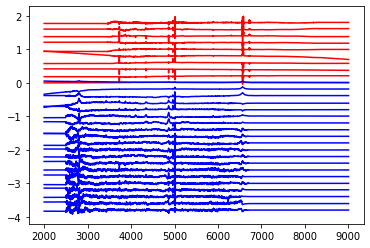

In [7]:
wvl_array_pre = []
lambda_keep = 2000.0

while (lambda_keep < 9003.0):
    incr = lambda_keep/(3.0e5/50.0) # pixel size corresponds to 10 km/s in rest frame
    wvl_array_pre.append(lambda_keep)
    lambda_keep += incr
    
wvl_array = np.array(wvl_array_pre)

subdir = 'pca/'
eigen_dir  = 'eigenspectra/'

gal_eigen_subdir = 'galaxy_eigenspectra/galaxyKL_eigSpec.ascii/'
agn_eigen_subdir = 'agn_eigenspectra/mizbinned/CZBIN1/'

gal_base_name = 'galaxyKL_eigSpec_'
agn_base_name = 'eigSpec_qso_'

gal_ord = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10']
agn_ord = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19']

lambda_gal, f_gal0 = np.loadtxt(eigen_dir + gal_eigen_subdir + gal_base_name + gal_ord[0] + '.dat', unpack=True, usecols = (0,1))  
lambda_agn, f_agn0 = np.loadtxt(eigen_dir + agn_eigen_subdir + agn_base_name + agn_ord[0] + '.dat', unpack=True, usecols = (0,1))  

gal_eigenvector = np.zeros((len(gal_ord), len(wvl_array)))
agn_eigenvector = np.zeros((len(agn_ord), len(wvl_array)))

for gcount in range(0,len(gal_ord)):
    gal_input_wvl, gal_input_vector = np.loadtxt(eigen_dir + gal_eigen_subdir + gal_base_name + gal_ord[gcount] + '.dat', unpack=True, usecols = (0,1))
    gal_input_vector_new = np.interp(wvl_array, gal_input_wvl, gal_input_vector)
    gal_eigenvector[gcount,:] = gal_input_vector_new
    plt.plot(wvl_array, gal_input_vector_new + 0.2*gcount, 'r-')
    
for acount in range(0,len(agn_ord)):
    agn_input_wvl, agn_input_vector = np.loadtxt(eigen_dir + agn_eigen_subdir + agn_base_name + agn_ord[acount] + '.dat', unpack=True, usecols = (0,1))
    agn_input_vector_new = np.interp(wvl_array, agn_input_wvl, agn_input_vector)
    agn_eigenvector[acount,:] = agn_input_vector_new
    plt.plot(wvl_array, agn_input_vector_new - 0.2*acount, 'b-')

delta_lambda_agn = np.zeros(len(lambda_agn))
for el in range(0,len(lambda_agn)-1):
    delta_lambda_agn[el] = lambda_agn[el+1] - lambda_agn[el]

delta_lambda_gal = np.zeros(len(lambda_gal))
for le in range(0,len(lambda_gal)-1):
    delta_lambda_gal[le] = lambda_gal[le+1] - lambda_gal[le]

avg_delta_lambda_agn = np.average(delta_lambda_agn)
avg_delta_lambda_gal = np.average(delta_lambda_gal)


def retrieve_fit_spec(a1,a2,a3,a4,a5,a6,a7,a8,a9,a10,g1,g2,g3,g4,g5, wvlarray, wvlobs):
    y_agn = a1*agn_eigenvector[0,:] + a2*agn_eigenvector[1,:] + a3*agn_eigenvector[2,:] + a4*agn_eigenvector[3,:] + \
        a5*agn_eigenvector[4,:] + a6*agn_eigenvector[5,:] + a7*agn_eigenvector[6,:] + a8*agn_eigenvector[7,:] +\
        a9*agn_eigenvector[8,:] + a10*agn_eigenvector[9,:]
    y_gal = g1*gal_eigenvector[0,:] + g2*gal_eigenvector[1,:] + g3*gal_eigenvector[2,:] + g4*gal_eigenvector[3,:] + g5*gal_eigenvector[4,:] 
    
    y_agn_obs = np.interp(wvlobs, wvlarray, y_agn)
    y_gal_obs = np.interp(wvlobs, wvlarray, y_gal)
    y_total_obs = y_agn_obs + y_gal_obs

    return y_total_obs, y_agn_obs, y_gal_obs


In [8]:
#plt.scatter(snrmed_pca[np.where(hfrac_i>0.0)],hfrac_i[np.where(hfrac_i>0.0)],s=0.1)
choose_element = 2
get_high_hfrac = np.where((snrmed_pca > 7.0) & (snrmed_pca < 9.0) & (hfrac_r > 0.80) & (hfrac_r < 1.0))[0][9]
get_mid_hfrac  = np.where((snrmed_pca > 7.0) & (snrmed_pca < 9.0) & (hfrac_r > 0.49) & (hfrac_r < 0.51))[0][5]
get_low_hfrac  = np.where((snrmed_pca > 7.0) & (snrmed_pca < 9.0) & (hfrac_r > 0.05) & (hfrac_r < 0.15))[0][3]
print(get_high_hfrac, get_low_hfrac, get_mid_hfrac)


5418 70 2007


In [9]:
spec_sample_high = SDSS.get_spectra(plate = plate1[get_high_hfrac], mjd = mjd_plate1[get_high_hfrac], fiberID = fiberid1[get_high_hfrac], timeout=120)
spec_sample_low  = SDSS.get_spectra(plate = plate1[get_low_hfrac], mjd = mjd_plate1[get_low_hfrac], fiberID = fiberid1[get_low_hfrac], timeout=120)
spec_sample_mid  = SDSS.get_spectra(plate = plate1[get_mid_hfrac], mjd = mjd_plate1[get_mid_hfrac], fiberID = fiberid1[get_mid_hfrac], timeout=120)


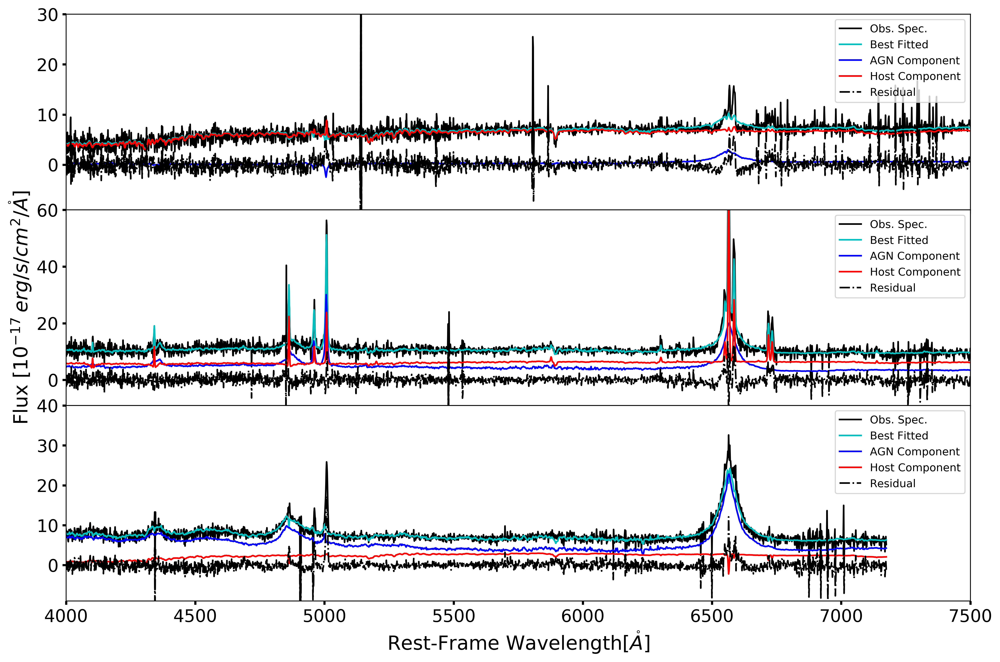

In [10]:
wvl_sample_high  = 10.0**(spec_sample_high[0][1].data['loglam'])
flux_sample_high = spec_sample_high[0][1].data['flux']
redshift_sample_high = redshift1[get_high_hfrac]

wvl_sample_low  = 10.0**(spec_sample_low[0][1].data['loglam'])
flux_sample_low = spec_sample_low[0][1].data['flux']
redshift_sample_low = redshift1[get_low_hfrac]

wvl_sample_mid  = 10.0**(spec_sample_mid[0][1].data['loglam'])
flux_sample_mid = spec_sample_mid[0][1].data['flux']
redshift_sample_mid = redshift1[get_mid_hfrac]



fs_high_total, fs_high_agn, fs_high_gal = retrieve_fit_spec(ao1[get_high_hfrac],ao2[get_high_hfrac],ao3[get_high_hfrac],ao4[get_high_hfrac],ao5[get_high_hfrac],
                  ao6[get_high_hfrac],ao7[get_high_hfrac],ao8[get_high_hfrac],ao9[get_high_hfrac],ao10[get_high_hfrac],
                  ao11[get_high_hfrac],ao12[get_high_hfrac],ao13[get_high_hfrac],ao14[get_high_hfrac],ao15[get_high_hfrac],
                  wvl_array, wvl_sample_high/(1.0+redshift_sample_high))

fs_low_total, fs_low_agn, fs_low_gal = retrieve_fit_spec(ao1[get_low_hfrac],ao2[get_low_hfrac],ao3[get_low_hfrac],ao4[get_low_hfrac],ao5[get_low_hfrac],
                  ao6[get_low_hfrac],ao7[get_low_hfrac],ao8[get_low_hfrac],ao9[get_low_hfrac],ao10[get_low_hfrac],
                  ao11[get_low_hfrac],ao12[get_low_hfrac],ao13[get_low_hfrac],ao14[get_low_hfrac],ao15[get_low_hfrac],
                  wvl_array, wvl_sample_low/(1.0+redshift_sample_low))

fs_mid_total, fs_mid_agn, fs_mid_gal = retrieve_fit_spec(ao1[get_mid_hfrac],ao2[get_mid_hfrac],ao3[get_mid_hfrac],ao4[get_mid_hfrac],ao5[get_mid_hfrac],
                  ao6[get_mid_hfrac],ao7[get_mid_hfrac],ao8[get_mid_hfrac],ao9[get_mid_hfrac],ao10[get_mid_hfrac],
                  ao11[get_mid_hfrac],ao12[get_mid_hfrac],ao13[get_mid_hfrac],ao14[get_mid_hfrac],ao15[get_mid_hfrac],
                  wvl_array, wvl_sample_mid/(1.0+redshift_sample_mid))

#plt.plot(wvl_sample_low/(1.0+redshift_sample_low), flux_sample_low)
#plt.plot(wvl_sample_mid/(1.0+redshift_sample_mid), flux_sample_mid)

fig, ax = plt.subplots(3, 1, figsize=(15,10),dpi=400, sharex='col', gridspec_kw={'hspace': 0.0, 'wspace': 0.15})
ax[0].plot(wvl_sample_high/(1.0+redshift_sample_high), flux_sample_high, 'k-', label='Obs. Spec.')
ax[0].plot(wvl_sample_high/(1.0+redshift_sample_high), fs_high_total, 'c-', label='Best Fitted')
ax[0].plot(wvl_sample_high/(1.0+redshift_sample_high), fs_high_agn, 'b-', label='AGN Component')
ax[0].plot(wvl_sample_high/(1.0+redshift_sample_high), fs_high_gal, 'r-', label='Host Component')
ax[0].plot(wvl_sample_high/(1.0+redshift_sample_high), flux_sample_high - fs_high_total, 'k-.', label='Residual')
ax[0].legend(loc=1)
#ax[0].set_ylabel(r'Flux [$10^{-17}\:erg/s/cm^2/\mathring{A}$]', fontsize=16)
ax[0].yaxis.set_tick_params(labelsize=16, width=2)
ax[0].set_xlim([4000,7500])
ax[0].set_ylim([-9.0,30.0])

ax[1].plot(wvl_sample_mid/(1.0+redshift_sample_mid), flux_sample_mid, 'k-', label='Obs. Spec.')
ax[1].plot(wvl_sample_mid/(1.0+redshift_sample_mid), fs_mid_total, 'c-', label='Best Fitted')
ax[1].plot(wvl_sample_mid/(1.0+redshift_sample_mid), fs_mid_agn, 'b-', label='AGN Component')
ax[1].plot(wvl_sample_mid/(1.0+redshift_sample_mid), fs_mid_gal, 'r-', label='Host Component')
ax[1].plot(wvl_sample_mid/(1.0+redshift_sample_mid), flux_sample_mid - fs_mid_total, 'k-.', label='Residual')
ax[1].legend(loc=1)
ax[1].set_ylabel(r'Flux [$10^{-17}\:erg/s/cm^2/\mathring{A}$]', fontsize=18)
ax[1].yaxis.set_tick_params(labelsize=16, width=2)
ax[1].set_xlim([4000,7500])
ax[1].set_ylim([-9.0,60.0])

ax[2].plot(wvl_sample_low/(1.0+redshift_sample_low), flux_sample_low, 'k-', label='Obs. Spec.')
ax[2].plot(wvl_sample_low/(1.0+redshift_sample_low), fs_low_total, 'c-', label='Best Fitted')
ax[2].plot(wvl_sample_low/(1.0+redshift_sample_low), fs_low_agn, 'b-', label='AGN Component')
ax[2].plot(wvl_sample_low/(1.0+redshift_sample_low), fs_low_gal, 'r-', label='Host Component')
ax[2].plot(wvl_sample_low/(1.0+redshift_sample_low), flux_sample_low - fs_low_total, 'k-.', label='Residual')
ax[2].set_xlabel(r'Rest-Frame Wavelength[$\mathring{A}$]', fontsize=18)
ax[2].legend(loc=1)
ax[2].yaxis.set_tick_params(labelsize=16, width=2)
ax[2].xaxis.set_tick_params(labelsize=16, width=2)
ax[2].set_xlim([4000,7500])
ax[2].set_ylim([-9.0,40.0])
plt.show()
fig.savefig('PCA_Fitting_Sample_v7.png')    




In [11]:
fiber2flux_u_agn1 = np.zeros(len(objid1))
fiber2flux_g_agn1 = np.zeros(len(objid1))
fiber2flux_r_agn1 = np.zeros(len(objid1))
fiber2flux_i_agn1 = np.zeros(len(objid1))
fiber2flux_z_agn1 = np.zeros(len(objid1))

for j in range(0,len(objid_qso_dr17)):
    for k in range(0,len(objid1)):
        if (objid_qso_dr17[j] == objid1[k]):
            fiber2flux_u_agn1[k] = fiber2flux_u_qso_dr17[j]
            fiber2flux_g_agn1[k] = fiber2flux_g_qso_dr17[j]
            fiber2flux_r_agn1[k] = fiber2flux_r_qso_dr17[j]
            fiber2flux_i_agn1[k] = fiber2flux_i_qso_dr17[j]
            fiber2flux_z_agn1[k] = fiber2flux_z_qso_dr17[j]
            break
        else:
            continue
        

10666
10666


(array([2.997e+03, 3.945e+03, 1.751e+03, 7.430e+02, 4.080e+02, 2.430e+02,
        1.320e+02, 1.010e+02, 7.400e+01, 4.500e+01, 2.900e+01, 2.400e+01,
        2.300e+01, 2.000e+01, 1.700e+01, 1.000e+01, 2.100e+01, 1.400e+01,
        9.000e+00, 5.000e+00, 1.000e+01, 1.000e+00, 2.000e+00, 4.000e+00,
        5.000e+00, 4.000e+00, 3.000e+00, 0.000e+00, 2.000e+00, 1.000e+00,
        0.000e+00, 1.000e+00, 2.000e+00, 1.000e+00, 1.000e+00, 2.000e+00,
        1.000e+00, 2.000e+00, 2.000e+00, 2.000e+00, 0.000e+00, 1.000e+00,
        1.000e+00, 0.000e+00, 1.000e+00, 0.000e+00, 1.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 2.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+0

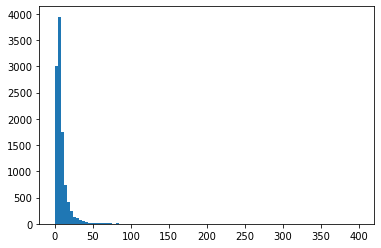

In [12]:
print(len(fiber2flux_u_agn1))
print(len(objid1))
plt.hist(fiber2flux_u_agn1, bins=100)

In [13]:

set_number = 'set2'
set_num = 2

objid2, ra2, dec2, umag2, err_u2, gmag2, err_g2, rmag2, err_r2, imag2, err_i2, zmag2, err_z2, plate2, fiberid2,\
    redshift2, snMedian2, snMedian_u2, snMedian_g2, snMedian_r2, snMedian_i2, snMedian_z2, \
    mjd_plate2, mjd_phot2, mjd_u2, mjd_g2, mjd_r2, mjd_i2, mjd_z2, \
    fiberMag_u2, fiberMagErr_u2, fiberMag_g2, fiberMagErr_g2, fiberMag_r2, fiberMagErr_r2, fiberMag_i2, fiberMagErr_i2, fiberMag_z2, \
    fiberMagErr_z2, fiberFlux_u2, fiberFluxIvar_u2, fiberFlux_g2, fiberFluxIvar_g2, fiberFlux_r2, fiberFluxIvar_r2, fiberFlux_i2, fiberFluxIvar_i2, fiberFlux_z2, fiberFluxIvar_z2, \
    spectroFlux_u2, spectroFluxIvar_u2, spectroFlux_g2, spectroFluxIvar_g2, spectroFlux_r2, spectroFluxIvar_r2, spectroFlux_i2, spectroFluxIvar_i2, spectroFlux_z2, spectroFluxIvar_z2, \
    an12, an22, an32, an42, an52, an62, an72, an82, an92, an102, gn12, gn22, gn32, gn42, gn52, \
    kcorr_u2, kcorr_g2 , kcorr_r2, kcorr_i2, kcorr_z2, absmag_u2, absmag_g2, absmag_r2, absmag_i2, absmag_z2, extc_u2, extc_g2, extc_r2, extc_i2, extc_z2, \
    sigma_ha2, sigma_ha_err2, sigma_hb2, sigma_hb_err2, sigma_best2, sigma_best_err2, sigma_ha_archive2, sigma_ha_archive_err2, sigma_hb_archive2, sigma_hb_archive_err2, \
    peak_ha2, peak_ha_err2, peak_hb2, peak_hb_err2, line_flux_ha2, line_flux_ha_err2, line_flux_hb2, line_flux_hb_err2, fwhm_kms2, fwhm_kms_err2, \
    z_fit_ha2, z_fit_hb2, z_fit_best2, z_agn2, z_agn_err2, line_flux_ha_archive2, line_flux_ha_archive_err2, line_flux_hb_archive2, line_flux_hb_archive_err2, \
    kcor_krc_g2, kcor_krc_r2, kcor_krc_i2, g_abs2, r_abs2, i_abs2, mag_abs_agn_i2, \
    delta_mag_agn_corrected_g2, delta_mag_agn_corrected_r2, delta_mag_agn_corrected_i2, sigma_phot_g2, sigma_phot_r2, sigma_phot_i2, \
    lambdaL5100_agn2, Luminosity_B_AGN2, Luminosity_B_AGN_PSP2, absmag_B_AGN2, absmag_B_AGN_PSP2, M_BH_51002, host_fraction_g_new2, host_fraction_r_new2, host_fraction_i_new2, \
    psi_deviation_g2, psi_deviation_r2, psi_deviation_i2 = np.loadtxt('tables/AGN_fitted_de-offset_data_' + set_number + '_v6_with_LB_MassBH_Psi_Uncertainty.dat', comments='#', unpack=True)

8839
8839


(array([7.990e+02, 5.884e+03, 1.226e+03, 3.240e+02, 1.550e+02, 1.180e+02,
        6.400e+01, 4.100e+01, 3.000e+01, 2.900e+01, 1.900e+01, 1.700e+01,
        1.400e+01, 1.500e+01, 1.300e+01, 1.200e+01, 9.000e+00, 5.000e+00,
        5.000e+00, 6.000e+00, 4.000e+00, 6.000e+00, 5.000e+00, 4.000e+00,
        2.000e+00, 3.000e+00, 1.000e+00, 2.000e+00, 1.000e+00, 4.000e+00,
        0.000e+00, 5.000e+00, 3.000e+00, 0.000e+00, 0.000e+00, 1.000e+00,
        0.000e+00, 0.000e+00, 1.000e+00, 2.000e+00, 1.000e+00, 0.000e+00,
        1.000e+00, 3.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+0

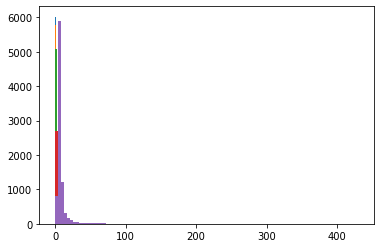

In [14]:
fiber2flux_u_agn2 = np.zeros(len(objid2))
fiber2flux_g_agn2 = np.zeros(len(objid2))
fiber2flux_r_agn2 = np.zeros(len(objid2))
fiber2flux_i_agn2 = np.zeros(len(objid2))
fiber2flux_z_agn2 = np.zeros(len(objid2))

for j in range(0,len(objid_qso_dr17)):
    for k in range(0,len(objid2)):
        if (objid_qso_dr17[j] == objid2[k]):
            fiber2flux_u_agn2[k] = fiber2flux_u_qso_dr17[j]
            fiber2flux_g_agn2[k] = fiber2flux_g_qso_dr17[j]
            fiber2flux_r_agn2[k] = fiber2flux_r_qso_dr17[j]
            fiber2flux_i_agn2[k] = fiber2flux_i_qso_dr17[j]
            fiber2flux_z_agn2[k] = fiber2flux_z_qso_dr17[j]
            break
        else:
            continue

print(len(fiber2flux_u_agn2))
print(len(objid2))
plt.hist(fiber2flux_u_agn2, bins=100)
plt.hist(fiber2flux_g_agn2, bins=100)
plt.hist(fiber2flux_r_agn2, bins=100)
plt.hist(fiber2flux_i_agn2, bins=100)
plt.hist(fiber2flux_z_agn2, bins=100)

In [15]:
print(len(fiberFlux_g2))
print(len(fiberFlux_g2[np.where(fiberFlux_g2 > 0.0)]))

8839
8837


In [16]:
objid_gal, ra_gal, dec_gal, u_gal, err_u_gal, g_gal, err_g_gal, r_gal, err_r_gal, i_gal, err_i_gal, z_gal, err_z_gal, \
    plate_gal, fiberID_gal, redshift_gal, snMedian_gal, snMedian_u_gal, snMedian_g_gal, snMedian_r_gal, snMedian_i_gal, snMedian_z_gal, \
    mjd_spec_gal, mjd_phot_gal, mjd_u_gal, mjd_g_gal, mjd_r_gal, mjd_i_gal, mjd_z_gal, type_gal, class_gal, \
    fiberMag_u_gal, fiberMagErr_u_gal, fiberMag_g_gal, fiberMagErr_g_gal, fiberMag_r_gal, fiberMagErr_r_gal, fiberMag_i_gal, fiberMagErr_i_gal, fiberMag_z_gal, fiberMagErr_z_gal, \
    fiberFlux_u_gal, fiberFluxIvar_u_gal, fiberFlux_g_gal, fiberFluxIvar_g_gal, fiberFlux_r_gal, fiberFluxIvar_r_gal, fiberFlux_i_gal, fiberFluxIvar_i_gal, fiberFlux_z_gal, fiberFluxIvar_z_gal, \
    spectroFlux_u_gal, spectroFluxIvar_u_gal, spectroFlux_g_gal, spectroFluxIvar_g_gal, spectroFlux_r_gal, spectroFluxIvar_r_gal, spectroFlux_i_gal, spectroFluxIvar_i_gal, spectroFlux_z_gal, spectroFluxIvar_z_gal,\
    kcorrU_gal, kcorrG_gal, kcorrR_gal, kcorrI_gal, kcorrZ_gal, absMagU_gal, absMagG_gal, absMagR_gal, absMagI_gal, absMagZ_gal, fiber2fluxgal_u, fiber2fluxgal_g, fiber2fluxgal_r, fiber2fluxgal_i, fiber2fluxgal_z \
    =  np.loadtxt('tables/table_dr17_galaxy_abs_all_krc213.dat', comments='#', delimiter=',', unpack=True)
    

In [17]:
good_gal1 = np.where((mjd_spec_gal <= 55000) & (fiberFlux_g_gal > 0.0) & (fiberFlux_r_gal > 0.0) & (fiberFlux_i_gal > 0.0)
                    & (spectroFlux_g_gal >= 0.0) & (spectroFlux_r_gal >= 0.0) & (spectroFlux_i_gal >= 0.0))

good_gal2 = np.where((mjd_spec_gal > 55000) & (fiber2fluxgal_g > 0.0) & (fiber2fluxgal_r > 0.0) & (fiber2fluxgal_i > 0.0)
                    & (spectroFlux_g_gal >= 0.0) & (spectroFlux_r_gal >= 0.0) & (spectroFlux_i_gal >= 0.0))

print(len(good_gal1[0]),len(good_gal2[0]))

851308 1591065


In [18]:

snMedian_g1_gal     = snMedian_g_gal[good_gal1]
snMedian_r1_gal     = snMedian_r_gal[good_gal1]
snMedian_i1_gal     = snMedian_i_gal[good_gal1]
fiberFlux_g1_gal    = fiberFlux_g_gal[good_gal1]
fiberFlux_r1_gal    = fiberFlux_r_gal[good_gal1]
fiberFlux_i1_gal    = fiberFlux_i_gal[good_gal1]
spectroFlux_g1_gal    = spectroFlux_g_gal[good_gal1]
spectroFlux_r1_gal    = spectroFlux_r_gal[good_gal1]
spectroFlux_i1_gal    = spectroFlux_i_gal[good_gal1]
fiber2flux_g1_gal = fiber2fluxgal_g[good_gal1]
fiber2flux_r1_gal = fiber2fluxgal_r[good_gal1]
fiber2flux_i1_gal = fiber2fluxgal_i[good_gal1]

snMedian_g2_gal     = snMedian_g_gal[good_gal2]
snMedian_r2_gal     = snMedian_r_gal[good_gal2]
snMedian_i2_gal     = snMedian_i_gal[good_gal2]
fiberFlux_g2_gal    = fiberFlux_g_gal[good_gal2]
fiberFlux_r2_gal    = fiberFlux_r_gal[good_gal2]
fiberFlux_i2_gal    = fiberFlux_i_gal[good_gal2]
spectroFlux_g2_gal    = spectroFlux_g_gal[good_gal2]
spectroFlux_r2_gal    = spectroFlux_r_gal[good_gal2]
spectroFlux_i2_gal    = spectroFlux_i_gal[good_gal2]
fiber2flux_g2_gal = fiber2fluxgal_g[good_gal2]
fiber2flux_r2_gal = fiber2fluxgal_r[good_gal2]
fiber2flux_i2_gal = fiber2fluxgal_i[good_gal2]


mag_diff_gal_g1 = -2.5*np.log10(spectroFlux_g1_gal/fiberFlux_g1_gal) # fiberMag_g2 - gmag2   fiber size = 3" for SDSS spectrograph
mag_diff_gal_r1 = -2.5*np.log10(spectroFlux_r1_gal/fiberFlux_r1_gal) # fiberMag_g2 - gmag2
mag_diff_gal_i1 = -2.5*np.log10(spectroFlux_i1_gal/fiberFlux_i1_gal) # fiberMag_g2 - gmag2

mag_diff_gal_g2 = -2.5*np.log10(spectroFlux_g2_gal/fiber2flux_g2_gal) # fiber2"Mag_g2 - gmag2  fiber size = 2" for BOSS spectrograph
mag_diff_gal_r2 = -2.5*np.log10(spectroFlux_r2_gal/fiber2flux_r2_gal) # fiber2"Mag_g2 - gmag2
mag_diff_gal_i2 = -2.5*np.log10(spectroFlux_i2_gal/fiber2flux_i2_gal) # fiber2"Mag_g2 - gmag2


(array([1.590848e+06, 8.600000e+01, 4.100000e+01, 2.000000e+01,
        1.100000e+01, 1.900000e+01, 4.000000e+00, 5.000000e+00,
        4.000000e+00, 3.000000e+00, 2.000000e+00, 3.000000e+00,
        1.000000e+00, 1.000000e+00, 1.000000e+00, 2.000000e+00,
        0.000000e+00, 1.000000e+00, 1.000000e+00, 2.000000e+00,
        1.000000e+00, 1.000000e+00, 1.000000e+00, 1.000000e+00,
        0.000000e+00, 1.000000e+00, 0.000000e+00, 1.000000e+00,
        0.000000e+00, 0.000000e+00, 0.000000e+00, 0.000000e+00,
        0.000000e+00, 0.000000e+00, 0.000000e+00, 0.000000e+00,
        0.000000e+00, 0.000000e+00, 0.000000e+00, 0.000000e+00,
        0.000000e+00, 0.000000e+00, 0.000000e+00, 0.000000e+00,
        0.000000e+00, 0.000000e+00, 0.000000e+00, 0.000000e+00,
        0.000000e+00, 0.000000e+00, 1.000000e+00, 0.000000e+00,
        0.000000e+00, 0.000000e+00, 0.000000e+00, 0.000000e+00,
        0.000000e+00, 0.000000e+00, 0.000000e+00, 0.000000e+00,
        0.000000e+00, 0.000000e+00, 0.00

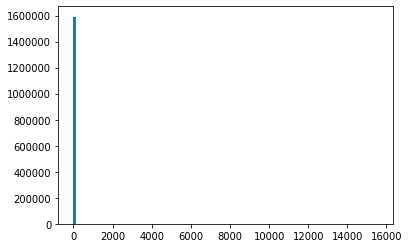

In [19]:
plt.hist(spectroFlux_g2_gal/fiber2flux_g2_gal, bins=100)

(array([1.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        1.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 2.00000e+00, 0.00000e+00,
        1.00000e+00, 0.00000e+00, 0.00000e+00, 1.00000e+00, 0.00000e+00,
        1.00000e+00, 2.00000e+00, 1.00000e+00, 2.00000e+00, 2.00000e+00,
        5.00000e+00, 2.00000e+00, 7.00000e+00, 6.00000e+00, 5.00000e+00,
        2.10000e+01, 2.60000e+01, 4.30000e+01, 9.50000e+01, 2.31000e+02,
        4.78000e+02, 1.05600e+03, 2.41300e+03, 5.85700e+03, 1.81060e+04,
        7.50450e+04, 3.12187e+05, 6.40507e+05, 3.87926e+05, 1.02622e+05,
        2.57720e+04, 7.79100e+03, 3.57100e+03, 2.53100e+03, 1.81300e+03,
        1.20400e+03, 7.68000e+02, 4.34000e+02, 2.16000e+02, 1.20000e+02,
        5.60000e+01, 4.70000e+01, 3.40000e+01, 1.80000e+01, 1.20000e+01,
        6.00000e+00, 3.00000e+00, 6.00000e+00, 2.00

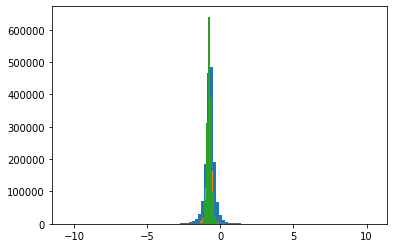

In [20]:
plt.hist(mag_diff_gal_g2, bins=100)
plt.hist(mag_diff_gal_r2, bins=100)
plt.hist(mag_diff_gal_i2, bins=100)

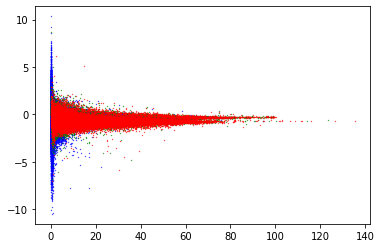

In [21]:

plt.scatter(snMedian_g1_gal, mag_diff_gal_g1, s=0.1, color='blue')
plt.scatter(snMedian_r1_gal, mag_diff_gal_r1, s=0.1, color='green')
plt.scatter(snMedian_i1_gal, mag_diff_gal_i1, s=0.1, color='red')

plt.scatter(snMedian_g2_gal, mag_diff_gal_g2, s=0.1, color='blue')
plt.scatter(snMedian_r2_gal, mag_diff_gal_r2, s=0.1, color='green')
plt.scatter(snMedian_i2_gal, mag_diff_gal_i2, s=0.1, color='red')


In [22]:
bin_num = 16 #int((bin_stop_snr - bin_start_snr)/bin_size)

mag_diff_gal_g1_mean = np.zeros(bin_num)
mag_diff_gal_r1_mean = np.zeros(bin_num)
mag_diff_gal_i1_mean = np.zeros(bin_num)

mag_diff_gal_g1_median = np.zeros(bin_num)
mag_diff_gal_r1_median = np.zeros(bin_num)
mag_diff_gal_i1_median = np.zeros(bin_num)

mag_diff_gal_g1_std = np.zeros(bin_num)
mag_diff_gal_r1_std = np.zeros(bin_num)
mag_diff_gal_i1_std = np.zeros(bin_num)

snr_gal_g1_bin = np.zeros(bin_num)
snr_gal_r1_bin = np.zeros(bin_num)
snr_gal_i1_bin = np.zeros(bin_num)


snMedian_gal_g1_cut_sorted = np.sort(snMedian_g1_gal)[int(np.floor(0.005*len(snMedian_g1_gal))):int(np.floor(0.995*len(snMedian_g1_gal)))]
snMedian_gal_r1_cut_sorted = np.sort(snMedian_r1_gal)[int(np.floor(0.005*len(snMedian_r1_gal))):int(np.floor(0.995*len(snMedian_r1_gal)))]
snMedian_gal_i1_cut_sorted = np.sort(snMedian_i1_gal)[int(np.floor(0.005*len(snMedian_i1_gal))):int(np.floor(0.995*len(snMedian_i1_gal)))]

good_gal_sort_g1 = np.where((snMedian_gal_g1_cut_sorted < snMedian_gal_g1_cut_sorted[-1]) & (snMedian_gal_g1_cut_sorted >= snMedian_gal_g1_cut_sorted[0]))
good_gal_sort_r1 = np.where((snMedian_gal_r1_cut_sorted < snMedian_gal_r1_cut_sorted[-1]) & (snMedian_gal_r1_cut_sorted >= snMedian_gal_r1_cut_sorted[0]))
good_gal_sort_i1 = np.where((snMedian_gal_i1_cut_sorted < snMedian_gal_i1_cut_sorted[-1]) & (snMedian_gal_i1_cut_sorted >= snMedian_gal_i1_cut_sorted[0]))

int_gal_step_g1 = list(np.arange(0,bin_num + 1)*int(np.floor(len(snMedian_gal_g1_cut_sorted[good_gal_sort_g1])/bin_num)))
int_gal_step_r1 = list(np.arange(0,bin_num + 1)*int(np.floor(len(snMedian_gal_r1_cut_sorted[good_gal_sort_r1])/bin_num)))
int_gal_step_i1 = list(np.arange(0,bin_num + 1)*int(np.floor(len(snMedian_gal_i1_cut_sorted[good_gal_sort_i1])/bin_num)))

bin_gal_step_sn_g1 = snMedian_gal_g1_cut_sorted[good_gal_sort_g1][int_gal_step_g1]
bin_gal_step_sn_r1 = snMedian_gal_r1_cut_sorted[good_gal_sort_r1][int_gal_step_r1]
bin_gal_step_sn_i1 = snMedian_gal_i1_cut_sorted[good_gal_sort_i1][int_gal_step_i1]


In [23]:

for k in range(0,bin_num):
    good_gal_range_g1 = np.where((snMedian_g1_gal >= bin_gal_step_sn_g1[k]) & (snMedian_g1_gal < bin_gal_step_sn_g1[k + 1]))
    good_gal_range_r1 = np.where((snMedian_r1_gal >= bin_gal_step_sn_r1[k]) & (snMedian_r1_gal < bin_gal_step_sn_r1[k + 1]))
    good_gal_range_i1 = np.where((snMedian_i1_gal >= bin_gal_step_sn_i1[k]) & (snMedian_i1_gal < bin_gal_step_sn_i1[k + 1]))

    mag_diff_gal_g1_mean[k], mag_diff_gal_g1_median[k], mag_diff_gal_g1_std[k] = \
        sigma_clipped_stats(mag_diff_gal_g1[good_gal_range_g1], sigma=2.0, maxiters=5, cenfunc='median')

    mag_diff_gal_r1_mean[k], mag_diff_gal_r1_median[k], mag_diff_gal_r1_std[k] = \
        sigma_clipped_stats(mag_diff_gal_r1[good_gal_range_r1], sigma=2.0, maxiters=5, cenfunc='median')

    mag_diff_gal_i1_mean[k], mag_diff_gal_i1_median[k], mag_diff_gal_i1_std[k] = \
        sigma_clipped_stats(mag_diff_gal_i1[good_gal_range_i1], sigma=2.0, maxiters=5, cenfunc='median')

    snr_gal_g1_bin[k]       =  np.median(snMedian_g1_gal[good_gal_range_g1])
    snr_gal_r1_bin[k]       =  np.median(snMedian_r1_gal[good_gal_range_r1])
    snr_gal_i1_bin[k]       =  np.median(snMedian_i1_gal[good_gal_range_i1])


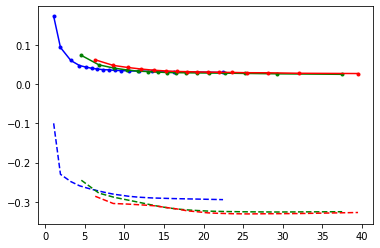

In [24]:

plt.plot(snr_gal_g1_bin, mag_diff_gal_g1_median, 'b--')
plt.plot(snr_gal_r1_bin, mag_diff_gal_r1_median, 'g--')
plt.plot(snr_gal_i1_bin, mag_diff_gal_i1_median, 'r--')
plt.plot(snr_gal_g1_bin, mag_diff_gal_g1_std, 'b.-')
plt.plot(snr_gal_r1_bin, mag_diff_gal_r1_std, 'g.-')
plt.plot(snr_gal_i1_bin, mag_diff_gal_i1_std, 'r.-')


In [25]:
popt_gal_g1, pcov_gal_g1 = curve_fit(trumpet_curve, snr_gal_g1_bin, mag_diff_gal_g1_median, sigma=1.0/(snr_gal_g1_bin**2.0), absolute_sigma=False, check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),
popt_gal_r1, pcov_gal_r1 = curve_fit(trumpet_curve, snr_gal_r1_bin, mag_diff_gal_r1_median, sigma=1.0/(snr_gal_r1_bin**2.0), absolute_sigma=False, check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),
popt_gal_i1, pcov_gal_i1 = curve_fit(trumpet_curve, snr_gal_i1_bin, mag_diff_gal_i1_median, sigma=1.0/(snr_gal_i1_bin**2.0), absolute_sigma=False, check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),

popt_gal_g1_std, pcov_gal_g1_std = curve_fit(trumpet_curve, snr_gal_g1_bin, mag_diff_gal_g1_std, sigma=1.0/(snr_gal_g1_bin**2.0), absolute_sigma=False, check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),
popt_gal_r1_std, pcov_gal_r1_std = curve_fit(trumpet_curve, snr_gal_r1_bin, mag_diff_gal_r1_std, sigma=1.0/(snr_gal_r1_bin**2.0), absolute_sigma=False, check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),
popt_gal_i1_std, pcov_gal_i1_std = curve_fit(trumpet_curve, snr_gal_i1_bin, mag_diff_gal_i1_std, sigma=1.0/(snr_gal_i1_bin**2.0), absolute_sigma=False, check_finite=True, method='trf')

In [26]:


snr_fit = np.linspace(0.01,100,250)
mag_diff_gal_g1_fit = trumpet_curve(snr_fit, popt_gal_g1[0], popt_gal_g1[1], popt_gal_g1[2], popt_gal_g1[3])
mag_diff_gal_r1_fit = trumpet_curve(snr_fit, popt_gal_r1[0], popt_gal_r1[1], popt_gal_r1[2], popt_gal_r1[3])
mag_diff_gal_i1_fit = trumpet_curve(snr_fit, popt_gal_i1[0], popt_gal_i1[1], popt_gal_i1[2], popt_gal_i1[3])

mag_std_gal_g1_fit = trumpet_curve(snr_fit, popt_gal_g1_std[0], popt_gal_g1_std[1], popt_gal_g1_std[2], popt_gal_g1_std[3])
mag_std_gal_r1_fit = trumpet_curve(snr_fit, popt_gal_r1_std[0], popt_gal_r1_std[1], popt_gal_r1_std[2], popt_gal_r1_std[3])
mag_std_gal_i1_fit = trumpet_curve(snr_fit, popt_gal_i1_std[0], popt_gal_i1_std[1], popt_gal_i1_std[2], popt_gal_i1_std[3])



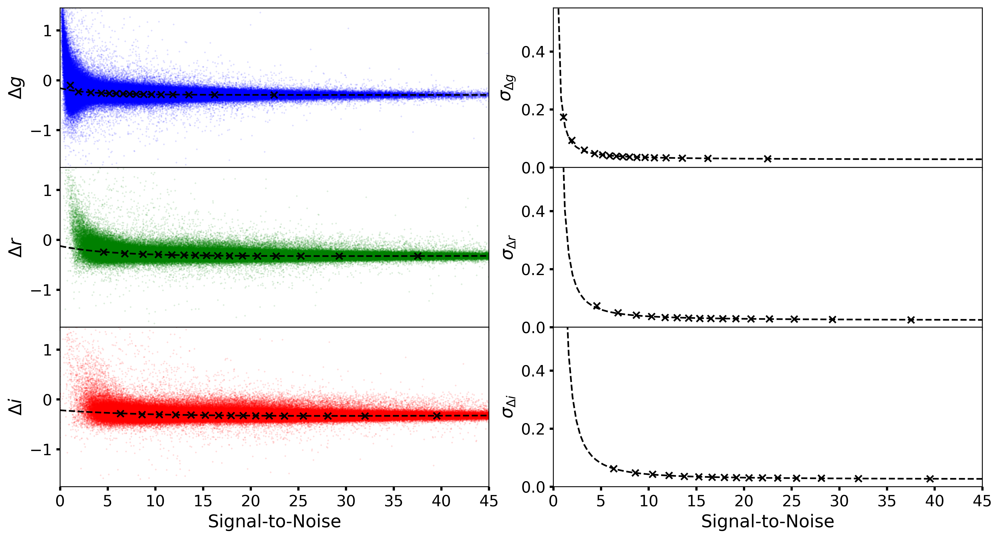

In [27]:

fig, ax = plt.subplots(3, 2, figsize=(15,8),dpi=400, sharex='col', gridspec_kw={'hspace': 0.0, 'wspace': 0.15})
ax[0,0].scatter(snMedian_g1_gal, mag_diff_gal_g1, c='blue' , s=0.005)
ax[0,0].scatter(snr_gal_g1_bin, mag_diff_gal_g1_median, color= 'black', marker='x')
ax[0,0].plot(snr_fit, mag_diff_gal_g1_fit, ls='--', c='black')
ax[0,0].set_ylabel(r'$\Delta g$', fontsize=16)
ax[0,0].yaxis.set_tick_params(labelsize=14, width=2)
ax[0,0].set_xlim([0,45])
ax[0,0].set_ylim([-1.75,1.45])

ax[1,0].scatter(snMedian_r1_gal, mag_diff_gal_r1, c='green' , s=0.005)
ax[1,0].scatter(snr_gal_r1_bin, mag_diff_gal_r1_median, color= 'black', marker='x')
ax[1,0].plot(snr_fit, mag_diff_gal_r1_fit, ls='--', c='black')
ax[1,0].set_ylabel(r'$\Delta r$', fontsize=16)
ax[1,0].yaxis.set_tick_params(labelsize=14, width=2)
ax[1,0].set_xlim([0,45])
ax[1,0].set_ylim([-1.75,1.45])

ax[2,0].scatter(snMedian_i1_gal, mag_diff_gal_i1, c='red' , s=0.005)
ax[2,0].scatter(snr_gal_i1_bin, mag_diff_gal_i1_median, color= 'black', marker='x')
ax[2,0].plot(snr_fit, mag_diff_gal_i1_fit, ls='--', c='black')
ax[2,0].set_xlabel('Signal-to-Noise', fontsize=16)
ax[2,0].set_ylabel(r'$\Delta i$', fontsize=16)
ax[2,0].yaxis.set_tick_params(labelsize=14, width=2)
ax[2,0].xaxis.set_tick_params(labelsize=14, width=2)
ax[2,0].set_xlim([0,45])
ax[2,0].set_ylim([-1.75,1.45])

ax[0,1].scatter(snr_gal_g1_bin, mag_diff_gal_g1_std, color= 'black', marker='x')
ax[0,1].plot(snr_fit, mag_std_gal_g1_fit, ls='--', c='black')
ax[0,1].set_ylabel(r'$\sigma_{\Delta g}$', fontsize=16)
ax[0,1].yaxis.set_tick_params(labelsize=14, width=2)
ax[0,1].set_xlim([0,45])
ax[0,1].set_ylim([0.0,0.55])

ax[1,1].scatter(snr_gal_r1_bin, mag_diff_gal_r1_std, color= 'black', marker='x')
ax[1,1].plot(snr_fit, mag_std_gal_r1_fit, ls='--', c='black')
ax[1,1].set_ylabel(r'$\sigma_{\Delta r}$', fontsize=16)
ax[1,1].yaxis.set_tick_params(labelsize=14, width=2)
ax[1,1].set_xlim([0,45])
ax[1,1].set_ylim([0.0,0.55])

ax[2,1].scatter(snr_gal_i1_bin, mag_diff_gal_i1_std, color= 'black', marker='x')
ax[2,1].plot(snr_fit, mag_std_gal_i1_fit, ls='--', c='black')
ax[2,1].set_ylabel(r'$\sigma_{\Delta i}$', fontsize=16)
ax[2,1].yaxis.set_tick_params(labelsize=14, width=2)
ax[2,1].set_xlabel('Signal-to-Noise', fontsize=16)
ax[2,1].xaxis.set_tick_params(labelsize=14, width=2)
ax[2,1].set_xlim([0,45])
ax[2,1].set_ylim([0.0,0.55])

plt.show()
fig.savefig('SNR_vs_mag_diff_Galaxies_set1.png')    

##########################################################
######################################################################################################################################################################################################################################


In [28]:
bin_num = 16 #int((bin_stop_snr - bin_start_snr)/bin_size)

mag_diff_gal_g2_mean = np.zeros(bin_num)
mag_diff_gal_r2_mean = np.zeros(bin_num)
mag_diff_gal_i2_mean = np.zeros(bin_num)

mag_diff_gal_g2_median = np.zeros(bin_num)
mag_diff_gal_r2_median = np.zeros(bin_num)
mag_diff_gal_i2_median = np.zeros(bin_num)

mag_diff_gal_g2_std = np.zeros(bin_num)
mag_diff_gal_r2_std = np.zeros(bin_num)
mag_diff_gal_i2_std = np.zeros(bin_num)

snr_gal_g2_bin = np.zeros(bin_num)
snr_gal_r2_bin = np.zeros(bin_num)
snr_gal_i2_bin = np.zeros(bin_num)

snMedian_gal_g2_cut_sorted = np.sort(snMedian_g2_gal)[int(np.floor(0.005*len(snMedian_g2_gal))):int(np.floor(0.995*len(snMedian_g2_gal)))]
snMedian_gal_r2_cut_sorted = np.sort(snMedian_r2_gal)[int(np.floor(0.005*len(snMedian_r2_gal))):int(np.floor(0.995*len(snMedian_r2_gal)))]
snMedian_gal_i2_cut_sorted = np.sort(snMedian_i2_gal)[int(np.floor(0.005*len(snMedian_i2_gal))):int(np.floor(0.995*len(snMedian_i2_gal)))]

good_gal_sort_g2 = np.where((snMedian_gal_g2_cut_sorted < snMedian_gal_g2_cut_sorted[-1]) & (snMedian_gal_g2_cut_sorted >= snMedian_gal_g2_cut_sorted[0]))
good_gal_sort_r2 = np.where((snMedian_gal_r2_cut_sorted < snMedian_gal_r2_cut_sorted[-1]) & (snMedian_gal_r2_cut_sorted >= snMedian_gal_r2_cut_sorted[0]))
good_gal_sort_i2 = np.where((snMedian_gal_i2_cut_sorted < snMedian_gal_i2_cut_sorted[-1]) & (snMedian_gal_i2_cut_sorted >= snMedian_gal_i2_cut_sorted[0]))

int_gal_step_g2 = list(np.arange(0,bin_num + 1)*int(np.floor(len(snMedian_gal_g2_cut_sorted[good_gal_sort_g2])/bin_num)))
int_gal_step_r2 = list(np.arange(0,bin_num + 1)*int(np.floor(len(snMedian_gal_r2_cut_sorted[good_gal_sort_r2])/bin_num)))
int_gal_step_i2 = list(np.arange(0,bin_num + 1)*int(np.floor(len(snMedian_gal_i2_cut_sorted[good_gal_sort_i2])/bin_num)))

bin_gal_step_sn_g2 = snMedian_gal_g2_cut_sorted[good_gal_sort_g2][int_gal_step_g2]
bin_gal_step_sn_r2 = snMedian_gal_r2_cut_sorted[good_gal_sort_r2][int_gal_step_r2]
bin_gal_step_sn_i2 = snMedian_gal_i2_cut_sorted[good_gal_sort_i2][int_gal_step_i2]


In [29]:

for k in range(0,bin_num):
    good_gal_range_g2 = np.where((snMedian_g2_gal >= bin_gal_step_sn_g2[k]) & (snMedian_g2_gal < bin_gal_step_sn_g2[k + 1]))
    good_gal_range_r2 = np.where((snMedian_r2_gal >= bin_gal_step_sn_r2[k]) & (snMedian_r2_gal < bin_gal_step_sn_r2[k + 1]))
    good_gal_range_i2 = np.where((snMedian_i2_gal >= bin_gal_step_sn_i2[k]) & (snMedian_i2_gal < bin_gal_step_sn_i2[k + 1]))

    mag_diff_gal_g2_mean[k], mag_diff_gal_g2_median[k], mag_diff_gal_g2_std[k] = \
        sigma_clipped_stats(mag_diff_gal_g2[good_gal_range_g2], sigma=2.0, maxiters=5, cenfunc='median')

    mag_diff_gal_r2_mean[k], mag_diff_gal_r2_median[k], mag_diff_gal_r2_std[k] = \
        sigma_clipped_stats(mag_diff_gal_r2[good_gal_range_r2], sigma=2.0, maxiters=5, cenfunc='median')

    mag_diff_gal_i2_mean[k], mag_diff_gal_i2_median[k], mag_diff_gal_i2_std[k] = \
        sigma_clipped_stats(mag_diff_gal_i2[good_gal_range_i2], sigma=2.0, maxiters=5, cenfunc='median')

    snr_gal_g2_bin[k]       =  np.median(snMedian_g2_gal[good_gal_range_g2])
    snr_gal_r2_bin[k]       =  np.median(snMedian_r2_gal[good_gal_range_r2])
    snr_gal_i2_bin[k]       =  np.median(snMedian_i2_gal[good_gal_range_i2])


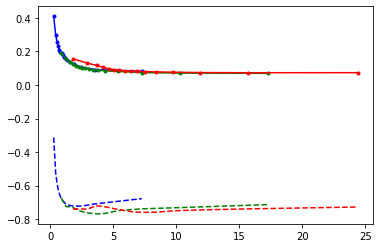

In [30]:

plt.plot(snr_gal_g2_bin, mag_diff_gal_g2_median, 'b--')
plt.plot(snr_gal_r2_bin, mag_diff_gal_r2_median, 'g--')
plt.plot(snr_gal_i2_bin, mag_diff_gal_i2_median, 'r--')
plt.plot(snr_gal_g2_bin, mag_diff_gal_g2_std, 'b.-')
plt.plot(snr_gal_r2_bin, mag_diff_gal_r2_std, 'g.-')
plt.plot(snr_gal_i2_bin, mag_diff_gal_i2_std, 'r.-')


In [31]:

popt_gal_g2, pcov_gal_g2 = curve_fit(trumpet_curve, snr_gal_g2_bin, mag_diff_gal_g2_median, sigma=1.0/(snr_gal_g2_bin**2.0), absolute_sigma=False, check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),
popt_gal_r2, pcov_gal_r2 = curve_fit(trumpet_curve, snr_gal_r2_bin, mag_diff_gal_r2_median, sigma=1.0/(snr_gal_r2_bin**2.0), absolute_sigma=False, check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),
popt_gal_i2, pcov_gal_i2 = curve_fit(trumpet_curve, snr_gal_i2_bin, mag_diff_gal_i2_median, sigma=1.0/(snr_gal_i2_bin**2.0), absolute_sigma=False, check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),

popt_gal_g2_std, pcov_gal_g2_std = curve_fit(trumpet_curve, snr_gal_g2_bin, mag_diff_gal_g2_std, sigma=1.0/(snr_gal_g2_bin**2.0), absolute_sigma=False, check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),
popt_gal_r2_std, pcov_gal_r2_std = curve_fit(trumpet_curve, snr_gal_r2_bin, mag_diff_gal_r2_std, sigma=1.0/(snr_gal_r2_bin**2.0), absolute_sigma=False, check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),
popt_gal_i2_std, pcov_gal_i2_std = curve_fit(trumpet_curve, snr_gal_i2_bin, mag_diff_gal_i2_std, sigma=1.0/(snr_gal_i2_bin**2.0), absolute_sigma=False, check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),

snr_fit = np.linspace(0.01,100,250)
mag_diff_gal_g2_fit = trumpet_curve(snr_fit, popt_gal_g2[0], popt_gal_g2[1], popt_gal_g2[2], popt_gal_g2[3])
mag_diff_gal_r2_fit = trumpet_curve(snr_fit, popt_gal_r2[0], popt_gal_r2[1], popt_gal_r2[2], popt_gal_r2[3])
mag_diff_gal_i2_fit = trumpet_curve(snr_fit, popt_gal_i2[0], popt_gal_i2[1], popt_gal_i2[2], popt_gal_i2[3])

mag_std_gal_g2_fit = trumpet_curve(snr_fit, popt_gal_g2_std[0], popt_gal_g2_std[1], popt_gal_g2_std[2], popt_gal_g2_std[3])
mag_std_gal_r2_fit = trumpet_curve(snr_fit, popt_gal_r2_std[0], popt_gal_r2_std[1], popt_gal_r2_std[2], popt_gal_r2_std[3])
mag_std_gal_i2_fit = trumpet_curve(snr_fit, popt_gal_i2_std[0], popt_gal_i2_std[1], popt_gal_i2_std[2], popt_gal_i2_std[3])


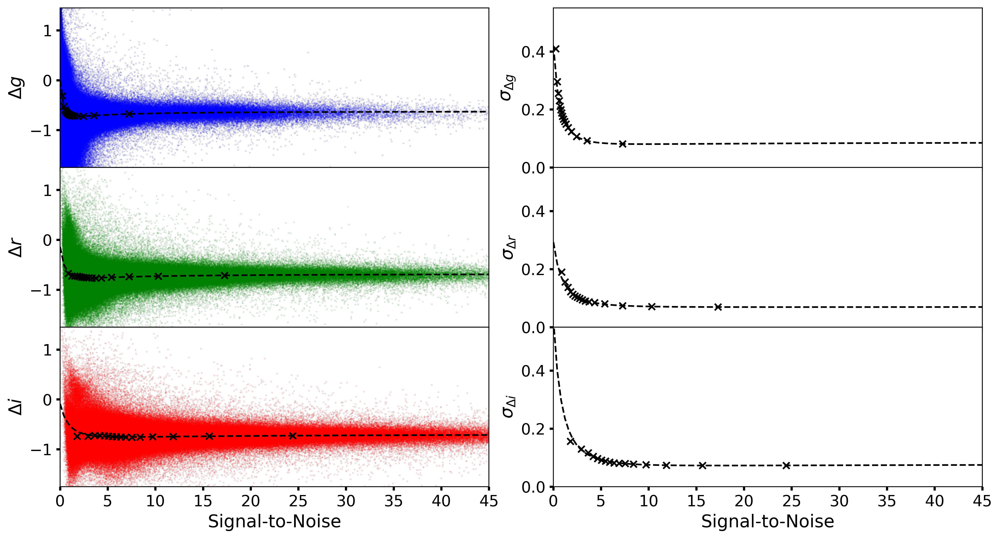

In [32]:

fig, ax = plt.subplots(3, 2, figsize=(15,8),dpi=400, sharex='col', gridspec_kw={'hspace': 0.0, 'wspace': 0.15})
ax[0,0].scatter(snMedian_g2_gal, mag_diff_gal_g2, c='blue' , s=0.005)
ax[0,0].scatter(snr_gal_g2_bin, mag_diff_gal_g2_median, color= 'black', marker='x')
ax[0,0].plot(snr_fit, mag_diff_gal_g2_fit, ls='--', c='black')
ax[0,0].set_ylabel(r'$\Delta g$', fontsize=16)
ax[0,0].yaxis.set_tick_params(labelsize=14, width=2)
ax[0,0].set_xlim([0,45])
ax[0,0].set_ylim([-1.75,1.45])

ax[1,0].scatter(snMedian_r2_gal, mag_diff_gal_r2, c='green' , s=0.005)
ax[1,0].scatter(snr_gal_r2_bin, mag_diff_gal_r2_median, color= 'black', marker='x')
ax[1,0].plot(snr_fit, mag_diff_gal_r2_fit, ls='--', c='black')
ax[1,0].set_ylabel(r'$\Delta r$', fontsize=16)
ax[1,0].yaxis.set_tick_params(labelsize=14, width=2)
ax[1,0].set_xlim([0,45])
ax[1,0].set_ylim([-1.75,1.45])

ax[2,0].scatter(snMedian_i2_gal, mag_diff_gal_i2, c='red' , s=0.005)
ax[2,0].scatter(snr_gal_i2_bin, mag_diff_gal_i2_median, color= 'black', marker='x')
ax[2,0].plot(snr_fit, mag_diff_gal_i2_fit, ls='--', c='black')
ax[2,0].set_xlabel('Signal-to-Noise', fontsize=16)
ax[2,0].set_ylabel(r'$\Delta i$', fontsize=16)
ax[2,0].yaxis.set_tick_params(labelsize=14, width=2)
ax[2,0].xaxis.set_tick_params(labelsize=14, width=2)
ax[2,0].set_xlim([0,45])
ax[2,0].set_ylim([-1.75,1.45])

ax[0,1].scatter(snr_gal_g2_bin, mag_diff_gal_g2_std, color= 'black', marker='x')
ax[0,1].plot(snr_fit, mag_std_gal_g2_fit, ls='--', c='black')
ax[0,1].set_ylabel(r'$\sigma_{\Delta g}$', fontsize=16)
ax[0,1].yaxis.set_tick_params(labelsize=14, width=2)
ax[0,1].set_xlim([0,45])
ax[0,1].set_ylim([0.0,0.55])

ax[1,1].scatter(snr_gal_r2_bin, mag_diff_gal_r2_std, color= 'black', marker='x')
ax[1,1].plot(snr_fit, mag_std_gal_r2_fit, ls='--', c='black')
ax[1,1].set_ylabel(r'$\sigma_{\Delta r}$', fontsize=16)
ax[1,1].yaxis.set_tick_params(labelsize=14, width=2)
ax[1,1].set_xlim([0,45])
ax[1,1].set_ylim([0.0,0.55])

ax[2,1].scatter(snr_gal_i2_bin, mag_diff_gal_i2_std, color= 'black', marker='x')
ax[2,1].plot(snr_fit, mag_std_gal_i2_fit, ls='--', c='black')
ax[2,1].set_ylabel(r'$\sigma_{\Delta i}$', fontsize=16)
ax[2,1].yaxis.set_tick_params(labelsize=14, width=2)
ax[2,1].set_xlabel('Signal-to-Noise', fontsize=16)
ax[2,1].xaxis.set_tick_params(labelsize=14, width=2)
ax[2,1].set_xlim([0,45])
ax[2,1].set_ylim([0.0,0.55])

plt.show()
fig.savefig('SNR_vs_mag_diff_Galaxies_set2.png')    


In [33]:

mag_diff_gal_g1_corrected = mag_diff_gal_g1 - np.interp(snMedian_g1_gal, snr_fit, mag_diff_gal_g1_fit)
mag_diff_gal_r1_corrected = mag_diff_gal_r1 - np.interp(snMedian_r1_gal, snr_fit, mag_diff_gal_r1_fit)
mag_diff_gal_i1_corrected = mag_diff_gal_i1 - np.interp(snMedian_i1_gal, snr_fit, mag_diff_gal_i1_fit)

mag_diff_gal_g2_corrected = mag_diff_gal_g2 - np.interp(snMedian_g2_gal, snr_fit, mag_diff_gal_g2_fit)
mag_diff_gal_r2_corrected = mag_diff_gal_r2 - np.interp(snMedian_r2_gal, snr_fit, mag_diff_gal_r2_fit)
mag_diff_gal_i2_corrected = mag_diff_gal_i2 - np.interp(snMedian_i2_gal, snr_fit, mag_diff_gal_i2_fit)

######################################################################################################################################################################################################################################

(-3.0, 3.0)

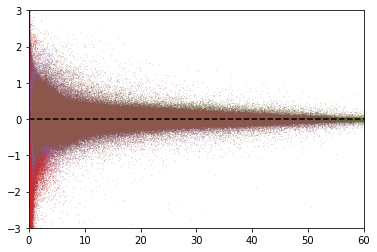

In [34]:
plt.scatter(snMedian_g1_gal,mag_diff_gal_g1_corrected, s=0.005)
plt.scatter(snMedian_r1_gal,mag_diff_gal_r1_corrected, s=0.005)
plt.scatter(snMedian_i1_gal,mag_diff_gal_i1_corrected, s=0.005)

plt.scatter(snMedian_g2_gal,mag_diff_gal_g2_corrected, s=0.005)
plt.scatter(snMedian_r2_gal,mag_diff_gal_r2_corrected, s=0.005)
plt.scatter(snMedian_i2_gal,mag_diff_gal_i2_corrected, s=0.005)
plt.plot([0,60],[0,0],'k--')
plt.xlim([0,60])
plt.ylim([-3.0,3.0])

(0, 10000)

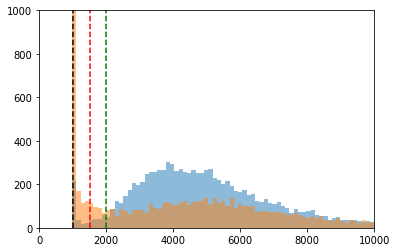

In [35]:
plt.hist(sigma_hb1*(2.3548*3.0e5/4861.363), alpha =0.5, bins=200)
plt.hist(sigma_hb2*(2.3548*3.0e5/4861.363), alpha=0.5, bins=200)
plt.plot([1000,1000],[0,1000], 'k--')
plt.plot([1500,1500],[0,1000], 'r--')
plt.plot([2000,2000],[0,1000], 'g--')
plt.ylim([0,1000])
plt.xlim([0,10000])

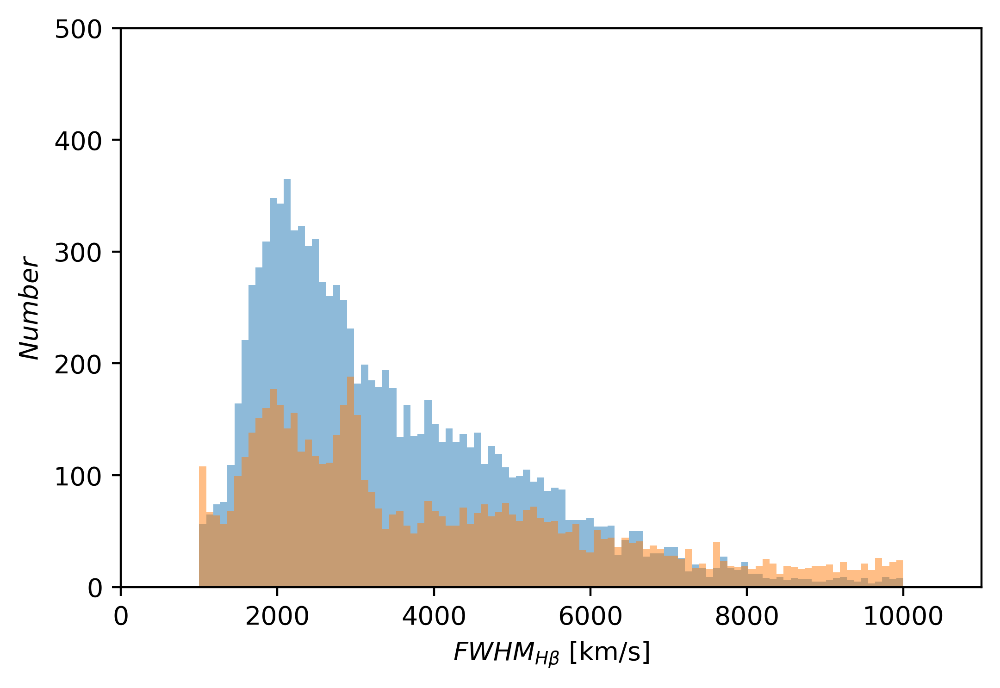

9114 6257


In [36]:
fwhm_fit_hb1 = (2.3548*2.99792458e5/4861.363)*sigma_hb1
fwhm_fit_hb2 = (2.3548*2.99792458e5/4861.363)*sigma_hb2

fwhm_hb1 = 2.3548*sigma_hb_archive1
fwhm_hb2 = 2.3548*sigma_hb_archive2

good_hist1 = np.where((fwhm_hb1 >= 1000.0) & (fwhm_hb1 <= 10000.0))
good_hist2 = np.where((fwhm_hb2 >= 1000.0) & (fwhm_hb2 <= 10000.0))

fig, ax = plt.subplots(1, figsize=(6,4),dpi=400)
ax.hist(fwhm_hb1[good_hist1], bins =100, color='C0', alpha=0.5)
ax.hist(fwhm_hb2[good_hist2], bins =100, color='C1', alpha=0.5)
ax.set_ylabel(r'$Number$')
ax.set_xlabel(r'$FWHM_{H\beta}$ [km/s]')
ax.set_xlim([0.0,11000.0])
ax.set_ylim([0,500])
plt.show()
fig.savefig('HB_FWHM_histogram_set_1and2.png')  

fwhm_cut1 = np.where((fwhm_hb1 >= 1500.0) & (fwhm_fit_hb1 <= 1.0e4) & (z_agn1 < 1.0) & (z_agn1 > 0.0) & (snMedian_i1 > 2.99)
                    & (fiberFlux_g1 > 0.0) & (fiberFlux_r1 > 0.0) & (fiberFlux_i1 > 0.0) 
                    & (spectroFlux_g1 > 0.0) & (spectroFlux_r1 > 0.0) & (spectroFlux_i1 > 0.0)
                    & (host_fraction_g_new1 > 0.0) & (host_fraction_r_new1 > 0.0)  & (host_fraction_i_new1 > 0.0)
                    & (host_fraction_g_new1 < 1.0) & (host_fraction_r_new1 < 1.0)  & (host_fraction_i_new1 < 1.0))
                    #& (fwhm_fit_hb1 >= 1000.0) & (fwhm_fit_hb1 <= 10000.0))
fwhm_cut2 = np.where((fwhm_hb2 >= 1500.0) & (fwhm_fit_hb2 <= 1.0e4) & (z_agn2 < 1.0) & (z_agn2 > 0.0) & (snMedian_i2 > 2.99)
                    & (fiberFlux_g2 > 0.0) & (fiberFlux_r2 > 0.0) & (fiberFlux_i2 > 0.0) 
                    & (spectroFlux_g2 > 0.0) & (spectroFlux_r2 > 0.0) & (spectroFlux_i2 > 0.0)
                    & (host_fraction_g_new2 > 0.0) & (host_fraction_r_new2 > 0.0)  & (host_fraction_i_new2 > 0.0)
                    & (host_fraction_g_new2 < 1.0) & (host_fraction_r_new2 < 1.0)  & (host_fraction_i_new2 < 1.0))
                    #& (fwhm_fit_hb2 >= 1000.0) & (fwhm_fit_hb2 <= 10000.0))

print(len(fwhm_cut1[0]), len(fwhm_cut2[0]))
######################################################################################################################################################################################################################################

(0, 11000)

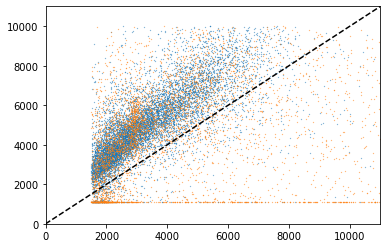

In [37]:
plt.scatter(fwhm_hb1[fwhm_cut1], fwhm_fit_hb1[fwhm_cut1], s=0.05)
plt.scatter(fwhm_hb2[fwhm_cut2], fwhm_fit_hb2[fwhm_cut2], s=0.05)
plt.plot([0,11000],[0,11000],'k--')
plt.ylim([0,11000])
plt.xlim([0,11000])

In [38]:
objid1_cut = objid1[fwhm_cut1]
ra1_cut     = ra1[fwhm_cut1]
dec1_cut    = dec1[fwhm_cut1]
umag1_cut   = umag1[fwhm_cut1]
err_u1_cut  = err_u1[fwhm_cut1]
gmag1_cut   = gmag1[fwhm_cut1]
err_g1_cut  = err_g1[fwhm_cut1]
rmag1_cut   = rmag1[fwhm_cut1]
err_r1_cut  = err_r1[fwhm_cut1]
imag1_cut   = imag1[fwhm_cut1]
err_i1_cut  = err_i1[fwhm_cut1]
zmag1_cut   = zmag1[fwhm_cut1]
err_z1_cut  = err_z1[fwhm_cut1]
plate1_cut  = plate1[fwhm_cut1]
fiberid1_cut    = fiberid1[fwhm_cut1]
redshift1_cut   = redshift1[fwhm_cut1]
snMedian1_cut   = snMedian1[fwhm_cut1]
snMedian_u1_cut = snMedian_u1[fwhm_cut1]
snMedian_g1_cut = snMedian_g1[fwhm_cut1]
snMedian_r1_cut = snMedian_r1[fwhm_cut1]
snMedian_i1_cut = snMedian_i1[fwhm_cut1]
snMedian_z1_cut = snMedian_z1[fwhm_cut1]
mjd_plate1_cut  = mjd_plate1[fwhm_cut1]
mjd_phot1_cut   = mjd_phot1[fwhm_cut1]
mjd_u1_cut = mjd_u1[fwhm_cut1]
mjd_g1_cut = mjd_g1[fwhm_cut1]
mjd_r1_cut = mjd_r1[fwhm_cut1]
mjd_i1_cut = mjd_i1[fwhm_cut1]
mjd_z1_cut = mjd_z1[fwhm_cut1]
fiberMag_u1_cut     = fiberMag_u1[fwhm_cut1]
fiberMagErr_u1_cut  = fiberMagErr_u1[fwhm_cut1]
fiberMag_g1_cut     = fiberMag_g1[fwhm_cut1]
fiberMagErr_g1_cut  = fiberMagErr_g1[fwhm_cut1]
fiberMag_r1_cut     = fiberMag_r1[fwhm_cut1]
fiberMagErr_r1_cut  = fiberMagErr_r1[fwhm_cut1]
fiberMag_i1_cut     = fiberMag_i1[fwhm_cut1]
fiberMagErr_i1_cut  = fiberMagErr_i1[fwhm_cut1]
fiberMag_z1_cut     = fiberMag_z1[fwhm_cut1]
fiberMagErr_z1_cut  = fiberMagErr_z1[fwhm_cut1]
fiberFlux_u1_cut    = fiberFlux_u1[fwhm_cut1]
fiberFluxIvar_u1_cut = fiberFluxIvar_u1[fwhm_cut1]
fiberFlux_g1_cut     = fiberFlux_g1[fwhm_cut1]
fiberFluxIvar_g1_cut = fiberFluxIvar_g1[fwhm_cut1]
fiberFlux_r1_cut     = fiberFlux_r1[fwhm_cut1]
fiberFluxIvar_r1_cut = fiberFluxIvar_r1[fwhm_cut1]
fiberFlux_i1_cut     = fiberFlux_i1[fwhm_cut1]
fiberFluxIvar_i1_cut = fiberFluxIvar_i1[fwhm_cut1]
fiberFlux_z1_cut     = fiberFlux_z1[fwhm_cut1]
fiberFluxIvar_z1_cut = fiberFluxIvar_z1[fwhm_cut1]
spectroFlux_u1_cut   = spectroFlux_u1[fwhm_cut1]
spectroFluxIvar_u1_cut = spectroFluxIvar_u1[fwhm_cut1]
spectroFlux_g1_cut     = spectroFlux_g1[fwhm_cut1]
spectroFluxIvar_g1_cut = spectroFluxIvar_g1[fwhm_cut1]
spectroFlux_r1_cut     = spectroFlux_r1[fwhm_cut1] 
spectroFluxIvar_r1_cut = spectroFluxIvar_r1[fwhm_cut1]
spectroFlux_i1_cut     = spectroFlux_i1[fwhm_cut1]
spectroFluxIvar_i1_cut = spectroFluxIvar_i1[fwhm_cut1]
spectroFlux_z1_cut     = spectroFlux_z1[fwhm_cut1] 
spectroFluxIvar_z1_cut = spectroFluxIvar_z1[fwhm_cut1]
an11_cut = an11[fwhm_cut1] 
an21_cut = an21[fwhm_cut1]
an31_cut = an31[fwhm_cut1] 
an41_cut = an41[fwhm_cut1] 
an51_cut = an51[fwhm_cut1] 
an61_cut = an61[fwhm_cut1]
an71_cut = an71[fwhm_cut1] 
an81_cut = an81[fwhm_cut1] 
an91_cut = an91[fwhm_cut1] 
an101_cut = an101[fwhm_cut1] 
gn11_cut = gn11[fwhm_cut1] 
gn21_cut = gn21[fwhm_cut1] 
gn31_cut = gn31[fwhm_cut1] 
gn41_cut = gn41[fwhm_cut1] 
gn51_cut = gn51[fwhm_cut1]
kcorr_u1_cut = kcorr_u1[fwhm_cut1] 
kcorr_g1_cut = kcorr_g1[fwhm_cut1]
kcorr_r1_cut = kcorr_r1[fwhm_cut1] 
kcorr_i1_cut = kcorr_i1[fwhm_cut1] 
kcorr_z1_cut = kcorr_z1[fwhm_cut1] 
absmag_u1_cut = absmag_u1[fwhm_cut1]
absmag_g1_cut = absmag_g1[fwhm_cut1] 
absmag_r1_cut = absmag_r1[fwhm_cut1] 
absmag_i1_cut = absmag_i1[fwhm_cut1] 
absmag_z1_cut = absmag_z1[fwhm_cut1]
extc_u1_cut = extc_u1[fwhm_cut1] 
extc_g1_cut = extc_g1[fwhm_cut1] 
extc_r1_cut = extc_r1[fwhm_cut1]
extc_i1_cut = extc_i1[fwhm_cut1] 
extc_z1_cut = extc_z1[fwhm_cut1]
sigma_ha1_cut       = sigma_ha1[fwhm_cut1]
sigma_ha_err1_cut   = sigma_ha_err1[fwhm_cut1]
sigma_hb1_cut       = sigma_hb1[fwhm_cut1] 
sigma_hb_err1_cut   = sigma_hb_err1[fwhm_cut1]
sigma_best1_cut     = sigma_best1[fwhm_cut1]
sigma_best_err1_cut = sigma_best_err1[fwhm_cut1]
sigma_ha_archive1_cut       = sigma_ha_archive1[fwhm_cut1]
sigma_ha_archive_err1_cut   = sigma_ha_archive_err1[fwhm_cut1]
sigma_hb_archive1_cut       = sigma_hb_archive1[fwhm_cut1]
sigma_hb_archive_err1_cut   = sigma_hb_archive_err1[fwhm_cut1]
peak_ha1_cut        = peak_ha1[fwhm_cut1]
peak_ha_err1_cut    = peak_ha_err1[fwhm_cut1]
peak_hb1_cut        = peak_hb1[fwhm_cut1]
peak_hb_err1_cut    = peak_hb_err1[fwhm_cut1] 
line_flux_ha1_cut   = line_flux_ha1[fwhm_cut1]
line_flux_ha_err1_cut = line_flux_ha_err1[fwhm_cut1]
line_flux_hb1_cut     = line_flux_hb1[fwhm_cut1]
line_flux_hb_err1_cut = line_flux_hb_err1[fwhm_cut1]
fwhm_kms1_cut         = fwhm_kms1[fwhm_cut1]
fwhm_kms_err1_cut     = fwhm_kms_err1[fwhm_cut1]
z_fit_ha1_cut         = z_fit_ha1[fwhm_cut1]
z_fit_hb1_cut         = z_fit_hb1[fwhm_cut1] 
z_fit_best1_cut       = z_fit_best1[fwhm_cut1] 
z_agn1_cut            = z_agn1[fwhm_cut1] 
z_agn_err1_cut        = z_agn_err1[fwhm_cut1]
line_flux_ha_archive1_cut       = line_flux_ha_archive1[fwhm_cut1] 
line_flux_ha_archive_err1_cut   = line_flux_ha_archive_err1[fwhm_cut1]
line_flux_hb_archive1_cut       = line_flux_hb_archive1[fwhm_cut1]
line_flux_hb_archive_err1_cut   = line_flux_hb_archive_err1[fwhm_cut1]
kcor_krc_g1_cut = kcor_krc_g1[fwhm_cut1]
kcor_krc_r1_cut = kcor_krc_r1[fwhm_cut1]
kcor_krc_i1_cut = kcor_krc_i1[fwhm_cut1]
g_abs1_cut      = g_abs1[fwhm_cut1]
r_abs1_cut      = r_abs1[fwhm_cut1] 
i_abs1_cut      = i_abs1[fwhm_cut1] 
mag_abs_agn_i1_cut             = mag_abs_agn_i1[fwhm_cut1]
delta_mag_agn_corrected_g1_cut = delta_mag_agn_corrected_g1[fwhm_cut1]
delta_mag_agn_corrected_r1_cut = delta_mag_agn_corrected_r1[fwhm_cut1]
delta_mag_agn_corrected_i1_cut = delta_mag_agn_corrected_i1[fwhm_cut1]
sigma_phot_g1_cut              = sigma_phot_g1[fwhm_cut1]
sigma_phot_r1_cut              = sigma_phot_r1[fwhm_cut1]
sigma_phot_i1_cut              = sigma_phot_i1[fwhm_cut1]
lambdaL5100_agn1_cut           = lambdaL5100_agn1[fwhm_cut1]
Luminosity_B_AGN1_cut          = Luminosity_B_AGN1[fwhm_cut1]
Luminosity_B_AGN_PSP1_cut      = Luminosity_B_AGN_PSP1[fwhm_cut1]
absmag_B_AGN1_cut              = absmag_B_AGN1[fwhm_cut1]
absmag_B_AGN_PSP1_cut          = absmag_B_AGN_PSP1[fwhm_cut1]
M_BH_51001_cut                 = M_BH_51001[fwhm_cut1]
host_fraction_g1_cut           = host_fraction_g_new1[fwhm_cut1]
host_fraction_r1_cut           = host_fraction_r_new1[fwhm_cut1]
host_fraction_i1_cut           = host_fraction_i_new1[fwhm_cut1]
psi_deviation_g1_cut          = psi_deviation_g1[fwhm_cut1]
psi_deviation_r1_cut          = psi_deviation_r1[fwhm_cut1]
psi_deviation_i1_cut          = psi_deviation_i1[fwhm_cut1]
fiber2flux_u_agn1_cut         = fiber2flux_u_agn1[fwhm_cut1]
fiber2flux_g_agn1_cut         = fiber2flux_g_agn1[fwhm_cut1]
fiber2flux_r_agn1_cut         = fiber2flux_r_agn1[fwhm_cut1]
fiber2flux_i_agn1_cut         = fiber2flux_i_agn1[fwhm_cut1]
fiber2flux_z_agn1_cut         = fiber2flux_z_agn1[fwhm_cut1]

######################################################################################################################################################################################################################################

In [39]:
objid2_cut = objid2[fwhm_cut2]
ra2_cut     = ra2[fwhm_cut2]
dec2_cut    = dec2[fwhm_cut2]
umag2_cut   = umag2[fwhm_cut2]
err_u2_cut  = err_u2[fwhm_cut2]
gmag2_cut   = gmag2[fwhm_cut2]
err_g2_cut  = err_g2[fwhm_cut2]
rmag2_cut   = rmag2[fwhm_cut2]
err_r2_cut  = err_r2[fwhm_cut2]
imag2_cut   = imag2[fwhm_cut2]
err_i2_cut  = err_i2[fwhm_cut2]
zmag2_cut   = zmag2[fwhm_cut2]
err_z2_cut  = err_z2[fwhm_cut2]
plate2_cut  = plate2[fwhm_cut2]
fiberid2_cut    = fiberid2[fwhm_cut2]
redshift2_cut   = redshift2[fwhm_cut2]
snMedian2_cut   = snMedian2[fwhm_cut2]
snMedian_u2_cut = snMedian_u2[fwhm_cut2]
snMedian_g2_cut = snMedian_g2[fwhm_cut2]
snMedian_r2_cut = snMedian_r2[fwhm_cut2]
snMedian_i2_cut = snMedian_i2[fwhm_cut2]
snMedian_z2_cut = snMedian_z2[fwhm_cut2]
mjd_plate2_cut  = mjd_plate2[fwhm_cut2]
mjd_phot2_cut   = mjd_phot2[fwhm_cut2]
mjd_u2_cut = mjd_u2[fwhm_cut2]
mjd_g2_cut = mjd_g2[fwhm_cut2]
mjd_r2_cut = mjd_r2[fwhm_cut2]
mjd_i2_cut = mjd_i2[fwhm_cut2]
mjd_z2_cut = mjd_z2[fwhm_cut2]
fiberMag_u2_cut     = fiberMag_u2[fwhm_cut2]
fiberMagErr_u2_cut  = fiberMagErr_u2[fwhm_cut2]
fiberMag_g2_cut     = fiberMag_g2[fwhm_cut2]
fiberMagErr_g2_cut  = fiberMagErr_g2[fwhm_cut2]
fiberMag_r2_cut     = fiberMag_r2[fwhm_cut2]
fiberMagErr_r2_cut  = fiberMagErr_r2[fwhm_cut2]
fiberMag_i2_cut     = fiberMag_i2[fwhm_cut2]
fiberMagErr_i2_cut  = fiberMagErr_i2[fwhm_cut2]
fiberMag_z2_cut     = fiberMag_z2[fwhm_cut2]
fiberMagErr_z2_cut  = fiberMagErr_z2[fwhm_cut2]
fiberFlux_u2_cut    = fiberFlux_u2[fwhm_cut2]
fiberFluxIvar_u2_cut = fiberFluxIvar_u2[fwhm_cut2]
fiberFlux_g2_cut     = fiberFlux_g2[fwhm_cut2]
fiberFluxIvar_g2_cut = fiberFluxIvar_g2[fwhm_cut2]
fiberFlux_r2_cut     = fiberFlux_r2[fwhm_cut2]
fiberFluxIvar_r2_cut = fiberFluxIvar_r2[fwhm_cut2]
fiberFlux_i2_cut     = fiberFlux_i2[fwhm_cut2]
fiberFluxIvar_i2_cut = fiberFluxIvar_i2[fwhm_cut2]
fiberFlux_z2_cut     = fiberFlux_z2[fwhm_cut2]
fiberFluxIvar_z2_cut = fiberFluxIvar_z2[fwhm_cut2]
spectroFlux_u2_cut   = spectroFlux_u2[fwhm_cut2]
spectroFluxIvar_u2_cut = spectroFluxIvar_u2[fwhm_cut2]
spectroFlux_g2_cut     = spectroFlux_g2[fwhm_cut2]
spectroFluxIvar_g2_cut = spectroFluxIvar_g2[fwhm_cut2]
spectroFlux_r2_cut     = spectroFlux_r2[fwhm_cut2] 
spectroFluxIvar_r2_cut = spectroFluxIvar_r2[fwhm_cut2]
spectroFlux_i2_cut     = spectroFlux_i2[fwhm_cut2]
spectroFluxIvar_i2_cut = spectroFluxIvar_i2[fwhm_cut2]
spectroFlux_z2_cut     = spectroFlux_z2[fwhm_cut2] 
spectroFluxIvar_z2_cut = spectroFluxIvar_z2[fwhm_cut2]
an12_cut = an12[fwhm_cut2] 
an22_cut = an22[fwhm_cut2]
an32_cut = an32[fwhm_cut2] 
an42_cut = an42[fwhm_cut2] 
an52_cut = an52[fwhm_cut2] 
an62_cut = an62[fwhm_cut2]
an72_cut = an72[fwhm_cut2] 
an82_cut = an82[fwhm_cut2] 
an92_cut = an92[fwhm_cut2] 
an102_cut = an102[fwhm_cut2] 
gn12_cut = gn12[fwhm_cut2] 
gn22_cut = gn22[fwhm_cut2] 
gn32_cut = gn32[fwhm_cut2] 
gn42_cut = gn42[fwhm_cut2] 
gn52_cut = gn52[fwhm_cut2]
kcorr_u2_cut = kcorr_u2[fwhm_cut2] 
kcorr_g2_cut = kcorr_g2[fwhm_cut2]
kcorr_r2_cut = kcorr_r2[fwhm_cut2] 
kcorr_i2_cut = kcorr_i2[fwhm_cut2] 
kcorr_z2_cut = kcorr_z2[fwhm_cut2] 
absmag_u2_cut = absmag_u2[fwhm_cut2]
absmag_g2_cut = absmag_g2[fwhm_cut2] 
absmag_r2_cut = absmag_r2[fwhm_cut2] 
absmag_i2_cut = absmag_i2[fwhm_cut2] 
absmag_z2_cut = absmag_z2[fwhm_cut2]
extc_u2_cut = extc_u2[fwhm_cut2] 
extc_g2_cut = extc_g2[fwhm_cut2] 
extc_r2_cut = extc_r2[fwhm_cut2]
extc_i2_cut = extc_i2[fwhm_cut2] 
extc_z2_cut = extc_z2[fwhm_cut2]
sigma_ha2_cut       = sigma_ha2[fwhm_cut2]
sigma_ha_err2_cut   = sigma_ha_err2[fwhm_cut2]
sigma_hb2_cut       = sigma_hb2[fwhm_cut2] 
sigma_hb_err2_cut   = sigma_hb_err2[fwhm_cut2]
sigma_best2_cut     = sigma_best2[fwhm_cut2]
sigma_best_err2_cut = sigma_best_err2[fwhm_cut2]
sigma_ha_archive2_cut       = sigma_ha_archive2[fwhm_cut2]
sigma_ha_archive_err2_cut   = sigma_ha_archive_err2[fwhm_cut2]
sigma_hb_archive2_cut       = sigma_hb_archive2[fwhm_cut2]
sigma_hb_archive_err2_cut   = sigma_hb_archive_err2[fwhm_cut2]
peak_ha2_cut        = peak_ha2[fwhm_cut2]
peak_ha_err2_cut    = peak_ha_err2[fwhm_cut2]
peak_hb2_cut        = peak_hb2[fwhm_cut2]
peak_hb_err2_cut    = peak_hb_err2[fwhm_cut2] 
line_flux_ha2_cut   = line_flux_ha2[fwhm_cut2]
line_flux_ha_err2_cut = line_flux_ha_err2[fwhm_cut2]
line_flux_hb2_cut     = line_flux_hb2[fwhm_cut2]
line_flux_hb_err2_cut = line_flux_hb_err2[fwhm_cut2]
fwhm_kms2_cut         = fwhm_kms2[fwhm_cut2]
fwhm_kms_err2_cut     = fwhm_kms_err2[fwhm_cut2]
z_fit_ha2_cut         = z_fit_ha2[fwhm_cut2]
z_fit_hb2_cut         = z_fit_hb2[fwhm_cut2] 
z_fit_best2_cut       = z_fit_best2[fwhm_cut2] 
z_agn2_cut            = z_agn2[fwhm_cut2] 
z_agn_err2_cut        = z_agn_err2[fwhm_cut2]
line_flux_ha_archive2_cut       = line_flux_ha_archive2[fwhm_cut2] 
line_flux_ha_archive_err2_cut   = line_flux_ha_archive_err2[fwhm_cut2]
line_flux_hb_archive2_cut       = line_flux_hb_archive2[fwhm_cut2]
line_flux_hb_archive_err2_cut   = line_flux_hb_archive_err2[fwhm_cut2]
kcor_krc_g2_cut = kcor_krc_g2[fwhm_cut2]
kcor_krc_r2_cut = kcor_krc_r2[fwhm_cut2]
kcor_krc_i2_cut = kcor_krc_i2[fwhm_cut2]
g_abs2_cut      = g_abs2[fwhm_cut2]
r_abs2_cut      = r_abs2[fwhm_cut2] 
i_abs2_cut      = i_abs2[fwhm_cut2] 
mag_abs_agn_i2_cut             = mag_abs_agn_i2[fwhm_cut2]
delta_mag_agn_corrected_g2_cut = delta_mag_agn_corrected_g2[fwhm_cut2]
delta_mag_agn_corrected_r2_cut = delta_mag_agn_corrected_r2[fwhm_cut2]
delta_mag_agn_corrected_i2_cut = delta_mag_agn_corrected_i2[fwhm_cut2]
sigma_phot_g2_cut              = sigma_phot_g2[fwhm_cut2]
sigma_phot_r2_cut              = sigma_phot_r2[fwhm_cut2]
sigma_phot_i2_cut              = sigma_phot_i2[fwhm_cut2]
lambdaL5100_agn2_cut           = lambdaL5100_agn2[fwhm_cut2]
Luminosity_B_AGN2_cut          = Luminosity_B_AGN2[fwhm_cut2]
Luminosity_B_AGN_PSP2_cut      = Luminosity_B_AGN_PSP2[fwhm_cut2]
absmag_B_AGN2_cut              = absmag_B_AGN2[fwhm_cut2]
absmag_B_AGN_PSP2_cut          = absmag_B_AGN_PSP2[fwhm_cut2]
M_BH_51002_cut                 = M_BH_51002[fwhm_cut2]
host_fraction_g2_cut           = host_fraction_g_new2[fwhm_cut2]
host_fraction_r2_cut           = host_fraction_r_new2[fwhm_cut2]
host_fraction_i2_cut           = host_fraction_i_new2[fwhm_cut2]
psi_deviation_g2_cut          = psi_deviation_g2[fwhm_cut2]
psi_deviation_r2_cut          = psi_deviation_r2[fwhm_cut2]
psi_deviation_i2_cut          = psi_deviation_i2[fwhm_cut2]

fiber2flux_u_agn2_cut         = fiber2flux_u_agn2[fwhm_cut2]
fiber2flux_g_agn2_cut         = fiber2flux_g_agn2[fwhm_cut2]
fiber2flux_r_agn2_cut         = fiber2flux_r_agn2[fwhm_cut2]
fiber2flux_i_agn2_cut         = fiber2flux_i_agn2[fwhm_cut2]
fiber2flux_z_agn2_cut         = fiber2flux_z_agn2[fwhm_cut2]

######################################################################################################################################################################################################################################

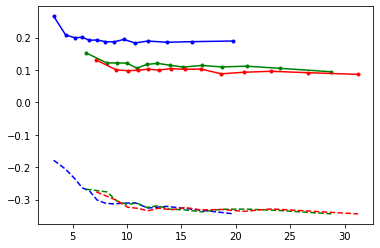

In [40]:

mag_diff_g1 = -2.5*np.log10(spectroFlux_g1_cut/fiberFlux_g1_cut) # fiberMag_g2 - gmag2
mag_diff_r1 = -2.5*np.log10(spectroFlux_r1_cut/fiberFlux_r1_cut)
mag_diff_i1 = -2.5*np.log10(spectroFlux_i1_cut/fiberFlux_i1_cut)

bin_num = 14 #int((bin_stop_snr - bin_start_snr)/bin_size)

mag_diff_g1_mean = np.zeros(bin_num)
mag_diff_r1_mean = np.zeros(bin_num)
mag_diff_i1_mean = np.zeros(bin_num)

mag_diff_g1_median = np.zeros(bin_num)
mag_diff_r1_median = np.zeros(bin_num)
mag_diff_i1_median = np.zeros(bin_num)

mag_diff_g1_std = np.zeros(bin_num)
mag_diff_r1_std = np.zeros(bin_num)
mag_diff_i1_std = np.zeros(bin_num)

snr_g1_bin = np.zeros(bin_num)
snr_r1_bin = np.zeros(bin_num)
snr_i1_bin = np.zeros(bin_num)

snMedian_g1_cut_sorted = np.sort(snMedian_g1_cut)[int(np.floor(0.025*len(snMedian_g1_cut))):int(np.floor(0.95*len(snMedian_g1_cut)))]
snMedian_r1_cut_sorted = np.sort(snMedian_r1_cut)[int(np.floor(0.025*len(snMedian_r1_cut))):int(np.floor(0.95*len(snMedian_r1_cut)))]
snMedian_i1_cut_sorted = np.sort(snMedian_i1_cut)[int(np.floor(0.025*len(snMedian_i1_cut))):int(np.floor(0.95*len(snMedian_i1_cut)))]

good_sort_g1 = np.where((snMedian_g1_cut_sorted < snMedian_g1_cut_sorted[-1]) & (snMedian_g1_cut_sorted >= snMedian_g1_cut_sorted[0]))
good_sort_r1 = np.where((snMedian_r1_cut_sorted < snMedian_r1_cut_sorted[-1]) & (snMedian_r1_cut_sorted >= snMedian_r1_cut_sorted[0]))
good_sort_i1 = np.where((snMedian_i1_cut_sorted < snMedian_i1_cut_sorted[-1]) & (snMedian_i1_cut_sorted >= snMedian_i1_cut_sorted[0]))

int_step_g1 = list(np.arange(0,bin_num + 1)*int(np.floor(len(snMedian_g1_cut_sorted[good_sort_g1])/bin_num)))
int_step_r1 = list(np.arange(0,bin_num + 1)*int(np.floor(len(snMedian_r1_cut_sorted[good_sort_r1])/bin_num)))
int_step_i1 = list(np.arange(0,bin_num + 1)*int(np.floor(len(snMedian_i1_cut_sorted[good_sort_i1])/bin_num)))

bin_step_sn_g1 = snMedian_g1_cut_sorted[good_sort_g1][int_step_g1]
bin_step_sn_r1 = snMedian_r1_cut_sorted[good_sort_r1][int_step_r1]
bin_step_sn_i1 = snMedian_i1_cut_sorted[good_sort_i1][int_step_i1]

for k in range(0,bin_num):
    good_range_g1 = np.where((snMedian_g1_cut >= bin_step_sn_g1[k]) & (snMedian_g1_cut < bin_step_sn_g1[k + 1]))
    good_range_r1 = np.where((snMedian_r1_cut >= bin_step_sn_r1[k]) & (snMedian_r1_cut < bin_step_sn_r1[k + 1]))
    good_range_i1 = np.where((snMedian_i1_cut >= bin_step_sn_i1[k]) & (snMedian_i1_cut < bin_step_sn_i1[k + 1]))

    mag_diff_g1_mean[k], mag_diff_g1_median[k], mag_diff_g1_std[k] = \
        sigma_clipped_stats(mag_diff_g1[good_range_g1], sigma=3.0, maxiters=3, cenfunc='median')

    mag_diff_r1_mean[k], mag_diff_r1_median[k], mag_diff_r1_std[k] = \
        sigma_clipped_stats(mag_diff_r1[good_range_r1], sigma=3.0, maxiters=3, cenfunc='median')

    mag_diff_i1_mean[k], mag_diff_i1_median[k], mag_diff_i1_std[k] = \
        sigma_clipped_stats(mag_diff_i1[good_range_i1], sigma=3.0, maxiters=3, cenfunc='median')

    snr_g1_bin[k]       =  np.median(snMedian_g1_cut[good_range_g1])
    snr_r1_bin[k]       =  np.median(snMedian_r1_cut[good_range_r1])
    snr_i1_bin[k]       =  np.median(snMedian_i1_cut[good_range_i1])

plt.plot(snr_g1_bin, mag_diff_g1_median, 'b--')
plt.plot(snr_r1_bin, mag_diff_r1_median, 'g--')
plt.plot(snr_i1_bin, mag_diff_i1_median, 'r--')
plt.plot(snr_g1_bin, mag_diff_g1_std, 'b.-')
plt.plot(snr_r1_bin, mag_diff_r1_std, 'g.-')
plt.plot(snr_i1_bin, mag_diff_i1_std, 'r.-')

popt_g1, pcov_g1 = curve_fit(trumpet_curve, snr_g1_bin, mag_diff_g1_median, sigma=1.0/(snr_g1_bin**2.0), absolute_sigma=False, check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),
popt_r1, pcov_r1 = curve_fit(trumpet_curve, snr_r1_bin, mag_diff_r1_median, sigma=1.0/(snr_r1_bin**2.0), absolute_sigma=False, check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),
popt_i1, pcov_i1 = curve_fit(trumpet_curve, snr_i1_bin[0:-1], mag_diff_i1_median[0:-1], sigma=1.0/(snr_i1_bin[0:-1]**2.0), absolute_sigma=False, check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),

#popt_g1_std, pcov_g1_std = curve_fit(trumpet_curve, snr_g1_bin, mag_diff_g1_std, sigma=1.0/(snr_g1_bin**2.0), check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),
#popt_r1_std, pcov_r1_std = curve_fit(trumpet_curve, snr_r1_bin, mag_diff_r1_std, sigma=1.0/(snr_r1_bin**2.0), check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),
#popt_i1_std, pcov_i1_std = curve_fit(trumpet_curve, snr_i1_bin, mag_diff_i1_std, sigma=1.0/(snr_i1_bin**2.0), check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),


snr_fit = np.linspace(0.01,100,250)
mag_diff_g1_fit = trumpet_curve(snr_fit, popt_g1[0], popt_g1[1], popt_g1[2], popt_g1[3])
mag_diff_r1_fit = trumpet_curve(snr_fit, popt_r1[0], popt_r1[1], popt_r1[2], popt_r1[3])
mag_diff_i1_fit = trumpet_curve(snr_fit, popt_i1[0], popt_i1[1], popt_i1[2], popt_i1[3])

#mag_std_g1_fit = trumpet_curve(snr_fit, popt_g1_std[0], popt_g1_std[1], popt_g1_std[2], popt_g1_std[3])
#mag_std_r1_fit = trumpet_curve(snr_fit, popt_r1_std[0], popt_r1_std[1], popt_r1_std[2], popt_r1_std[3])
#mag_std_i1_fit = trumpet_curve(snr_fit, popt_i1_std[0], popt_i1_std[1], popt_i1_std[2], popt_i1_std[3])



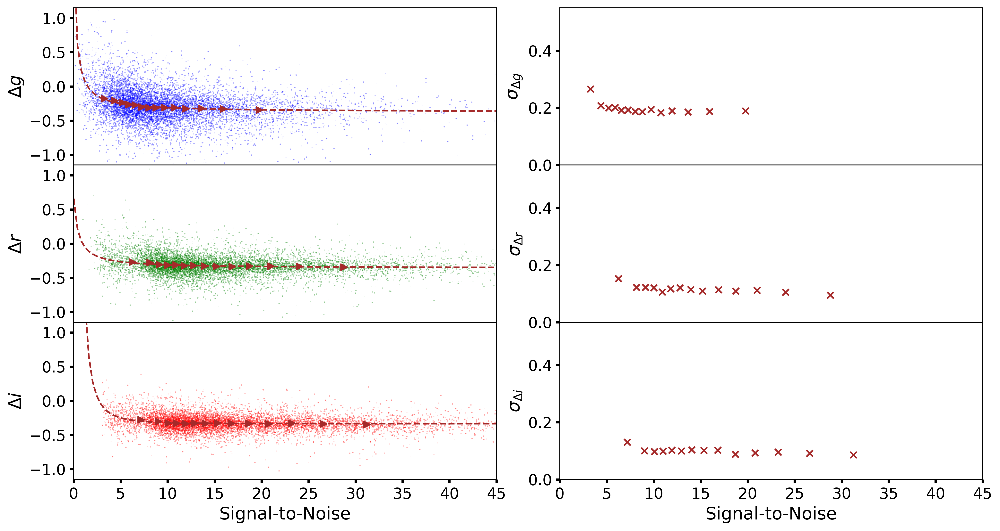

In [41]:
fig, ax = plt.subplots(3, 2, figsize=(15,8),dpi=400, sharex='col', gridspec_kw={'hspace': 0.0, 'wspace': 0.15})

ax[0,0].scatter(snMedian_g1_cut, mag_diff_g1, c='blue' , s=0.01)
ax[0,0].scatter(snr_g1_bin, mag_diff_g1_median, color= 'brown', marker='>')
ax[0,0].plot(snr_fit, mag_diff_g1_fit, ls='--', c='brown')
ax[0,0].set_ylabel(r'$\Delta g$', fontsize=16)
ax[0,0].yaxis.set_tick_params(labelsize=14, width=2)
ax[0,0].set_xlim([0,45])
ax[0,0].set_ylim([-1.15,1.15])

ax[1,0].scatter(snMedian_r1_cut, mag_diff_r1, c='green' , s=0.01)
ax[1,0].scatter(snr_r1_bin, mag_diff_r1_median, color= 'brown', marker='>')
ax[1,0].plot(snr_fit, mag_diff_r1_fit, ls='--', c='brown')
ax[1,0].set_ylabel(r'$\Delta r$', fontsize=16)
ax[1,0].yaxis.set_tick_params(labelsize=14, width=2)
ax[1,0].set_xlim([0,45])
ax[1,0].set_ylim([-1.15,1.15])

ax[2,0].scatter(snMedian_i1_cut, mag_diff_i1, c='red' , s=0.01)
ax[2,0].scatter(snr_i1_bin, mag_diff_i1_median, color= 'brown', marker='>')
ax[2,0].plot(snr_fit, mag_diff_i1_fit, ls='--', c='brown')
ax[2,0].set_xlabel('Signal-to-Noise', fontsize=16)
ax[2,0].set_ylabel(r'$\Delta i$', fontsize=16)
ax[2,0].yaxis.set_tick_params(labelsize=14, width=2)
ax[2,0].xaxis.set_tick_params(labelsize=14, width=2)
ax[2,0].set_xlim([0,45])
ax[2,0].set_ylim([-1.15,1.15])

ax[0,1].scatter(snr_g1_bin, mag_diff_g1_std, color= 'brown', marker='x')
#ax[0,1].plot(snr_fit, mag_std_g1_fit, ls='--', c='brown')
ax[0,1].set_ylabel(r'$\sigma_{\Delta g}$', fontsize=16)
ax[0,1].yaxis.set_tick_params(labelsize=14, width=2)
ax[0,1].set_xlim([0,45])
ax[0,1].set_ylim([0.0,0.55])

ax[1,1].scatter(snr_r1_bin, mag_diff_r1_std, color= 'brown', marker='x')
#ax[1,1].plot(snr_fit, mag_std_r1_fit, ls='--', c='brown')
ax[1,1].set_ylabel(r'$\sigma_{\Delta r}$', fontsize=16)
ax[1,1].yaxis.set_tick_params(labelsize=14, width=2)
ax[1,1].set_xlim([0,45])
ax[1,1].set_ylim([0.0,0.55])

ax[2,1].scatter(snr_i1_bin, mag_diff_i1_std, color= 'brown', marker='x')
#ax[2,1].plot(snr_fit, mag_std_i1_fit, ls='--', c='brown')
ax[2,1].set_ylabel(r'$\sigma_{\Delta i}$', fontsize=16)
ax[2,1].yaxis.set_tick_params(labelsize=14, width=2)
ax[2,1].set_xlabel('Signal-to-Noise', fontsize=16)
ax[2,1].xaxis.set_tick_params(labelsize=14, width=2)
ax[2,1].set_xlim([0,45])
ax[2,1].set_ylim([0.0,0.55])

plt.show()
fig.savefig('SNR_vs_mag_diff_AGN_FWHM1000cut_set1.png')      

#################################################################################################################################


In [42]:
#mag_diff2_g = -2.5*np.log10(spectroFlux_g2_cut/fiberFlux_g2_cut) # fiberMag_g2 - gmag2
#mag_diff2_r = -2.5*np.log10(spectroFlux_r2_cut/fiberFlux_r2_cut)
#mag_diff2_i = -2.5*np.log10(spectroFlux_i2_cut/fiberFlux_i2_cut)

mag_diff2_g = -2.5*np.log10(spectroFlux_g2_cut/fiber2flux_g_agn2_cut) # fiberMag_g2 - gmag2
mag_diff2_r = -2.5*np.log10(spectroFlux_r2_cut/fiber2flux_r_agn2_cut)
mag_diff2_i = -2.5*np.log10(spectroFlux_i2_cut/fiber2flux_i_agn2_cut)

bin_size = 4.0 # bin size in SNR space
bin_start_snr = 3.0
bin_stop_snr = 27.0

bin_num = 14 #int((bin_stop_snr - bin_start_snr)/bin_size)

mag_diff_g2_mean = np.zeros(bin_num)
mag_diff_r2_mean = np.zeros(bin_num)
mag_diff_i2_mean = np.zeros(bin_num)

mag_diff_g2_median = np.zeros(bin_num)
mag_diff_r2_median = np.zeros(bin_num)
mag_diff_i2_median = np.zeros(bin_num)

mag_diff_g2_std = np.zeros(bin_num)
mag_diff_r2_std = np.zeros(bin_num)
mag_diff_i2_std = np.zeros(bin_num)

snr_g2_bin = np.zeros(bin_num)
snr_r2_bin = np.zeros(bin_num)
snr_i2_bin = np.zeros(bin_num)



snMedian_g2_cut_sorted = np.sort(snMedian_g2_cut)[int(np.floor(0.01*len(snMedian_g2_cut))):int(np.floor(0.92*len(snMedian_g2_cut)))]
snMedian_r2_cut_sorted = np.sort(snMedian_r2_cut)[int(np.floor(0.010*len(snMedian_r2_cut))):int(np.floor(0.995*len(snMedian_r2_cut)))]
snMedian_i2_cut_sorted = np.sort(snMedian_i2_cut)[int(np.floor(0.010*len(snMedian_i2_cut))):int(np.floor(0.995*len(snMedian_i2_cut)))]

good_sort_g2 = np.where((snMedian_g2_cut_sorted < snMedian_g2_cut_sorted[-1]) & (snMedian_g2_cut_sorted >= snMedian_g2_cut_sorted[0]))
good_sort_r2 = np.where((snMedian_r2_cut_sorted < snMedian_r2_cut_sorted[-1]) & (snMedian_r2_cut_sorted >= snMedian_r2_cut_sorted[0]))
good_sort_i2 = np.where((snMedian_i2_cut_sorted < snMedian_i2_cut_sorted[-1]) & (snMedian_i2_cut_sorted >= snMedian_i2_cut_sorted[0]))

int_step_g2 = list(np.arange(0,bin_num + 1)*int(np.floor(len(snMedian_g2_cut_sorted[good_sort_g2])/bin_num)))
int_step_r2 = list(np.arange(0,bin_num + 1)*int(np.floor(len(snMedian_r2_cut_sorted[good_sort_r2])/bin_num)))
int_step_i2 = list(np.arange(0,bin_num + 1)*int(np.floor(len(snMedian_i2_cut_sorted[good_sort_i2])/bin_num)))

bin_step_sn_g2 = snMedian_g2_cut_sorted[good_sort_g2][int_step_g2]
bin_step_sn_r2 = snMedian_r2_cut_sorted[good_sort_r2][int_step_r2]
bin_step_sn_i2 = snMedian_i2_cut_sorted[good_sort_i2][int_step_i2]



In [43]:
k=0
for k in range(0,bin_num):
    good_range_g2 = np.where((snMedian_g2_cut >= bin_step_sn_g2[k]) & (snMedian_g2_cut < bin_step_sn_g2[k + 1]))
    good_range_r2 = np.where((snMedian_r2_cut >= bin_step_sn_r2[k]) & (snMedian_r2_cut < bin_step_sn_r2[k + 1]))
    good_range_i2 = np.where((snMedian_i2_cut >= bin_step_sn_i2[k]) & (snMedian_i2_cut < bin_step_sn_i2[k + 1]))

    mag_diff_g2_mean[k], mag_diff_g2_median[k], mag_diff_g2_std[k] = \
        sigma_clipped_stats(mag_diff2_g[good_range_g2], sigma=2.5, maxiters=3, cenfunc='median')

    mag_diff_r2_mean[k], mag_diff_r2_median[k], mag_diff_r2_std[k] = \
        sigma_clipped_stats(mag_diff2_r[good_range_r2], sigma=2.5, maxiters=3, cenfunc='median')

    mag_diff_i2_mean[k], mag_diff_i2_median[k], mag_diff_i2_std[k] = \
        sigma_clipped_stats(mag_diff2_i[good_range_i2], sigma=2.5, maxiters=3, cenfunc='median')

    snr_g2_bin[k]       =  np.median(snMedian_g2_cut[good_range_g2])
    snr_r2_bin[k]       =  np.median(snMedian_r2_cut[good_range_r2])
    snr_i2_bin[k]       =  np.median(snMedian_i2_cut[good_range_i2])


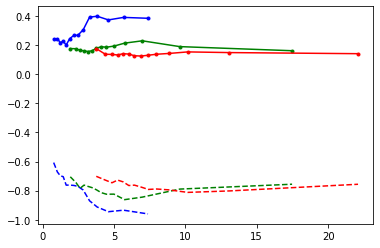

In [44]:

plt.plot(snr_g2_bin, mag_diff_g2_median, 'b--')
plt.plot(snr_r2_bin, mag_diff_r2_median, 'g--')
plt.plot(snr_i2_bin, mag_diff_i2_median, 'r--')
plt.plot(snr_g2_bin, mag_diff_g2_std, 'b.-')
plt.plot(snr_r2_bin, mag_diff_r2_std, 'g.-')
plt.plot(snr_i2_bin, mag_diff_i2_std, 'r.-')

In [45]:

popt_g2, pcov_g2 = curve_fit(trumpet_curve, snr_g2_bin, mag_diff_g2_median, sigma=1.0/(snr_g2_bin**2.0), absolute_sigma=False, check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),
popt_r2, pcov_r2 = curve_fit(trumpet_curve, snr_r2_bin, mag_diff_r2_median, sigma=1.0/(snr_r2_bin**2.0), absolute_sigma=False, check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),
popt_i2, pcov_i2 = curve_fit(trumpet_curve, snr_i2_bin, mag_diff_i2_median, sigma=1.0/(snr_i2_bin**2.0), absolute_sigma=False, check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),

#popt_g2_std, pcov_g2_std = curve_fit(trumpet_curve1, snr_g2_bin[0:4], mag_diff_g2_std[0:4], sigma=1.0/(snr_g2_bin[0:4]**2.0), check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),
#popt_r2_std, pcov_r2_std = curve_fit(trumpet_curve1, snr_r2_bin[0:4], mag_diff_r2_std[0:4], sigma=1.0/(snr_r2_bin[0:4]**2.0), check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),
#popt_i2_std, pcov_i2_std = curve_fit(trumpet_curve1, snr_i2_bin[0:4], mag_diff_i2_std[0:4], sigma=1.0/(snr_i2_bin[0:4]**2.0), check_finite=True, method='trf') #, method='trf' bounds=(lower_bounds, upper_bounds),


snr_fit = np.linspace(0.01,100,250)
mag_diff_g2_fit = trumpet_curve(snr_fit, popt_g2[0], popt_g2[1], popt_g2[2], popt_g2[3]) #, popt_g2[4])
mag_diff_r2_fit = trumpet_curve(snr_fit, popt_r2[0], popt_r2[1], popt_r2[2], popt_r2[3]) #, popt_r2[4])
mag_diff_i2_fit = trumpet_curve(snr_fit, popt_i2[0], popt_i2[1], popt_i2[2], popt_i2[3])#, popt_i2[4])

#mag_std_g2_fit = trumpet_curve1(snr_fit, popt_g2_std[0], popt_g2_std[1], popt_g2_std[2], popt_g2_std[3])
#mag_std_r2_fit = trumpet_curve1(snr_fit, popt_r2_std[0], popt_r2_std[1], popt_r2_std[2], popt_r2_std[3])
#mag_std_i2_fit = trumpet_curve1(snr_fit, popt_i2_std[0], popt_i2_std[1], popt_i2_std[2], popt_i2_std[3])


In [46]:
print(len(snr_g2_bin))

14


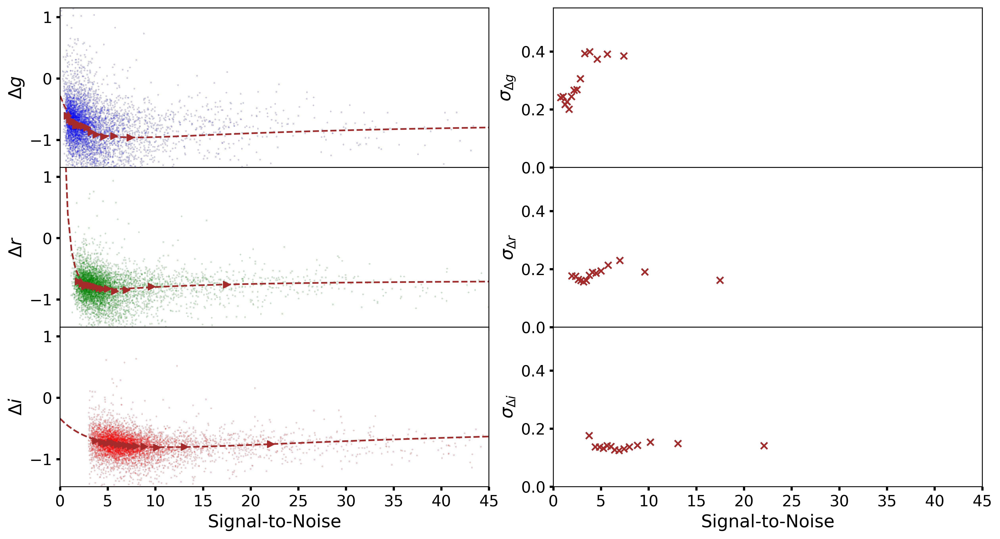

In [47]:

fig, ax = plt.subplots(3, 2, figsize=(15,8),dpi=400, sharex='col', gridspec_kw={'hspace': 0.0, 'wspace': 0.15})

ax[0,0].scatter(snMedian_g2_cut, mag_diff2_g, c='blue' , s=0.01)
ax[0,0].scatter(snr_g2_bin, mag_diff_g2_median, color= 'brown', marker='>')
ax[0,0].plot(snr_fit, mag_diff_g2_fit, ls='--', c='brown')
ax[0,0].set_ylabel(r'$\Delta g$', fontsize=16)
ax[0,0].yaxis.set_tick_params(labelsize=14, width=2)
ax[0,0].set_xlim([0,45])
ax[0,0].set_ylim([-1.45,1.15])

ax[1,0].scatter(snMedian_r2_cut, mag_diff2_r, c='green' , s=0.01)
ax[1,0].scatter(snr_r2_bin, mag_diff_r2_median, color= 'brown', marker='>')
ax[1,0].plot(snr_fit, mag_diff_r2_fit, ls='--', c='brown')
ax[1,0].set_ylabel(r'$\Delta r$', fontsize=16)
ax[1,0].yaxis.set_tick_params(labelsize=14, width=2)
ax[1,0].set_xlim([0,45])
ax[1,0].set_ylim([-1.45,1.15])

ax[2,0].scatter(snMedian_i2_cut, mag_diff2_i, c='red' , s=0.01)
ax[2,0].scatter(snr_i2_bin, mag_diff_i2_median, color= 'brown', marker='>')
ax[2,0].plot(snr_fit, mag_diff_i2_fit, ls='--', c='brown')
ax[2,0].set_xlabel('Signal-to-Noise', fontsize=16)
ax[2,0].set_ylabel(r'$\Delta i$', fontsize=16)
ax[2,0].yaxis.set_tick_params(labelsize=14, width=2)
ax[2,0].xaxis.set_tick_params(labelsize=14, width=2)
ax[2,0].set_xlim([0,45])
ax[2,0].set_ylim([-1.45,1.15])

ax[0,1].scatter(snr_g2_bin, mag_diff_g2_std, color= 'brown', marker='x')
#ax[0,1].plot(snr_fit, mag_std_g2_fit, ls='--', c='brown')
ax[0,1].set_ylabel(r'$\sigma_{\Delta g}$', fontsize=16)
ax[0,1].yaxis.set_tick_params(labelsize=14, width=2)
ax[0,1].set_xlim([0,45])
ax[0,1].set_ylim([0.0,0.55])

ax[1,1].scatter(snr_r2_bin, mag_diff_r2_std, color= 'brown', marker='x')
#ax[1,1].plot(snr_fit, mag_std_r2_fit, ls='--', c='brown')
ax[1,1].set_ylabel(r'$\sigma_{\Delta r}$', fontsize=16)
ax[1,1].yaxis.set_tick_params(labelsize=14, width=2)
ax[1,1].set_xlim([0,45])
ax[1,1].set_ylim([0.0,0.55])

ax[2,1].scatter(snr_i2_bin, mag_diff_i2_std, color= 'brown', marker='x')
#ax[2,1].plot(snr_fit, mag_std_i1_fit, ls='--', c='brown')
ax[2,1].set_ylabel(r'$\sigma_{\Delta i}$', fontsize=16)
ax[2,1].yaxis.set_tick_params(labelsize=14, width=2)
ax[2,1].set_xlabel('Signal-to-Noise', fontsize=16)
ax[2,1].xaxis.set_tick_params(labelsize=14, width=2)
ax[2,1].set_xlim([0,45])
ax[2,1].set_ylim([0.0,0.55])

plt.show()
fig.savefig('SNR_vs_mag_diff_AGN_FWHM1000cut_set2.png')    

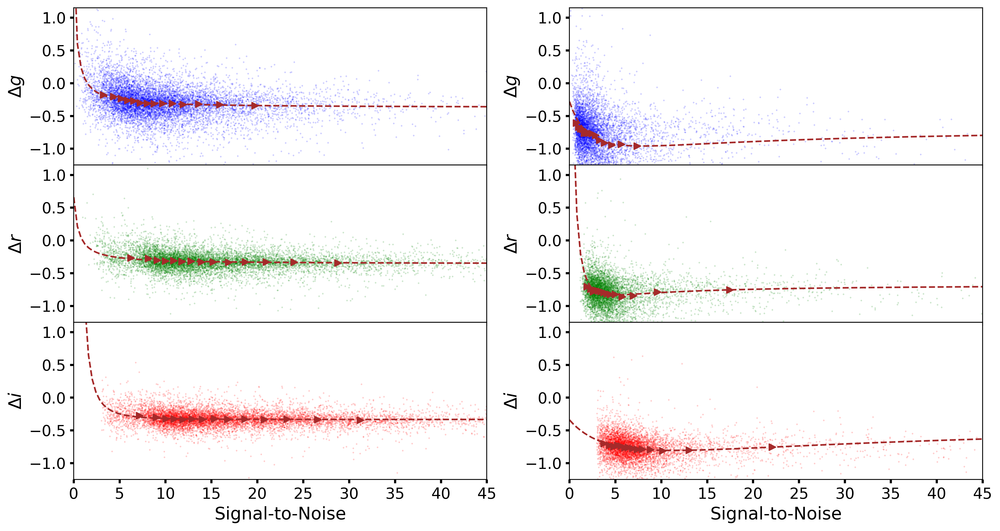

In [48]:
fig, ax = plt.subplots(3, 2, figsize=(15,8),dpi=400, sharex='col', gridspec_kw={'hspace': 0.0, 'wspace': 0.2})

ax[0,0].scatter(snMedian_g1_cut, mag_diff_g1, c='blue' , s=0.01)
ax[0,0].scatter(snr_g1_bin, mag_diff_g1_median, color= 'brown', marker='>')
ax[0,0].plot(snr_fit, mag_diff_g1_fit, ls='--', c='brown')
ax[0,0].set_ylabel(r'$\Delta g$', fontsize=16)
ax[0,0].yaxis.set_tick_params(labelsize=14, width=2)
ax[0,0].set_xlim([0,45])
ax[0,0].set_ylim([-1.25,1.15])

ax[1,0].scatter(snMedian_r1_cut, mag_diff_r1, c='green' , s=0.01)
ax[1,0].scatter(snr_r1_bin, mag_diff_r1_median, color= 'brown', marker='>')
ax[1,0].plot(snr_fit, mag_diff_r1_fit, ls='--', c='brown')
ax[1,0].set_ylabel(r'$\Delta r$', fontsize=16)
ax[1,0].yaxis.set_tick_params(labelsize=14, width=2)
ax[1,0].set_xlim([0,45])
ax[1,0].set_ylim([-1.25,1.15])

ax[2,0].scatter(snMedian_i1_cut, mag_diff_i1, c='red' , s=0.01)
ax[2,0].scatter(snr_i1_bin, mag_diff_i1_median, color= 'brown', marker='>')
ax[2,0].plot(snr_fit, mag_diff_i1_fit, ls='--', c='brown')
ax[2,0].set_xlabel('Signal-to-Noise', fontsize=16)
ax[2,0].set_ylabel(r'$\Delta i$', fontsize=16)
ax[2,0].yaxis.set_tick_params(labelsize=14, width=2)
ax[2,0].xaxis.set_tick_params(labelsize=14, width=2)
ax[2,0].set_xlim([0,45])
ax[2,0].set_ylim([-1.25,1.15])

ax[0,1].scatter(snMedian_g2_cut, mag_diff2_g, c='blue' , s=0.01)
ax[0,1].scatter(snr_g2_bin, mag_diff_g2_median, color= 'brown', marker='>')
ax[0,1].plot(snr_fit, mag_diff_g2_fit, ls='--', c='brown')
ax[0,1].set_ylabel(r'$\Delta g$', fontsize=16)
ax[0,1].yaxis.set_tick_params(labelsize=14, width=2)
ax[0,1].set_xlim([0,45])
ax[0,1].set_ylim([-1.25,1.15])

ax[1,1].scatter(snMedian_r2_cut, mag_diff2_r, c='green' , s=0.01)
ax[1,1].scatter(snr_r2_bin, mag_diff_r2_median, color= 'brown', marker='>')
ax[1,1].plot(snr_fit, mag_diff_r2_fit, ls='--', c='brown')
ax[1,1].set_ylabel(r'$\Delta r$', fontsize=16)
ax[1,1].yaxis.set_tick_params(labelsize=14, width=2)
ax[1,1].set_xlim([0,45])
ax[1,1].set_ylim([-1.25,1.15])

ax[2,1].scatter(snMedian_i2_cut, mag_diff2_i, c='red' , s=0.01)
ax[2,1].scatter(snr_i2_bin, mag_diff_i2_median, color= 'brown', marker='>')
ax[2,1].plot(snr_fit, mag_diff_i2_fit, ls='--', c='brown')
ax[2,1].set_xlabel('Signal-to-Noise', fontsize=16)
ax[2,1].set_ylabel(r'$\Delta i$', fontsize=16)
ax[2,1].yaxis.set_tick_params(labelsize=14, width=2)
ax[2,1].xaxis.set_tick_params(labelsize=14, width=2)
ax[2,1].set_xlim([0,45])
ax[2,1].set_ylim([-1.25,1.15])

plt.show()
fig.savefig('SNR_vs_mag_diff_AGN_FWHM1000cut_set_all.png')     

In [49]:

mag_diff_g1_corrected = mag_diff_g1 - np.interp(snMedian_g1_cut, snr_fit, mag_diff_g1_fit)
mag_diff_r1_corrected = mag_diff_r1 - np.interp(snMedian_r1_cut, snr_fit, mag_diff_r1_fit)
mag_diff_i1_corrected = mag_diff_i1 - np.interp(snMedian_i1_cut, snr_fit, mag_diff_i1_fit)

mag_diff_g2_corrected = mag_diff2_g - np.interp(snMedian_g2_cut, snr_fit, mag_diff_g2_fit)
mag_diff_r2_corrected = mag_diff2_r - np.interp(snMedian_r2_cut, snr_fit, mag_diff_r2_fit)
mag_diff_i2_corrected = mag_diff2_i - np.interp(snMedian_i2_cut, snr_fit, mag_diff_i2_fit)
#########################################################################################################################################

In [50]:
contour_cut_set1 = np.where(psi_deviation_i1_cut <= 5.0)
contour_cut_set2 = np.where(psi_deviation_i2_cut <= 5.0)

matrix_test = np.loadtxt('tables/psi_SNR_dev_smooth_intp_grid_finer_i.dat')
psi_grid_new = np.linspace(0.0,1.0,100)
SNR_grid_new = np.linspace(2.0,50.0,192)


levels = np.array([0.0, 0.5, 1.0, 2.0, 3.0, 4.0, 5.0, 10.0, 20.0, 30.0, 40.0, 50.0, 60.0, 70.0, 80.0, 90.0, 100.0])
levelsAGN = np.array([0.0, 0.5, 1.0, 2.5, 5.0, 10.0, 20.0, 30.0, 50.0, 75.0,  100.0])


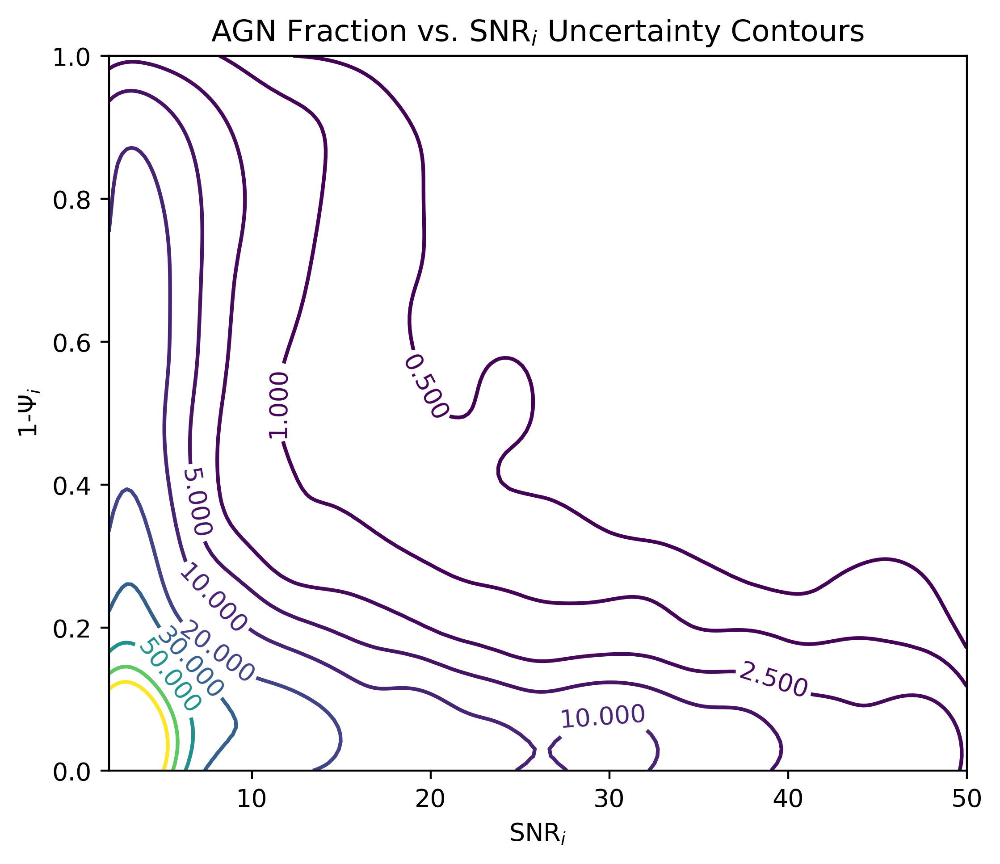

In [51]:

fig = plt.figure(figsize=(6,5), dpi=400)
left, bottom, width, height = 0.1, 0.1, 0.8, 0.8
ax = fig.add_axes([left, bottom, width, height]) 
cp = ax.contour(SNR_grid_new, 1.0 - psi_grid_new, matrix_test, levels =levelsAGN)
#ax.scatter(snMedian_i2, 1.0 - host_fraction_i_new2, color='C1', s=0.05)
ax.set_xlim([2,50])
ax.set_ylim([0,1.0])
ax.clabel(cp, inline=True, fontsize=10)
ax.set_title(r'AGN Fraction vs. SNR$_i$ Uncertainty Contours')
ax.set_xlabel(r'SNR$_i$')
ax.set_ylabel(r'1-$\Psi_i$')
plt.show()
fig.savefig('psi_AGN_vs_SNR_uncertainty_contours_smooth-test2.png')


In [52]:
bin_num = 80
max_range = 2.0
min_range = -2.0
max_range_gal = 1.0
min_range_gal = -1.0
sn_min = 8.0
sn_max = 11.0

good_sn_g1 = np.where((snMedian_g1_cut >= sn_min) & (snMedian_g1_cut <= sn_max))
good_sn_r1 = np.where((snMedian_r1_cut >= sn_min) & (snMedian_r1_cut <= sn_max))
good_sn_i1 = np.where((snMedian_i1_cut >= sn_min) & (snMedian_i1_cut <= sn_max))

good_sn_g2 = np.where((snMedian_g2_cut >= sn_min) & (snMedian_g2_cut <= sn_max))
good_sn_r2 = np.where((snMedian_r2_cut >= sn_min) & (snMedian_r2_cut <= sn_max))
good_sn_i2 = np.where((snMedian_i2_cut >= sn_min) & (snMedian_i2_cut <= sn_max))

delta_mag_agn_hist_g1 = np.histogram(mag_diff_g1_corrected[good_sn_g1], bins=bin_num, range=(min_range,max_range))
delta_mag_agn_hist_r1 = np.histogram(mag_diff_r1_corrected[good_sn_r1], bins=bin_num, range=(min_range,max_range))
delta_mag_agn_hist_i1 = np.histogram(mag_diff_i1_corrected[good_sn_i1], bins=bin_num, range=(min_range,max_range))

delta_mag_agn_hist_g2 = np.histogram(mag_diff_g2_corrected[good_sn_g2], bins=bin_num, range=(min_range,max_range))
delta_mag_agn_hist_r2 = np.histogram(mag_diff_r2_corrected[good_sn_r2], bins=bin_num, range=(min_range,max_range))
delta_mag_agn_hist_i2 = np.histogram(mag_diff_i2_corrected[good_sn_i2], bins=bin_num, range=(min_range,max_range))

xg1 = delta_mag_agn_hist_g1[1][0:bin_num] + (max_range - min_range)/(2.0*bin_num)
xr1 = delta_mag_agn_hist_r1[1][0:bin_num] + (max_range - min_range)/(2.0*bin_num)
xi1 = delta_mag_agn_hist_i1[1][0:bin_num] + (max_range - min_range)/(2.0*bin_num)
yg1 = delta_mag_agn_hist_g1[0][0:bin_num]
yr1 = delta_mag_agn_hist_r1[0][0:bin_num]
yi1 = delta_mag_agn_hist_i1[0][0:bin_num]

xg2 = delta_mag_agn_hist_g2[1][0:bin_num] + (max_range - min_range)/(2.0*bin_num)
xr2 = delta_mag_agn_hist_r2[1][0:bin_num] + (max_range - min_range)/(2.0*bin_num)
xi2 = delta_mag_agn_hist_i2[1][0:bin_num] + (max_range - min_range)/(2.0*bin_num)
yg2 = delta_mag_agn_hist_g2[0][0:bin_num]
yr2 = delta_mag_agn_hist_r2[0][0:bin_num]
yi2 = delta_mag_agn_hist_i2[0][0:bin_num]

popt_g1, pcov_g1 = curve_fit(gaussian_profile_fit,xg1,yg1)
popt_r1, pcov_r1 = curve_fit(gaussian_profile_fit,xr1,yr1)
popt_i1, pcov_i1 = curve_fit(gaussian_profile_fit,xi1,yi1)

popt_g2, pcov_g2 = curve_fit(gaussian_profile_fit,xg2,yg2)
popt_r2, pcov_r2 = curve_fit(gaussian_profile_fit,xr2,yr2)
popt_i2, pcov_i2 = curve_fit(gaussian_profile_fit,xi2,yi2)

#############################################################################################################################

good_sn_gal_g1 = np.where((snMedian_g1_gal >= sn_min) & (snMedian_g1_gal <= sn_max))
good_sn_gal_r1 = np.where((snMedian_r1_gal >= sn_min) & (snMedian_r1_gal <= sn_max))
good_sn_gal_i1 = np.where((snMedian_i1_gal >= sn_min) & (snMedian_i1_gal <= sn_max))

good_sn_gal_g2 = np.where((snMedian_g2_cut >= sn_min) & (snMedian_g2_cut <= sn_max))
good_sn_gal_r2 = np.where((snMedian_r2_cut >= sn_min) & (snMedian_r2_cut <= sn_max))
good_sn_gal_i2 = np.where((snMedian_i2_cut >= sn_min) & (snMedian_i2_cut <= sn_max))

delta_mag_gal_hist_g1 = np.histogram(mag_diff_gal_g1_corrected[good_sn_gal_g1], bins=bin_num, range=(min_range_gal,max_range_gal))
delta_mag_gal_hist_r1 = np.histogram(mag_diff_gal_r1_corrected[good_sn_gal_r1], bins=bin_num, range=(min_range_gal,max_range_gal))
delta_mag_gal_hist_i1 = np.histogram(mag_diff_gal_i1_corrected[good_sn_gal_i1], bins=bin_num, range=(min_range_gal,max_range_gal))

delta_mag_gal_hist_g2 = np.histogram(mag_diff_gal_g2_corrected[good_sn_gal_g2], bins=bin_num, range=(min_range_gal,max_range_gal))
delta_mag_gal_hist_r2 = np.histogram(mag_diff_gal_r2_corrected[good_sn_gal_r2], bins=bin_num, range=(min_range_gal,max_range_gal))
delta_mag_gal_hist_i2 = np.histogram(mag_diff_gal_i2_corrected[good_sn_gal_i2], bins=bin_num, range=(min_range_gal,max_range_gal))

xgal_g1 = delta_mag_gal_hist_g1[1][0:bin_num] + (max_range_gal - min_range_gal)/(2.0*bin_num)
xgal_r1 = delta_mag_gal_hist_r1[1][0:bin_num] + (max_range_gal - min_range_gal)/(2.0*bin_num)
xgal_i1 = delta_mag_gal_hist_i1[1][0:bin_num] + (max_range_gal - min_range_gal)/(2.0*bin_num)
ygal_g1 = delta_mag_gal_hist_g1[0][0:bin_num]
ygal_r1 = delta_mag_gal_hist_r1[0][0:bin_num]
ygal_i1 = delta_mag_gal_hist_i1[0][0:bin_num]

xgal_g2 = delta_mag_gal_hist_g2[1][0:bin_num] + (max_range_gal - min_range_gal)/(2.0*bin_num)
xgal_r2 = delta_mag_gal_hist_r2[1][0:bin_num] + (max_range_gal - min_range_gal)/(2.0*bin_num)
xgal_i2 = delta_mag_gal_hist_i2[1][0:bin_num] + (max_range_gal - min_range_gal)/(2.0*bin_num)
ygal_g2 = delta_mag_gal_hist_g2[0][0:bin_num]
ygal_r2 = delta_mag_gal_hist_r2[0][0:bin_num]
ygal_i2 = delta_mag_gal_hist_i2[0][0:bin_num]

popt_gal_g1, pcov_gal_g1 = curve_fit(gaussian_profile_fit,xgal_g1,ygal_g1)
popt_gal_r1, pcov_gal_r1 = curve_fit(gaussian_profile_fit,xgal_r1,ygal_r1)
popt_gal_i1, pcov_gal_i1 = curve_fit(gaussian_profile_fit,xgal_i1,ygal_i1)

popt_gal_g2, pcov_gal_g2 = curve_fit(gaussian_profile_fit,xgal_g2,ygal_g2)
popt_gal_r2, pcov_gal_r2 = curve_fit(gaussian_profile_fit,xgal_r2,ygal_r2)
popt_gal_i2, pcov_gal_i2 = curve_fit(gaussian_profile_fit,xgal_i2,ygal_i2)
#############################################################################################################################

[ 3.63642601e+04 -6.65738501e-02]
[1.85184029e+04 7.27239199e-02]
[1.37865719e+04 8.59895728e-02]


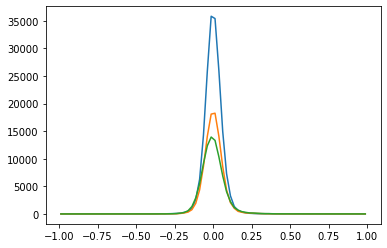

In [53]:
popt_gal_g1_reduced, pcov_gal_g1_reduced = curve_fit(gaussian_profile_fit_reduced,xgal_g1,ygal_g1)
popt_gal_r1_reduced, pcov_gal_r1_reduced = curve_fit(gaussian_profile_fit_reduced,xgal_r1,ygal_r1)
popt_gal_i1_reduced, pcov_gal_i1_reduced = curve_fit(gaussian_profile_fit_reduced,xgal_i1,ygal_i1)

popt_gal_g2_reduced, pcov_gal_g2_reduced = curve_fit(gaussian_profile_fit_reduced,xgal_g2,ygal_g2)
popt_gal_r2_reduced, pcov_gal_r2_reduced = curve_fit(gaussian_profile_fit_reduced,xgal_r2,ygal_r2)
popt_gal_i2_reduced, pcov_gal_i2_reduced = curve_fit(gaussian_profile_fit_reduced,xgal_i2,ygal_i2)

print(popt_gal_g1_reduced)
print(popt_gal_r1_reduced)
print(popt_gal_i1_reduced)

#print(popt_gal_i1)
#print(xgal_r1,ygal_r1)
plt.plot(xgal_g1,ygal_g1)
plt.plot(xgal_r1,ygal_r1)
plt.plot(xgal_i1,ygal_i1)


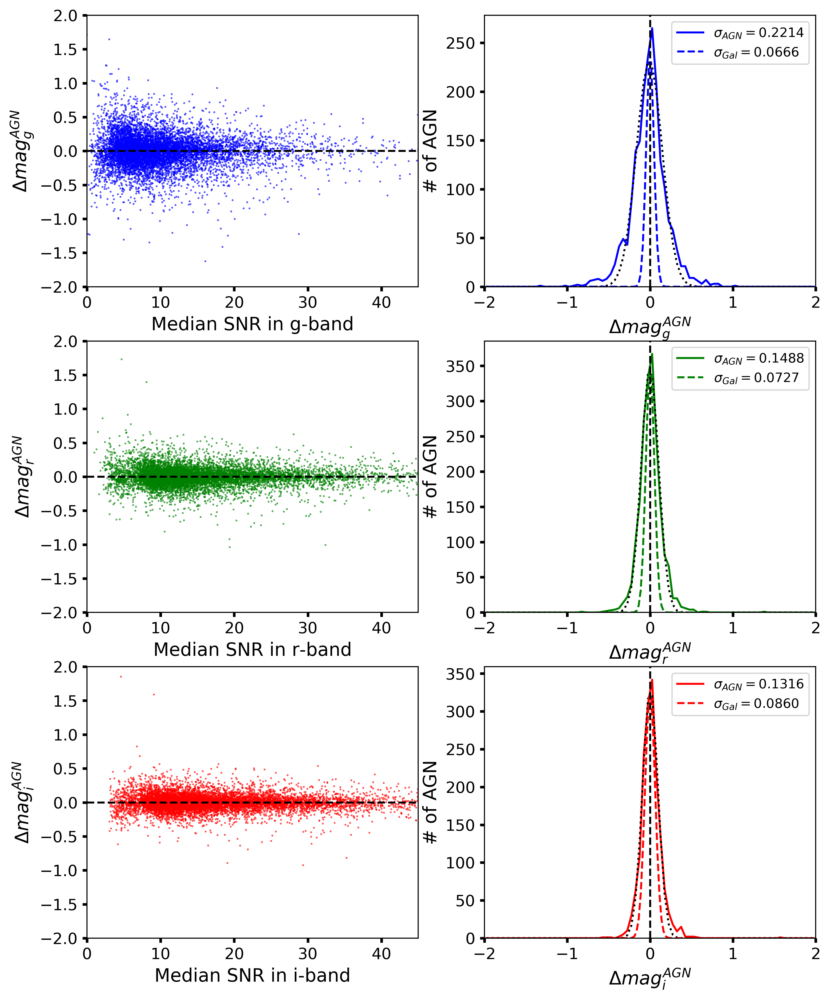

In [54]:
fig, ax = plt.subplots(3,2,figsize=(10,13),dpi=400)
ax[0,0].scatter(snMedian_g1_cut, mag_diff_g1_corrected, c='blue', marker='o', s=0.10)
ax[0,0].plot([0,70],[0,0], 'k--')
ax[0,0].set_xlim([-0.0,45])
ax[0,0].set_ylim([-2,2])
ax[0,0].xaxis.set_tick_params(labelsize=12, width=2)
ax[0,0].yaxis.set_tick_params(labelsize=12, width=2)
ax[0,0].set_xlabel('Median SNR in g-band', fontsize=14)
ax[0,0].set_ylabel(r'$\Delta mag^{AGN}_g$', fontsize=14)

ax[1,0].scatter(snMedian_r1_cut, mag_diff_r1_corrected, c='green', marker='o', s=0.10)
ax[1,0].plot([0,70],[0,0], 'k--')
ax[1,0].set_xlim([-0.0,45])
ax[1,0].set_ylim([-2,2])
ax[1,0].xaxis.set_tick_params(labelsize=12, width=2)
ax[1,0].yaxis.set_tick_params(labelsize=12, width=2)
ax[1,0].set_xlabel('Median SNR in r-band', fontsize=14)
ax[1,0].set_ylabel(r'$\Delta mag^{AGN}_r$', fontsize=14)

ax[2,0].scatter(snMedian_i1_cut, mag_diff_i1_corrected, c='red', marker='o', s=0.10)
ax[2,0].plot([0,70],[0,0], 'k--')
ax[2,0].set_xlim([-0.0,45])
ax[2,0].set_ylim([-2,2])
ax[2,0].xaxis.set_tick_params(labelsize=12, width=2)
ax[2,0].yaxis.set_tick_params(labelsize=12, width=2)
ax[2,0].set_xlabel('Median SNR in i-band', fontsize=14)
ax[2,0].set_ylabel(r'$\Delta mag^{AGN}_i$', fontsize=14)

ax[0,1].plot(xg1, yg1, color='blue', linestyle='-', label=r'$\sigma_{AGN} = %.4f $'%np.absolute(popt_g1[2]))
ax[0,1].plot(xg1, gaussian_profile_fit(xg1, popt_g1[0], popt_g1[1], popt_g1[2]), 'k:')
ax[0,1].plot(xgal_g1, gaussian_profile_fit_reduced(xgal_g1, popt_gal_g1_reduced[0], popt_gal_g1_reduced[1])*np.max(gaussian_profile_fit(xg1, popt_g1[0], popt_g1[1], popt_g1[2]))/np.max(gaussian_profile_fit_reduced(xgal_g1, popt_gal_g1_reduced[0], popt_gal_g1_reduced[1])), 'b--', label=r'$\sigma_{Gal} = %.4f $'%np.absolute(popt_gal_g1_reduced[1]))
ax[0,1].legend(loc='upper right', fontsize=10)
ax[0,1].plot([0,0],[0,1000], 'k--')
ax[0,1].set_xlim([min_range,max_range])
ax[0,1].set_ylim([0.0,1.05*np.max(yg1)])
ax[0,1].xaxis.set_tick_params(labelsize=12, width=2)
ax[0,1].yaxis.set_tick_params(labelsize=12, width=2)
ax[0,1].set_xlabel(r'$\Delta mag^{AGN}_g$', fontsize=14)
ax[0,1].set_ylabel('# of AGN', fontsize=14)

ax[1,1].plot(xr1, yr1, color='green', linestyle='-', label=r'$\sigma_{AGN} = %.4f $'%np.absolute(popt_r1[2]))
ax[1,1].plot(xr1, gaussian_profile_fit(xr1, popt_r1[0], popt_r1[1], popt_r1[2]), 'k:')
ax[1,1].plot(xgal_r1, gaussian_profile_fit_reduced(xgal_r1, popt_gal_r1_reduced[0], popt_gal_r1_reduced[1])*np.max(gaussian_profile_fit(xr1, popt_r1[0], popt_r1[1], popt_r1[2]))/np.max(gaussian_profile_fit_reduced(xgal_r1, popt_gal_r1_reduced[0], popt_gal_r1_reduced[1])), 'g--', label=r'$\sigma_{Gal} = %.4f $'%np.absolute(popt_gal_r1_reduced[1]))
ax[1,1].legend(loc='upper right', fontsize=10)
ax[1,1].plot([0,0],[0,1000], 'k--')
ax[1,1].set_xlim([min_range,max_range])
ax[1,1].set_ylim([0.0,1.05*np.max(yr1)])
ax[1,1].xaxis.set_tick_params(labelsize=12, width=2)
ax[1,1].yaxis.set_tick_params(labelsize=12, width=2)
ax[1,1].set_xlabel(r'$\Delta mag^{AGN}_r$', fontsize=14)
ax[1,1].set_ylabel('# of AGN', fontsize=14)

ax[2,1].plot(xi1, yi1, color='red', linestyle='-', label=r'$\sigma_{AGN} = %.4f $'%np.absolute(popt_i1[2]))
ax[2,1].plot(xi1, gaussian_profile_fit(xi1, popt_i1[0], popt_i1[1], popt_i1[2]), 'k:')
ax[2,1].plot(xgal_i1, gaussian_profile_fit_reduced(xgal_i1, popt_gal_i1_reduced[0], popt_gal_i1_reduced[1])*np.max(gaussian_profile_fit(xi1, popt_i1[0], popt_i1[1], popt_i1[2]))/np.max(gaussian_profile_fit_reduced(xgal_i1, popt_gal_i1_reduced[0], popt_gal_i1_reduced[1])), 'r--', label=r'$\sigma_{Gal} = %.4f $'%np.absolute(popt_gal_i1_reduced[1]))
ax[2,1].legend(loc='upper right', fontsize=10)
ax[2,1].plot([0,0],[0,1000], 'k--')
ax[2,1].set_xlim([min_range,max_range])
ax[2,1].set_ylim([0.0,1.05*np.max(yi1)])
ax[2,1].xaxis.set_tick_params(labelsize=12, width=2)
ax[2,1].yaxis.set_tick_params(labelsize=12, width=2)
ax[2,1].set_xlabel(r'$\Delta mag^{AGN}_i$', fontsize=14)
ax[2,1].set_ylabel('# of AGN', fontsize=14)
fig.savefig('AGN_mag_diff_distribution_by_SNR_set1.png') 

#############################################################################################################################

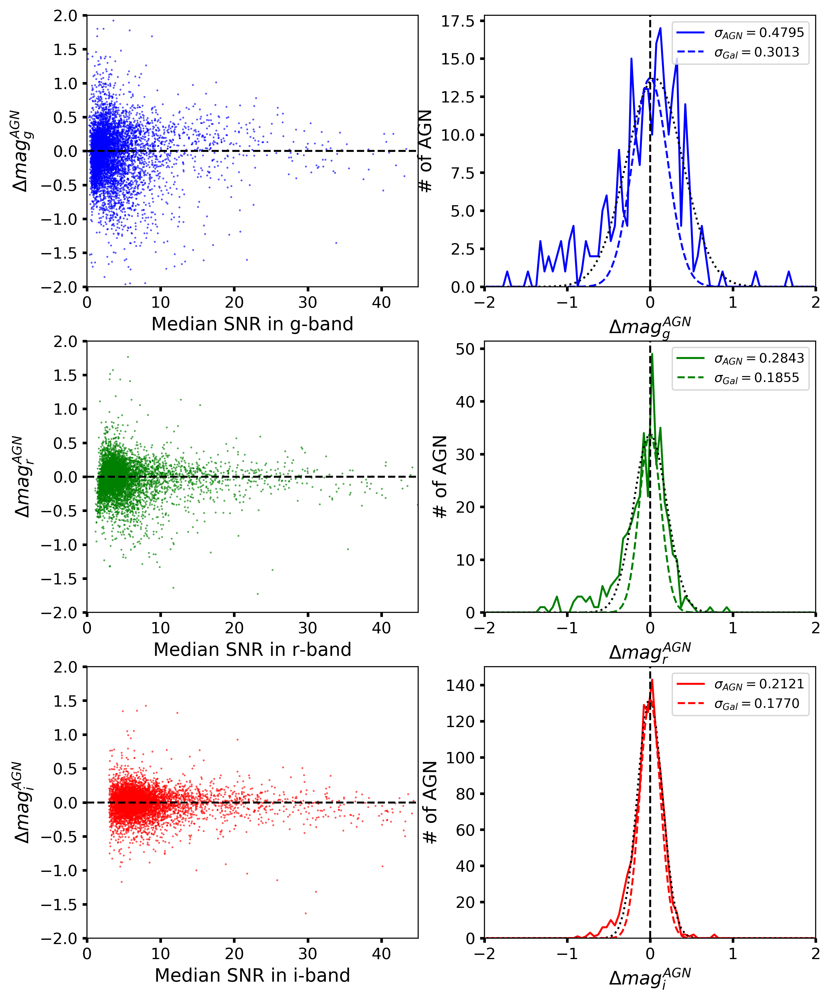

In [55]:
fig, ax = plt.subplots(3,2,figsize=(10,13),dpi=400)
ax[0,0].scatter(snMedian_g2_cut, mag_diff_g2_corrected, c='blue', marker='o', s=0.10)
ax[0,0].plot([0,70],[0,0], 'k--')
ax[0,0].set_xlim([-0.0,45])
ax[0,0].set_ylim([-2,2])
ax[0,0].xaxis.set_tick_params(labelsize=12, width=2)
ax[0,0].yaxis.set_tick_params(labelsize=12, width=2)
ax[0,0].set_xlabel('Median SNR in g-band', fontsize=14)
ax[0,0].set_ylabel(r'$\Delta mag^{AGN}_g$', fontsize=14)

ax[1,0].scatter(snMedian_r2_cut, mag_diff_r2_corrected, c='green', marker='o', s=0.10)
ax[1,0].plot([0,70],[0,0], 'k--')
ax[1,0].set_xlim([-0.0,45])
ax[1,0].set_ylim([-2,2])
ax[1,0].xaxis.set_tick_params(labelsize=12, width=2)
ax[1,0].yaxis.set_tick_params(labelsize=12, width=2)
ax[1,0].set_xlabel('Median SNR in r-band', fontsize=14)
ax[1,0].set_ylabel(r'$\Delta mag^{AGN}_r$', fontsize=14)

ax[2,0].scatter(snMedian_i2_cut, mag_diff_i2_corrected, c='red', marker='o', s=0.10)
ax[2,0].plot([0,70],[0,0], 'k--')
ax[2,0].set_xlim([-0.0,45])
ax[2,0].set_ylim([-2,2])
ax[2,0].xaxis.set_tick_params(labelsize=12, width=2)
ax[2,0].yaxis.set_tick_params(labelsize=12, width=2)
ax[2,0].set_xlabel('Median SNR in i-band', fontsize=14)
ax[2,0].set_ylabel(r'$\Delta mag^{AGN}_i$', fontsize=14)

ax[0,1].plot(xg2, yg2, color='blue', linestyle='-', label=r'$\sigma_{AGN} = %.4f $'%np.absolute(popt_g2[2]))
ax[0,1].plot(xg2, gaussian_profile_fit(xg2, popt_g2[0], popt_g2[1], popt_g2[2]), 'k:')
ax[0,1].plot(xgal_g2, gaussian_profile_fit_reduced(xgal_g2, popt_gal_g2_reduced[0], popt_gal_g2_reduced[1])*np.max(gaussian_profile_fit(xg2, popt_g2[0], popt_g2[1], popt_g2[2]))/np.max(gaussian_profile_fit_reduced(xgal_g2, popt_gal_g2_reduced[0], popt_gal_g2_reduced[1])), 'b--', label=r'$\sigma_{Gal} = %.4f $'%np.absolute(popt_gal_g2_reduced[1]))
ax[0,1].legend(loc='upper right', fontsize=10)
ax[0,1].plot([0,0],[0,1000], 'k--')
ax[0,1].set_xlim([min_range,max_range])
ax[0,1].set_ylim([0.0,1.05*np.max(yg2)])
ax[0,1].xaxis.set_tick_params(labelsize=12, width=2)
ax[0,1].yaxis.set_tick_params(labelsize=12, width=2)
ax[0,1].set_xlabel(r'$\Delta mag^{AGN}_g$', fontsize=14)
ax[0,1].set_ylabel('# of AGN', fontsize=14)

ax[1,1].plot(xr2, yr2, color='green', linestyle='-', label=r'$\sigma_{AGN} = %.4f $'%np.absolute(popt_r2[2]))
ax[1,1].plot(xr2, gaussian_profile_fit(xr2, popt_r2[0], popt_r2[1], popt_r2[2]), 'k:')
ax[1,1].plot(xgal_r2, gaussian_profile_fit_reduced(xgal_r2, popt_gal_r2_reduced[0], popt_gal_r2_reduced[1])*np.max(gaussian_profile_fit(xr2, popt_r2[0], popt_r2[1], popt_r2[2]))/np.max(gaussian_profile_fit_reduced(xgal_r2, popt_gal_r2_reduced[0], popt_gal_r2_reduced[1])), 'g--', label=r'$\sigma_{Gal} = %.4f $'%np.absolute(popt_gal_r2_reduced[1]))
ax[1,1].legend(loc='upper right', fontsize=10)
ax[1,1].plot([0,0],[0,1000], 'k--')
ax[1,1].set_xlim([min_range,max_range])
ax[1,1].set_ylim([0.0,1.05*np.max(yr2)])
ax[1,1].xaxis.set_tick_params(labelsize=12, width=2)
ax[1,1].yaxis.set_tick_params(labelsize=12, width=2)
ax[1,1].set_xlabel(r'$\Delta mag^{AGN}_r$', fontsize=14)
ax[1,1].set_ylabel('# of AGN', fontsize=14)

ax[2,1].plot(xi2, yi2, color='red', linestyle='-', label=r'$\sigma_{AGN} = %.4f $'%np.absolute(popt_i2[2]))
ax[2,1].plot(xi2, gaussian_profile_fit(xi2, popt_i2[0], popt_i2[1], popt_i2[2]), 'k:')
ax[2,1].plot(xgal_i2, gaussian_profile_fit_reduced(xgal_i2, popt_gal_i2_reduced[0], popt_gal_i2_reduced[1])*np.max(gaussian_profile_fit(xi2, popt_i2[0], popt_i2[1], popt_i2[2]))/np.max(gaussian_profile_fit_reduced(xgal_i2, popt_gal_i2_reduced[0], popt_gal_i2_reduced[1])), 'r--', label=r'$\sigma_{Gal} = %.4f $'%np.absolute(popt_gal_i2_reduced[1]))
ax[2,1].legend(loc='upper right', fontsize=10)
ax[2,1].plot([0,0],[0,1000], 'k--')
ax[2,1].set_xlim([min_range,max_range])
ax[2,1].set_ylim([0.0,1.05*np.max(yi2)])
ax[2,1].xaxis.set_tick_params(labelsize=12, width=2)
ax[2,1].yaxis.set_tick_params(labelsize=12, width=2)
ax[2,1].set_xlabel(r'$\Delta mag^{AGN}_i$', fontsize=14)
ax[2,1].set_ylabel('# of AGN', fontsize=14)
fig.savefig('AGN_mag_diff_distribution_by_SNR_set2.png') 

##########################################################################################################################################################################################################################

In [56]:
spectro_photo_flux_ratio_g1_prior = 10.0**(mag_diff_g1_corrected/-2.5)
spectro_photo_flux_ratio_r1_prior = 10.0**(mag_diff_r1_corrected/-2.5)
spectro_photo_flux_ratio_i1_prior = 10.0**(mag_diff_i1_corrected/-2.5)
spectro_photo_flux_ratio_g2_prior = 10.0**(mag_diff_g2_corrected/-2.5)
spectro_photo_flux_ratio_r2_prior = 10.0**(mag_diff_r2_corrected/-2.5)
spectro_photo_flux_ratio_i2_prior = 10.0**(mag_diff_i2_corrected/-2.5)

kval_g1_prior = -0.2*mag_diff_g1_corrected 
kval_r1_prior = -0.2*mag_diff_r1_corrected 
kval_i1_prior = -0.2*mag_diff_i1_corrected 
kval_g2_prior = -0.2*mag_diff_g2_corrected 
kval_r2_prior = -0.2*mag_diff_r2_corrected 
kval_i2_prior = -0.2*mag_diff_i2_corrected 

flux_fraction_correction_g1 = (1.0 - host_fraction_g1_cut)*(10.0**kval_g1_prior - host_fraction_g1_cut*spectro_photo_flux_ratio_g1_prior)/\
    ((1.0 - host_fraction_g1_cut*spectro_photo_flux_ratio_g1_prior)*(10.0**(-1.0*kval_g1_prior) - host_fraction_g1_cut))

flux_fraction_correction_g2 = (1.0 - host_fraction_g2_cut)*(10.0**kval_g2_prior - host_fraction_g2_cut*spectro_photo_flux_ratio_g2_prior)/\
    ((1.0 - host_fraction_g2_cut*spectro_photo_flux_ratio_g2_prior)*(10.0**(-1.0*kval_g2_prior) - host_fraction_g2_cut))

flux_fraction_correction_r1 = (1.0 - host_fraction_r1_cut)*(10.0**kval_r1_prior - host_fraction_r1_cut*spectro_photo_flux_ratio_r1_prior)/\
    ((1.0 - host_fraction_r1_cut*spectro_photo_flux_ratio_r1_prior)*(10.0**(-1.0*kval_r1_prior) - host_fraction_r1_cut))

flux_fraction_correction_r2 = (1.0 - host_fraction_r2_cut)*(10.0**kval_r2_prior - host_fraction_r2_cut*spectro_photo_flux_ratio_r2_prior)/\
    ((1.0 - host_fraction_r2_cut*spectro_photo_flux_ratio_r2_prior)*(10.0**(-1.0*kval_r2_prior) - host_fraction_r2_cut))
                            
flux_fraction_correction_i1 = (1.0 - host_fraction_i1_cut)*(10.0**kval_i1_prior - host_fraction_i1_cut*spectro_photo_flux_ratio_i1_prior)/\
    ((1.0 - host_fraction_i1_cut*spectro_photo_flux_ratio_i1_prior)*(10.0**(-1.0*kval_i1_prior) - host_fraction_i1_cut))

flux_fraction_correction_i2 = (1.0 - host_fraction_i2_cut)*(10.0**kval_i2_prior - host_fraction_i2_cut*spectro_photo_flux_ratio_i2_prior)/\
    ((1.0 - host_fraction_i2_cut*spectro_photo_flux_ratio_i2_prior)*(10.0**(-1.0*kval_i2_prior) - host_fraction_i2_cut))

contour_cut_i1 = np.where((psi_deviation_i1_cut <= 5.0) & (host_fraction_i1_cut >= 0.0) 
                          & (flux_fraction_correction_g1 > 0.0) & (flux_fraction_correction_r1 > 0.0) & (flux_fraction_correction_i1 > 0.0))
contour_cut_i2 = np.where((psi_deviation_i2_cut <= 5.0) & (host_fraction_i2_cut >= 0.0)
                          & (flux_fraction_correction_g2 > 0.0) & (flux_fraction_correction_r2 > 0.0) & (flux_fraction_correction_i2 > 0.0))


In [57]:
#plt.hist(spectro_photo_flux_ratio_g1_prior, bins=100)
#plt.hist(spectro_photo_flux_ratio_r1_prior, bins=100)
#plt.hist(mag_diff_i1_corrected, bins=100)
print(np.min(mag_diff_i1_corrected), np.max(mag_diff_i1_corrected), np.median(mag_diff_i1_corrected))
print(mag_diff_i1_corrected)
print(len(np.where((mag_diff_i1_corrected > -1.5) & (mag_diff_i1_corrected < 1.5) )[0]))
print(len(mag_diff_i1_corrected))



#plt.hist(spectro_photo_flux_ratio_g2_prior, bins=100)
#plt.hist(spectro_photo_flux_ratio_r2_prior, bins=100)
#plt.hist(spectro_photo_flux_ratio_i2_prior, bins=100)

-0.9244785758150641 1.856626468041272 -0.0007713595728744138
[ 0.15278066  0.0159793  -0.00155116 ... -0.11140236 -0.05890269
 -0.02202471]
9112
9114


In [58]:
#plt.hist(mag_diff_i1_corrected, bins=500)

In [59]:
objid1_cut_cont  = objid1_cut[contour_cut_i1]
ra1_cut_cont     = ra1_cut[contour_cut_i1]
dec1_cut_cont    = dec1_cut[contour_cut_i1]
umag1_cut_cont   = umag1_cut[contour_cut_i1]
err_u1_cut_cont  = err_u1_cut[contour_cut_i1]
gmag1_cut_cont   = gmag1_cut[contour_cut_i1]
err_g1_cut_cont  = err_g1_cut[contour_cut_i1]
rmag1_cut_cont   = rmag1_cut[contour_cut_i1]
err_r1_cut_cont  = err_r1_cut[contour_cut_i1]
imag1_cut_cont   = imag1_cut[contour_cut_i1]
err_i1_cut_cont  = err_i1_cut[contour_cut_i1]
zmag1_cut_cont   = zmag1_cut[contour_cut_i1]
err_z1_cut_cont  = err_z1_cut[contour_cut_i1]
plate1_cut_cont  = plate1_cut[contour_cut_i1]
fiberid1_cut_cont    = fiberid1_cut[contour_cut_i1]
redshift1_cut_cont   = redshift1_cut[contour_cut_i1]
snMedian1_cut_cont   = snMedian1_cut[contour_cut_i1]
snMedian_u1_cut_cont = snMedian_u1_cut[contour_cut_i1]
snMedian_g1_cut_cont = snMedian_g1_cut[contour_cut_i1]
snMedian_r1_cut_cont = snMedian_r1_cut[contour_cut_i1]
snMedian_i1_cut_cont = snMedian_i1_cut[contour_cut_i1]
snMedian_z1_cut_cont = snMedian_z1_cut[contour_cut_i1]
mjd_plate1_cut_cont  = mjd_plate1_cut[contour_cut_i1]
mjd_phot1_cut_cont   = mjd_phot1_cut[contour_cut_i1]
mjd_u1_cut_cont = mjd_u1_cut[contour_cut_i1]
mjd_g1_cut_cont = mjd_g1_cut[contour_cut_i1]
mjd_r1_cut_cont = mjd_r1_cut[contour_cut_i1]
mjd_i1_cut_cont = mjd_i1_cut[contour_cut_i1]
mjd_z1_cut_cont = mjd_z1_cut[contour_cut_i1]
fiberMag_u1_cut_cont     = fiberMag_u1_cut[contour_cut_i1]
fiberMagErr_u1_cut_cont  = fiberMagErr_u1_cut[contour_cut_i1]
fiberMag_g1_cut_cont     = fiberMag_g1_cut[contour_cut_i1]
fiberMagErr_g1_cut_cont  = fiberMagErr_g1_cut[contour_cut_i1]
fiberMag_r1_cut_cont     = fiberMag_r1_cut[contour_cut_i1]
fiberMagErr_r1_cut_cont  = fiberMagErr_r1_cut[contour_cut_i1]
fiberMag_i1_cut_cont     = fiberMag_i1_cut[contour_cut_i1]
fiberMagErr_i1_cut_cont  = fiberMagErr_i1_cut[contour_cut_i1]
fiberMag_z1_cut_cont     = fiberMag_z1_cut[contour_cut_i1]
fiberMagErr_z1_cut_cont  = fiberMagErr_z1_cut[contour_cut_i1]
fiberFlux_u1_cut_cont    = fiberFlux_u1_cut[contour_cut_i1]
fiberFluxIvar_u1_cut_cont = fiberFluxIvar_u1_cut[contour_cut_i1]
fiberFlux_g1_cut_cont     = fiberFlux_g1_cut[contour_cut_i1]
fiberFluxIvar_g1_cut_cont = fiberFluxIvar_g1_cut[contour_cut_i1]
fiberFlux_r1_cut_cont     = fiberFlux_r1_cut[contour_cut_i1]
fiberFluxIvar_r1_cut_cont = fiberFluxIvar_r1_cut[contour_cut_i1]
fiberFlux_i1_cut_cont     = fiberFlux_i1_cut[contour_cut_i1]
fiberFluxIvar_i1_cut_cont = fiberFluxIvar_i1_cut[contour_cut_i1]
fiberFlux_z1_cut_cont     = fiberFlux_z1_cut[contour_cut_i1]
fiberFluxIvar_z1_cut_cont = fiberFluxIvar_z1_cut[contour_cut_i1]
spectroFlux_u1_cut_cont   = spectroFlux_u1_cut[contour_cut_i1]
spectroFluxIvar_u1_cut_cont = spectroFluxIvar_u1_cut[contour_cut_i1]
spectroFlux_g1_cut_cont     = spectroFlux_g1_cut[contour_cut_i1]
spectroFluxIvar_g1_cut_cont = spectroFluxIvar_g1_cut[contour_cut_i1]
spectroFlux_r1_cut_cont     = spectroFlux_r1_cut[contour_cut_i1]
spectroFluxIvar_r1_cut_cont = spectroFluxIvar_r1_cut[contour_cut_i1]
spectroFlux_i1_cut_cont     = spectroFlux_i1_cut[contour_cut_i1]
spectroFluxIvar_i1_cut_cont = spectroFluxIvar_i1_cut[contour_cut_i1]
spectroFlux_z1_cut_cont     = spectroFlux_z1_cut[contour_cut_i1]
spectroFluxIvar_z1_cut_cont = spectroFluxIvar_z1_cut[contour_cut_i1]
an11_cut_cont = an11_cut[contour_cut_i1]
an21_cut_cont = an21_cut[contour_cut_i1]
an31_cut_cont = an31_cut[contour_cut_i1]
an41_cut_cont = an41_cut[contour_cut_i1]
an51_cut_cont = an51_cut[contour_cut_i1]
an61_cut_cont = an61_cut[contour_cut_i1]
an71_cut_cont = an71_cut[contour_cut_i1]
an81_cut_cont = an81_cut[contour_cut_i1]
an91_cut_cont = an91_cut[contour_cut_i1]
an101_cut_cont = an101_cut[contour_cut_i1]
gn11_cut_cont = gn11_cut[contour_cut_i1]
gn21_cut_cont = gn21_cut[contour_cut_i1]
gn31_cut_cont = gn31_cut[contour_cut_i1]
gn41_cut_cont = gn41_cut[contour_cut_i1]
gn51_cut_cont = gn51_cut[contour_cut_i1]
kcorr_u1_cut_cont = kcorr_u1_cut[contour_cut_i1]
kcorr_g1_cut_cont = kcorr_g1_cut[contour_cut_i1]
kcorr_r1_cut_cont = kcorr_r1_cut[contour_cut_i1]
kcorr_i1_cut_cont = kcorr_i1_cut[contour_cut_i1]
kcorr_z1_cut_cont = kcorr_z1_cut[contour_cut_i1]
absmag_u1_cut_cont = absmag_u1_cut[contour_cut_i1]
absmag_g1_cut_cont = absmag_g1_cut[contour_cut_i1]
absmag_r1_cut_cont = absmag_r1_cut[contour_cut_i1]
absmag_i1_cut_cont = absmag_i1_cut[contour_cut_i1]
absmag_z1_cut_cont = absmag_z1_cut[contour_cut_i1]
extc_u1_cut_cont = extc_u1_cut[contour_cut_i1]
extc_g1_cut_cont = extc_g1_cut[contour_cut_i1]
extc_r1_cut_cont = extc_r1_cut[contour_cut_i1]
extc_i1_cut_cont = extc_i1_cut[contour_cut_i1]
extc_z1_cut_cont = extc_z1_cut[contour_cut_i1]
sigma_ha1_cut_cont       = sigma_ha1_cut[contour_cut_i1]
sigma_ha_err1_cut_cont   = sigma_ha_err1_cut[contour_cut_i1]
sigma_hb1_cut_cont       = sigma_hb1_cut[contour_cut_i1]
sigma_hb_err1_cut_cont   = sigma_hb_err1_cut[contour_cut_i1]
sigma_best1_cut_cont     = sigma_best1_cut[contour_cut_i1]
sigma_best_err1_cut_cont = sigma_best_err1_cut[contour_cut_i1]
sigma_ha_archive1_cut_cont       = sigma_ha_archive1_cut[contour_cut_i1]
sigma_ha_archive_err1_cut_cont   = sigma_ha_archive_err1_cut[contour_cut_i1]
sigma_hb_archive1_cut_cont       = sigma_hb_archive1_cut[contour_cut_i1]
sigma_hb_archive_err1_cut_cont   = sigma_hb_archive_err1_cut[contour_cut_i1]
peak_ha1_cut_cont        = peak_ha1_cut[contour_cut_i1]
peak_ha_err1_cut_cont    = peak_ha_err1_cut[contour_cut_i1]
peak_hb1_cut_cont        = peak_hb1_cut[contour_cut_i1]
peak_hb_err1_cut_cont    = peak_hb_err1_cut[contour_cut_i1]
line_flux_ha1_cut_cont   = line_flux_ha1_cut[contour_cut_i1]
line_flux_ha_err1_cut_cont = line_flux_ha_err1_cut[contour_cut_i1]
line_flux_hb1_cut_cont     = line_flux_hb1_cut[contour_cut_i1]
line_flux_hb_err1_cut_cont = line_flux_hb_err1_cut[contour_cut_i1]
fwhm_kms1_cut_cont         = fwhm_kms1_cut[contour_cut_i1]
fwhm_kms_err1_cut_cont     = fwhm_kms_err1_cut[contour_cut_i1]
z_fit_ha1_cut_cont         = z_fit_ha1_cut[contour_cut_i1]
z_fit_hb1_cut_cont         = z_fit_hb1_cut[contour_cut_i1]
z_fit_best1_cut_cont       = z_fit_best1_cut[contour_cut_i1]
z_agn1_cut_cont            = z_agn1_cut[contour_cut_i1]
z_agn_err1_cut_cont        = z_agn_err1_cut[contour_cut_i1]
line_flux_ha_archive1_cut_cont       = line_flux_ha_archive1_cut[contour_cut_i1]
line_flux_ha_archive_err1_cut_cont   = line_flux_ha_archive_err1_cut[contour_cut_i1]
line_flux_hb_archive1_cut_cont       = line_flux_hb_archive1_cut[contour_cut_i1]
line_flux_hb_archive_err1_cut_cont   = line_flux_hb_archive_err1_cut[contour_cut_i1]
kcor_krc_g1_cut_cont = kcor_krc_g1_cut[contour_cut_i1]
kcor_krc_r1_cut_cont = kcor_krc_r1_cut[contour_cut_i1]
kcor_krc_i1_cut_cont = kcor_krc_i1_cut[contour_cut_i1]
g_abs1_cut_cont      = g_abs1_cut[contour_cut_i1]
r_abs1_cut_cont      = r_abs1_cut[contour_cut_i1]
i_abs1_cut_cont      = i_abs1_cut[contour_cut_i1]
mag_abs_agn_i1_cut_cont              = mag_abs_agn_i1_cut[contour_cut_i1]
delta_mag_agn_corrected_g1_cut_cont  = delta_mag_agn_corrected_g1_cut[contour_cut_i1]
delta_mag_agn_corrected_r1_cut_cont  = delta_mag_agn_corrected_r1_cut[contour_cut_i1]
delta_mag_agn_corrected_i1_cut_cont  = delta_mag_agn_corrected_i1_cut[contour_cut_i1]
sigma_phot_g1_cut_cont               = sigma_phot_g1_cut[contour_cut_i1]
sigma_phot_r1_cut_cont               = sigma_phot_r1_cut[contour_cut_i1]
sigma_phot_i1_cut_cont               = sigma_phot_i1_cut[contour_cut_i1]
lambdaL5100_agn1_cut_cont            = lambdaL5100_agn1_cut[contour_cut_i1]

Luminosity_B_AGN1_cut_cont          = Luminosity_B_AGN1_cut[contour_cut_i1]
Luminosity_B_AGN_PSP1_cut_cont      = Luminosity_B_AGN_PSP1_cut[contour_cut_i1]
absmag_B_AGN1_cut_cont              = absmag_B_AGN1_cut[contour_cut_i1]
absmag_B_AGN_PSP1_cut_cont          = absmag_B_AGN_PSP1_cut[contour_cut_i1]

M_BH_51001_cut_cont                  = M_BH_51001_cut[contour_cut_i1]
host_fraction_g1_cut_cont            = host_fraction_g1_cut[contour_cut_i1]
host_fraction_r1_cut_cont            = host_fraction_r1_cut[contour_cut_i1]
host_fraction_i1_cut_cont            = host_fraction_i1_cut[contour_cut_i1]
psi_deviation_g1_cut_cont            = psi_deviation_g1_cut[contour_cut_i1]
psi_deviation_r1_cut_cont            = psi_deviation_r1_cut[contour_cut_i1]
psi_deviation_i1_cut_cont            = psi_deviation_i1_cut[contour_cut_i1]
mag_diff_g1_corrected_cont    = mag_diff_g1_corrected[contour_cut_i1]
mag_diff_r1_corrected_cont    = mag_diff_r1_corrected[contour_cut_i1]
mag_diff_i1_corrected_cont    = mag_diff_i1_corrected[contour_cut_i1]
           
######################################################################################################################################################################


In [60]:
objid2_cut_cont  = objid2_cut[contour_cut_i2]
ra2_cut_cont     = ra2_cut[contour_cut_i2]
dec2_cut_cont    = dec2_cut[contour_cut_i2]
umag2_cut_cont   = umag2_cut[contour_cut_i2]
err_u2_cut_cont  = err_u2_cut[contour_cut_i2]
gmag2_cut_cont   = gmag2_cut[contour_cut_i2]
err_g2_cut_cont  = err_g2_cut[contour_cut_i2]
rmag2_cut_cont   = rmag2_cut[contour_cut_i2]
err_r2_cut_cont  = err_r2_cut[contour_cut_i2]
imag2_cut_cont   = imag2_cut[contour_cut_i2]
err_i2_cut_cont  = err_i2_cut[contour_cut_i2]
zmag2_cut_cont   = zmag2_cut[contour_cut_i2]
err_z2_cut_cont  = err_z2_cut[contour_cut_i2]
plate2_cut_cont  = plate2_cut[contour_cut_i2]
fiberid2_cut_cont    = fiberid2_cut[contour_cut_i2]
redshift2_cut_cont   = redshift2_cut[contour_cut_i2]
snMedian2_cut_cont   = snMedian2_cut[contour_cut_i2]
snMedian_u2_cut_cont = snMedian_u2_cut[contour_cut_i2]
snMedian_g2_cut_cont = snMedian_g2_cut[contour_cut_i2]
snMedian_r2_cut_cont = snMedian_r2_cut[contour_cut_i2]
snMedian_i2_cut_cont = snMedian_i2_cut[contour_cut_i2]
snMedian_z2_cut_cont = snMedian_z2_cut[contour_cut_i2]
mjd_plate2_cut_cont  = mjd_plate2_cut[contour_cut_i2]
mjd_phot2_cut_cont   = mjd_phot2_cut[contour_cut_i2]
mjd_u2_cut_cont = mjd_u2_cut[contour_cut_i2]
mjd_g2_cut_cont = mjd_g2_cut[contour_cut_i2]
mjd_r2_cut_cont = mjd_r2_cut[contour_cut_i2]
mjd_i2_cut_cont = mjd_i2_cut[contour_cut_i2]
mjd_z2_cut_cont = mjd_z2_cut[contour_cut_i2]
fiberMag_u2_cut_cont     = fiberMag_u2_cut[contour_cut_i2]
fiberMagErr_u2_cut_cont  = fiberMagErr_u2_cut[contour_cut_i2]
fiberMag_g2_cut_cont     = fiberMag_g2_cut[contour_cut_i2]
fiberMagErr_g2_cut_cont  = fiberMagErr_g2_cut[contour_cut_i2]
fiberMag_r2_cut_cont     = fiberMag_r2_cut[contour_cut_i2]
fiberMagErr_r2_cut_cont  = fiberMagErr_r2_cut[contour_cut_i2]
fiberMag_i2_cut_cont     = fiberMag_i2_cut[contour_cut_i2]
fiberMagErr_i2_cut_cont  = fiberMagErr_i2_cut[contour_cut_i2]
fiberMag_z2_cut_cont     = fiberMag_z2_cut[contour_cut_i2]
fiberMagErr_z2_cut_cont  = fiberMagErr_z2_cut[contour_cut_i2]
fiberFlux_u2_cut_cont    = fiberFlux_u2_cut[contour_cut_i2]
fiberFluxIvar_u2_cut_cont = fiberFluxIvar_u2_cut[contour_cut_i2]
fiberFlux_g2_cut_cont     = fiberFlux_g2_cut[contour_cut_i2]
fiberFluxIvar_g2_cut_cont = fiberFluxIvar_g2_cut[contour_cut_i2]
fiberFlux_r2_cut_cont     = fiberFlux_r2_cut[contour_cut_i2]
fiberFluxIvar_r2_cut_cont = fiberFluxIvar_r2_cut[contour_cut_i2]
fiberFlux_i2_cut_cont     = fiberFlux_i2_cut[contour_cut_i2]
fiberFluxIvar_i2_cut_cont = fiberFluxIvar_i2_cut[contour_cut_i2]
fiberFlux_z2_cut_cont     = fiberFlux_z2_cut[contour_cut_i2]
fiberFluxIvar_z2_cut_cont = fiberFluxIvar_z2_cut[contour_cut_i2]
spectroFlux_u2_cut_cont   = spectroFlux_u2_cut[contour_cut_i2]
spectroFluxIvar_u2_cut_cont = spectroFluxIvar_u2_cut[contour_cut_i2]
spectroFlux_g2_cut_cont     = spectroFlux_g2_cut[contour_cut_i2]
spectroFluxIvar_g2_cut_cont = spectroFluxIvar_g2_cut[contour_cut_i2]
spectroFlux_r2_cut_cont     = spectroFlux_r2_cut[contour_cut_i2]
spectroFluxIvar_r2_cut_cont = spectroFluxIvar_r2_cut[contour_cut_i2]
spectroFlux_i2_cut_cont     = spectroFlux_i2_cut[contour_cut_i2]
spectroFluxIvar_i2_cut_cont = spectroFluxIvar_i2_cut[contour_cut_i2]
spectroFlux_z2_cut_cont     = spectroFlux_z2_cut[contour_cut_i2]
spectroFluxIvar_z2_cut_cont = spectroFluxIvar_z2_cut[contour_cut_i2]
an12_cut_cont = an12_cut[contour_cut_i2]
an22_cut_cont = an22_cut[contour_cut_i2]
an32_cut_cont = an32_cut[contour_cut_i2]
an42_cut_cont = an42_cut[contour_cut_i2]
an52_cut_cont = an52_cut[contour_cut_i2]
an62_cut_cont = an62_cut[contour_cut_i2]
an72_cut_cont = an72_cut[contour_cut_i2]
an82_cut_cont = an82_cut[contour_cut_i2]
an92_cut_cont = an92_cut[contour_cut_i2]
an102_cut_cont = an102_cut[contour_cut_i2]
gn12_cut_cont = gn12_cut[contour_cut_i2]
gn22_cut_cont = gn22_cut[contour_cut_i2]
gn32_cut_cont = gn32_cut[contour_cut_i2]
gn42_cut_cont = gn42_cut[contour_cut_i2]
gn52_cut_cont = gn52_cut[contour_cut_i2]
kcorr_u2_cut_cont = kcorr_u2_cut[contour_cut_i2]
kcorr_g2_cut_cont = kcorr_g2_cut[contour_cut_i2]
kcorr_r2_cut_cont = kcorr_r2_cut[contour_cut_i2]
kcorr_i2_cut_cont = kcorr_i2_cut[contour_cut_i2]
kcorr_z2_cut_cont = kcorr_z2_cut[contour_cut_i2]
absmag_u2_cut_cont = absmag_u2_cut[contour_cut_i2]
absmag_g2_cut_cont = absmag_g2_cut[contour_cut_i2]
absmag_r2_cut_cont = absmag_r2_cut[contour_cut_i2]
absmag_i2_cut_cont = absmag_i2_cut[contour_cut_i2]
absmag_z2_cut_cont = absmag_z2_cut[contour_cut_i2]
extc_u2_cut_cont = extc_u2_cut[contour_cut_i2]
extc_g2_cut_cont = extc_g2_cut[contour_cut_i2]
extc_r2_cut_cont = extc_r2_cut[contour_cut_i2]
extc_i2_cut_cont = extc_i2_cut[contour_cut_i2]
extc_z2_cut_cont = extc_z2_cut[contour_cut_i2]
sigma_ha2_cut_cont       = sigma_ha2_cut[contour_cut_i2]
sigma_ha_err2_cut_cont   = sigma_ha_err2_cut[contour_cut_i2]
sigma_hb2_cut_cont       = sigma_hb2_cut[contour_cut_i2]
sigma_hb_err2_cut_cont   = sigma_hb_err2_cut[contour_cut_i2]
sigma_best2_cut_cont     = sigma_best2_cut[contour_cut_i2]
sigma_best_err2_cut_cont = sigma_best_err2_cut[contour_cut_i2]
sigma_ha_archive2_cut_cont       = sigma_ha_archive2_cut[contour_cut_i2]
sigma_ha_archive_err2_cut_cont   = sigma_ha_archive_err2_cut[contour_cut_i2]
sigma_hb_archive2_cut_cont       = sigma_hb_archive2_cut[contour_cut_i2]
sigma_hb_archive_err2_cut_cont   = sigma_hb_archive_err2_cut[contour_cut_i2]
peak_ha2_cut_cont        = peak_ha2_cut[contour_cut_i2]
peak_ha_err2_cut_cont    = peak_ha_err2_cut[contour_cut_i2]
peak_hb2_cut_cont        = peak_hb2_cut[contour_cut_i2]
peak_hb_err2_cut_cont    = peak_hb_err2_cut[contour_cut_i2]
line_flux_ha2_cut_cont   = line_flux_ha2_cut[contour_cut_i2]
line_flux_ha_err2_cut_cont = line_flux_ha_err2_cut[contour_cut_i2]
line_flux_hb2_cut_cont     = line_flux_hb2_cut[contour_cut_i2]
line_flux_hb_err2_cut_cont = line_flux_hb_err2_cut[contour_cut_i2]
fwhm_kms2_cut_cont         = fwhm_kms2_cut[contour_cut_i2]
fwhm_kms_err2_cut_cont     = fwhm_kms_err2_cut[contour_cut_i2]
z_fit_ha2_cut_cont         = z_fit_ha2_cut[contour_cut_i2]
z_fit_hb2_cut_cont         = z_fit_hb2_cut[contour_cut_i2]
z_fit_best2_cut_cont       = z_fit_best2_cut[contour_cut_i2]
z_agn2_cut_cont            = z_agn2_cut[contour_cut_i2]
z_agn_err2_cut_cont        = z_agn_err2_cut[contour_cut_i2]
line_flux_ha_archive2_cut_cont       = line_flux_ha_archive2_cut[contour_cut_i2]
line_flux_ha_archive_err2_cut_cont   = line_flux_ha_archive_err2_cut[contour_cut_i2]
line_flux_hb_archive2_cut_cont       = line_flux_hb_archive2_cut[contour_cut_i2]
line_flux_hb_archive_err2_cut_cont   = line_flux_hb_archive_err2_cut[contour_cut_i2]
kcor_krc_g2_cut_cont = kcor_krc_g2_cut[contour_cut_i2]
kcor_krc_r2_cut_cont = kcor_krc_r2_cut[contour_cut_i2]
kcor_krc_i2_cut_cont = kcor_krc_i2_cut[contour_cut_i2]
g_abs2_cut_cont      = g_abs2_cut[contour_cut_i2]
r_abs2_cut_cont      = r_abs2_cut[contour_cut_i2]
i_abs2_cut_cont      = i_abs2_cut[contour_cut_i2]
mag_abs_agn_i2_cut_cont              = mag_abs_agn_i2_cut[contour_cut_i2]
delta_mag_agn_corrected_g2_cut_cont  = delta_mag_agn_corrected_g2_cut[contour_cut_i2]
delta_mag_agn_corrected_r2_cut_cont  = delta_mag_agn_corrected_r2_cut[contour_cut_i2]
delta_mag_agn_corrected_i2_cut_cont  = delta_mag_agn_corrected_i2_cut[contour_cut_i2]
sigma_phot_g2_cut_cont               = sigma_phot_g2_cut[contour_cut_i2]
sigma_phot_r2_cut_cont               = sigma_phot_r2_cut[contour_cut_i2]
sigma_phot_i2_cut_cont               = sigma_phot_i2_cut[contour_cut_i2]
lambdaL5100_agn2_cut_cont            = lambdaL5100_agn2_cut[contour_cut_i2]

Luminosity_B_AGN2_cut_cont          = Luminosity_B_AGN2_cut[contour_cut_i2]
Luminosity_B_AGN_PSP2_cut_cont      = Luminosity_B_AGN_PSP2_cut[contour_cut_i2]
absmag_B_AGN2_cut_cont              = absmag_B_AGN2_cut[contour_cut_i2]
absmag_B_AGN_PSP2_cut_cont          = absmag_B_AGN_PSP2_cut[contour_cut_i2]

M_BH_51002_cut_cont                  = M_BH_51002_cut[contour_cut_i2]
host_fraction_g2_cut_cont            = host_fraction_g2_cut[contour_cut_i2]
host_fraction_r2_cut_cont            = host_fraction_r2_cut[contour_cut_i2]
host_fraction_i2_cut_cont            = host_fraction_i2_cut[contour_cut_i2]
psi_deviation_g2_cut_cont            = psi_deviation_g2_cut[contour_cut_i2]
psi_deviation_r2_cut_cont            = psi_deviation_r2_cut[contour_cut_i2]
psi_deviation_i2_cut_cont            = psi_deviation_i2_cut[contour_cut_i2]
mag_diff_g2_corrected_cont    = mag_diff_g2_corrected[contour_cut_i2]
mag_diff_r2_corrected_cont    = mag_diff_r2_corrected[contour_cut_i2]
mag_diff_i2_corrected_cont    = mag_diff_i2_corrected[contour_cut_i2]

##########################################################################################################################################################################################################################

0.6812615654118246
0.9154253582068757 0.1296862133492828
0.6416624158182735 0.09591990931885518 0.5755555555555555


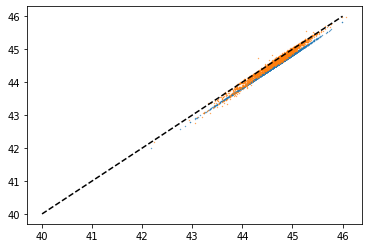

In [61]:
plt.scatter(np.log10(5.18*Luminosity_B_AGN2_cut_cont),np.log10(5.18*Luminosity_B_AGN_PSP2_cut_cont), s=0.1)
#plt.scatter(np.log10(9.0*lambdaL5100_agn2_cut_cont),np.log10(5.18*Luminosity_B_AGN_PSP2_cut_cont), s=0.1)
plt.scatter(np.log10(9.0*lambdaL5100_agn2_cut_cont),np.log10(5.18*Luminosity_B_AGN2_cut_cont), s=0.1)

plt.plot([40,46],[40,46],'k--')

print(np.average(Luminosity_B_AGN_PSP2_cut_cont/Luminosity_B_AGN2_cut_cont))
print(np.average((5.18*Luminosity_B_AGN2_cut_cont)/(9.0*lambdaL5100_agn2_cut_cont)), 
      np.std((5.18*Luminosity_B_AGN2_cut_cont)/(9.0*lambdaL5100_agn2_cut_cont)))
print(np.average(lambdaL5100_agn2_cut_cont/Luminosity_B_AGN2_cut_cont), np.std(lambdaL5100_agn2_cut_cont/Luminosity_B_AGN2_cut_cont), 5.18/9.0)

In [62]:
mag_tot_spec_g1_cut_cont = 22.5 - 2.5*np.log10(spectroFlux_g1_cut_cont)   # Epoch 1
mag_tot_spec_r1_cut_cont = 22.5 - 2.5*np.log10(spectroFlux_r1_cut_cont)
mag_tot_spec_i1_cut_cont = 22.5 - 2.5*np.log10(spectroFlux_i1_cut_cont)
mag_tot_spec_g2_cut_cont = 22.5 - 2.5*np.log10(spectroFlux_g2_cut_cont)   # Epoch 1
mag_tot_spec_r2_cut_cont = 22.5 - 2.5*np.log10(spectroFlux_r2_cut_cont)
mag_tot_spec_i2_cut_cont = 22.5 - 2.5*np.log10(spectroFlux_i2_cut_cont)

mag_tot_phot_g1_cut_cont = 22.5 - 2.5*np.log10(fiberFlux_g1_cut_cont)     # Epoch 2
mag_tot_phot_r1_cut_cont = 22.5 - 2.5*np.log10(fiberFlux_r1_cut_cont)
mag_tot_phot_i1_cut_cont = 22.5 - 2.5*np.log10(fiberFlux_i1_cut_cont)
mag_tot_phot_g2_cut_cont = 22.5 - 2.5*np.log10(fiberFlux_g2_cut_cont)     # Epoch 2
mag_tot_phot_r2_cut_cont = 22.5 - 2.5*np.log10(fiberFlux_r2_cut_cont)
mag_tot_phot_i2_cut_cont = 22.5 - 2.5*np.log10(fiberFlux_i2_cut_cont)

mag_agn_phot_g1_cut_cont = mag_tot_phot_g1_cut_cont - 2.5*np.log10(1.0 - host_fraction_g1_cut_cont)    #Need reviews ...
mag_agn_phot_r1_cut_cont = mag_tot_phot_r1_cut_cont - 2.5*np.log10(1.0 - host_fraction_r1_cut_cont)
mag_agn_phot_i1_cut_cont = mag_tot_phot_i1_cut_cont - 2.5*np.log10(1.0 - host_fraction_i1_cut_cont)
mag_agn_phot_g2_cut_cont = mag_tot_phot_g2_cut_cont - 2.5*np.log10(1.0 - host_fraction_g2_cut_cont)    #Need reviews ...
mag_agn_phot_r2_cut_cont = mag_tot_phot_r2_cut_cont - 2.5*np.log10(1.0 - host_fraction_r2_cut_cont)
mag_agn_phot_i2_cut_cont = mag_tot_phot_i2_cut_cont - 2.5*np.log10(1.0 - host_fraction_i2_cut_cont)

mag_agn_spec_g1_cut_cont = mag_tot_spec_g1_cut_cont - 2.5*np.log10(1.0 - host_fraction_g1_cut_cont)    #Need reviews ...
mag_agn_spec_r1_cut_cont = mag_tot_spec_r1_cut_cont - 2.5*np.log10(1.0 - host_fraction_r1_cut_cont)
mag_agn_spec_i1_cut_cont = mag_tot_spec_i1_cut_cont - 2.5*np.log10(1.0 - host_fraction_i1_cut_cont)
mag_agn_spec_g2_cut_cont = mag_tot_spec_g2_cut_cont - 2.5*np.log10(1.0 - host_fraction_g2_cut_cont)    #Need reviews ...
mag_agn_spec_r2_cut_cont = mag_tot_spec_r2_cut_cont - 2.5*np.log10(1.0 - host_fraction_r2_cut_cont)
mag_agn_spec_i2_cut_cont = mag_tot_spec_i2_cut_cont - 2.5*np.log10(1.0 - host_fraction_i2_cut_cont)


In [63]:
#plt.hist(fiberFlux_g1_cut_cont, bins=100)

In [64]:
mag_tot_spec_g1_cut = 22.5 - 2.5*np.log10(spectroFlux_g1_cut)   # Epoch 1
mag_tot_spec_r1_cut = 22.5 - 2.5*np.log10(spectroFlux_r1_cut)
mag_tot_spec_i1_cut = 22.5 - 2.5*np.log10(spectroFlux_i1_cut)
mag_tot_spec_g2_cut = 22.5 - 2.5*np.log10(spectroFlux_g2_cut)   # Epoch 2
mag_tot_spec_r2_cut = 22.5 - 2.5*np.log10(spectroFlux_r2_cut)
mag_tot_spec_i2_cut = 22.5 - 2.5*np.log10(spectroFlux_i2_cut)
mag_agn_spec_g1_cut = mag_tot_spec_g1_cut - 2.5*np.log10(1.0 - host_fraction_g1_cut)    #Need reviews ...
mag_agn_spec_r1_cut = mag_tot_spec_r1_cut - 2.5*np.log10(1.0 - host_fraction_r1_cut)
mag_agn_spec_i1_cut = mag_tot_spec_i1_cut - 2.5*np.log10(1.0 - host_fraction_i1_cut)
mag_agn_spec_g2_cut = mag_tot_spec_g2_cut - 2.5*np.log10(1.0 - host_fraction_g2_cut)    #Need reviews ...
mag_agn_spec_r2_cut = mag_tot_spec_r2_cut - 2.5*np.log10(1.0 - host_fraction_r2_cut)
mag_agn_spec_i2_cut = mag_tot_spec_i2_cut - 2.5*np.log10(1.0 - host_fraction_i2_cut)


(array([896., 243., 196., 163., 155., 161., 146., 140., 146., 125., 111.,
        118., 101.,  97., 113., 104., 100.,  82.,  85., 101.,  77.,  77.,
         79.,  61.,  75.,  79.,  77.,  86.,  76.,  70.,  68.,  65.,  71.,
         58.,  48.,  57.,  48.,  54.,  57.,  58.,  47.,  46.,  44.,  45.,
         40.,  48.,  35.,  28.,  34.,  48.,  39.,  35.,  42.,  46.,  33.,
         31.,  27.,  28.,  39.,  25.,  26.,  21.,  29.,  23.,  19.,  15.,
         20.,  20.,  10.,  21.,  12.,   9.,  17.,  16.,  17.,  15.,  13.,
          7.,  11.,  10.,  12.,  14.,  11.,  12.,  14.,  11.,  15.,  17.,
         10.,  16.,  12.,  18.,  18.,  22.,  14.,  21.,  20.,  28.,  36.,
        121.]),
 array([1.00000e-02, 1.00980e+00, 2.00960e+00, 3.00940e+00, 4.00920e+00,
        5.00900e+00, 6.00880e+00, 7.00860e+00, 8.00840e+00, 9.00820e+00,
        1.00080e+01, 1.10078e+01, 1.20076e+01, 1.30074e+01, 1.40072e+01,
        1.50070e+01, 1.60068e+01, 1.70066e+01, 1.80064e+01, 1.90062e+01,
        2.00060e+01, 2.100

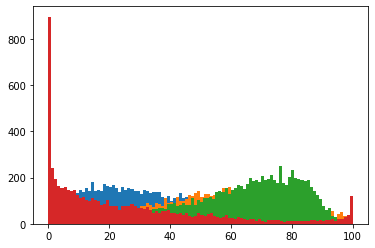

In [65]:
plt.hist(host_fraction_g1_cut*100.0, bins=100)
plt.hist(host_fraction_r1_cut*100.0, bins=100)
plt.hist(host_fraction_i1_cut*100.0, bins=100)
plt.hist(host_fraction_g2_cut*100.0, bins=100)

In [66]:
########################################################################################################################################
delta_mag_tot_correct_g1_cut_cont = mag_diff_g1_corrected_cont
delta_mag_tot_correct_r1_cut_cont = mag_diff_r1_corrected_cont
delta_mag_tot_correct_i1_cut_cont = mag_diff_i1_corrected_cont
delta_mag_tot_correct_g2_cut_cont = mag_diff_g2_corrected_cont
delta_mag_tot_correct_r2_cut_cont = mag_diff_r2_corrected_cont
delta_mag_tot_correct_i2_cut_cont = mag_diff_i2_corrected_cont

spectro_photo_flux_ratio_g1 = 10.0**(delta_mag_tot_correct_g1_cut_cont/-2.5)
spectro_photo_flux_ratio_r1 = 10.0**(delta_mag_tot_correct_r1_cut_cont/-2.5)
spectro_photo_flux_ratio_i1 = 10.0**(delta_mag_tot_correct_i1_cut_cont/-2.5)
spectro_photo_flux_ratio_g2 = 10.0**(delta_mag_tot_correct_g2_cut_cont/-2.5)
spectro_photo_flux_ratio_r2 = 10.0**(delta_mag_tot_correct_r2_cut_cont/-2.5)
spectro_photo_flux_ratio_i2 = 10.0**(delta_mag_tot_correct_i2_cut_cont/-2.5)

kval_g1 = -0.2*delta_mag_tot_correct_g1_cut_cont # -0.2*(mag_tot_spec_g1_cut_cont - mag_tot_phot_g1_cut_cont)
kval_r1 = -0.2*delta_mag_tot_correct_r1_cut_cont # -0.2*(mag_tot_spec_r1_cut_cont - mag_tot_phot_r1_cut_cont)
kval_i1 = -0.2*delta_mag_tot_correct_i1_cut_cont # -0.2*(mag_tot_spec_i1_cut_cont - mag_tot_phot_i1_cut_cont)
kval_g2 = -0.2*delta_mag_tot_correct_g2_cut_cont # -0.2*(mag_tot_spec_g2_cut_cont - mag_tot_phot_g2_cut_cont)
kval_r2 = -0.2*delta_mag_tot_correct_r2_cut_cont # -0.2*(mag_tot_spec_r2_cut_cont - mag_tot_phot_r2_cut_cont)
kval_i2 = -0.2*delta_mag_tot_correct_i2_cut_cont # -0.2*(mag_tot_spec_i2_cut_cont - mag_tot_phot_i2_cut_cont)

delta_mag_agn_g1_cut_cont = np.absolute(2.5*np.log10((1.0 - host_fraction_g1_cut_cont)*(10.0**kval_g1 - host_fraction_g1_cut_cont*spectro_photo_flux_ratio_g1)/\
    ((1.0 - host_fraction_g1_cut_cont*spectro_photo_flux_ratio_g1)*(10.0**(-1.0*kval_g1) - host_fraction_g1_cut_cont))))
delta_mag_agn_r1_cut_cont = np.absolute(2.5*np.log10((1.0 - host_fraction_r1_cut_cont)*(10.0**kval_r1 - host_fraction_r1_cut_cont*spectro_photo_flux_ratio_r1)/\
    ((1.0 - host_fraction_r1_cut_cont*spectro_photo_flux_ratio_r1)*(10.0**(-1.0*kval_r1) - host_fraction_r1_cut_cont))))
delta_mag_agn_i1_cut_cont = np.absolute(2.5*np.log10((1.0 - host_fraction_i1_cut_cont)*(10.0**kval_i1 - host_fraction_i1_cut_cont*spectro_photo_flux_ratio_i1)/\
    ((1.0 - host_fraction_i1_cut_cont*spectro_photo_flux_ratio_i1)*(10.0**(-1.0*kval_i1) - host_fraction_i1_cut_cont))))

delta_mag_agn_g2_cut_cont = np.absolute(2.5*np.log10((1.0 - host_fraction_g2_cut_cont)*(10.0**kval_g2 - host_fraction_g2_cut_cont*spectro_photo_flux_ratio_g2)/\
    ((1.0 - host_fraction_g2_cut_cont*spectro_photo_flux_ratio_g2)*(10.0**(-1.0*kval_g2) - host_fraction_g2_cut_cont))))
delta_mag_agn_r2_cut_cont = np.absolute(2.5*np.log10((1.0 - host_fraction_r2_cut_cont)*(10.0**kval_r2 - host_fraction_r2_cut_cont*spectro_photo_flux_ratio_r2)/\
    ((1.0 - host_fraction_r2_cut_cont*spectro_photo_flux_ratio_r2)*(10.0**(-1.0*kval_r2) - host_fraction_r2_cut_cont))))
delta_mag_agn_i2_cut_cont = np.absolute(2.5*np.log10((1.0 - host_fraction_i2_cut_cont)*(10.0**kval_i2 - host_fraction_i2_cut_cont*spectro_photo_flux_ratio_i2)/\
    ((1.0 - host_fraction_i2_cut_cont*spectro_photo_flux_ratio_i2)*(10.0**(-1.0*kval_i2) - host_fraction_i2_cut_cont))))


In [67]:
#plt.hist(delta_mag_agn_g1_cut_cont, bins =100)
#plt.hist(delta_mag_agn_r1_cut_cont, bins =100)
#plt.hist(delta_mag_agn_i1_cut_cont, bins =100)

#plt.hist(delta_mag_agn_g2_cut_cont, bins =100)
#plt.hist(delta_mag_agn_r2_cut_cont, bins =100)
#plt.hist(delta_mag_agn_i2_cut_cont, bins =100)

# Add condition for delta_mag_agn >= photometric noise
sigma_phot_g1_cut_cont

good_var_g1 = np.where((delta_mag_agn_g1_cut_cont < 1.5001) & (delta_mag_agn_g1_cut_cont > 0.0) & 
                       ((delta_mag_agn_g1_cut_cont**2.0 - sigma_phot_g1_cut_cont**2.0)>=0.0) & (sigma_hb1_cut_cont > 7.501))
good_var_r1 = np.where((delta_mag_agn_r1_cut_cont < 1.5001) & (delta_mag_agn_r1_cut_cont > 0.0) & 
                       ((delta_mag_agn_r1_cut_cont**2.0 - sigma_phot_r1_cut_cont**2.0)>=0.0) & (sigma_hb1_cut_cont > 7.501))
good_var_i1 = np.where((delta_mag_agn_i1_cut_cont < 1.5001) & (delta_mag_agn_i1_cut_cont > 0.0) & 
                       ((delta_mag_agn_i1_cut_cont**2.0 - sigma_phot_i1_cut_cont**2.0)>=0.0) & (sigma_hb1_cut_cont > 7.501))

good_var1 = np.where((delta_mag_agn_g1_cut_cont < 1.5001) & (delta_mag_agn_r1_cut_cont < 1.5001) & (delta_mag_agn_i1_cut_cont < 1.5001) & (sigma_hb1_cut_cont > 7.501)) 

good_var_g2 = np.where((delta_mag_agn_g2_cut_cont < 1.5001) & (delta_mag_agn_g2_cut_cont > 0.0) & 
                       ((delta_mag_agn_g2_cut_cont**2.0 - sigma_phot_g2_cut_cont**2.0)>=0.0) & (sigma_hb2_cut_cont > 7.501))
good_var_r2 = np.where((delta_mag_agn_r2_cut_cont < 1.5001) & (delta_mag_agn_r2_cut_cont > 0.0) & 
                       ((delta_mag_agn_r2_cut_cont**2.0 - sigma_phot_r2_cut_cont**2.0)>=0.0) & (sigma_hb2_cut_cont > 7.501))
good_var_i2 = np.where((delta_mag_agn_i2_cut_cont < 1.5001) & (delta_mag_agn_i2_cut_cont > 0.0) & 
                       ((delta_mag_agn_i2_cut_cont**2.0 - sigma_phot_i2_cut_cont**2.0)>=0.0) & (sigma_hb2_cut_cont > 7.501))

good_var2 = np.where((delta_mag_agn_g2_cut_cont < 1.5001) & (delta_mag_agn_r2_cut_cont < 1.5001) & (delta_mag_agn_i2_cut_cont < 1.5001) & (sigma_hb2_cut_cont > 7.501)) 
print(len(good_var1[0]), len(good_var2[0]))
print(len(good_var_g1[0]), len(good_var_g2[0]))
print(len(good_var_r1[0]), len(good_var_r2[0]))
print(len(good_var_i1[0]), len(good_var_i2[0]))



7028 1661
5957 1204
5979 1229
5953 1254


7162
1852
7162
1852
9014


(array([  1.,   0.,   0.,   1.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   1.,   0.,   0.,   0.,   1.,   0.,   0.,   0.,   0.,   2.,
          1.,   0.,   1.,   0.,   0.,   1.,   0.,   3.,   2.,   4.,   5.,
          5.,   5.,   8.,  16.,  10.,  23.,  34.,  52.,  68.,  96., 112.,
         98., 123., 163., 139., 141., 134., 115.,  78.,  71.,  66.,  57.,
         44.,  44.,  26.,  15.,  16.,  16.,  13.,  12.,   4.,   4.,   4.,
          3.,   2.,   1.,   2.,   3.,   1.,   0.,   0.,   0.,   0.,   1.,
          1.,   0.,   0.,   1.,   0.,   0.,   0.,   1.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          1.]),
 array([-1.42608873, -1.39551172, -1.3649347 , -1.33435769, -1.30378068,
        -1.27320367, -1.24262666, -1.21204964, -1.18147263, -1.15089562,
        -1.12031861, -1.08974159, -1.05916458, -1.02858757, -0.99801056,
        -0.96743355, -0.93685653, -0.90627952, -0.87570251, -0.8451255 ,
        -0.81454848, -0.78

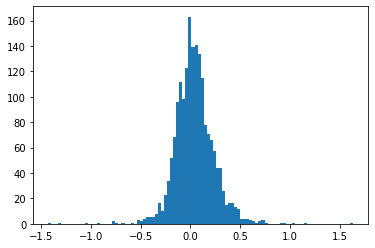

In [68]:
check_zero_g1 = np.where((1.0 - host_fraction_g1_cut_cont)*(10.0**kval_g1 - host_fraction_g1_cut_cont*spectro_photo_flux_ratio_g1)/\
    ((1.0 - host_fraction_g1_cut_cont*spectro_photo_flux_ratio_g1)*(10.0**(-1.0*kval_g1) - host_fraction_g1_cut_cont)) > 0.0)
print(len(check_zero_g1[0]))
check_zero_g2 = np.where((1.0 - host_fraction_g2_cut_cont)*(10.0**kval_g2 - host_fraction_g2_cut_cont*spectro_photo_flux_ratio_g2)/\
    ((1.0 - host_fraction_g2_cut_cont*spectro_photo_flux_ratio_g2)*(10.0**(-1.0*kval_g2) - host_fraction_g2_cut_cont)) > 0.0)
print(len(check_zero_g2[0]))
print(len(host_fraction_g1_cut_cont))
print(len(host_fraction_g2_cut_cont))
print(len(host_fraction_g1_cut_cont) + len(host_fraction_g2_cut_cont))
plt.hist((2.5*np.log10(spectro_photo_flux_ratio_i2)),bins=100)

In [69]:
def log_linear_relation(x, slope, y_interception):
    y =  10.0**(slope*np.log10(x) + y_interception)
    return y

def log_log_relation(x, slope, y_interception):
    logy =  (slope*np.log10(x) + y_interception)
    return logy

def linear_linear_relation(x, slope, y_interception):
    y_fit =  slope*x + y_interception
    return y_fit

In [70]:
#plt.hist(sigma_phot_g1_cut_cont, bins=100)

In [71]:
#plt.hist(delta_tau_rest_all, bins=100)
#print(len(tau_edges))

def find_tau_edges(tau_all, number_of_bins = 14):
    tau_edges = [0]
    number_of_all_objects = len(tau_all)
    object_in_each_bin    = int(number_of_all_objects/number_of_bins)
    tau_all.sort()
    
    for i in range(0,number_of_bins):
        element = int(object_in_each_bin*(i+1))
        if (i == (number_of_bins - 1)):
            tau_edges.append(int(np.max(delta_tau_rest_all) + 1.0))
        else:
            tau_edges.append(int(np.ceil(tau_all[element])))
            
    return tau_edges

#tau_edges_new = find_tau_edges(delta_tau_rest_all, number_of_bins = 14)
#print(len(tau_edges_new),tau_edges_new)
#print(np.max(delta_tau_rest_all))

In [72]:
#plt.hist(np.log10(delta_tau1_cut_cont), bins=100)

NameError: name 'delta_tau1_cut_cont' is not defined

In [73]:
tau_edge_test = np.linspace(0.0,3.75,16)
print(tau_edge_test)

plt.hist(np.log10(delta_tau1_cut_cont), bins=100)
plt.hist(np.log10(delta_tau2_cut_cont), bins=100)

for i in range(0,len(tau_edge_test)):
    plt.plot([tau_edge_test[i],tau_edge_test[i]],[0,750], 'k--')
plt.xlim([0.0,4.0])
plt.ylim([0,200])

tau_edges_in_log10 = np.linspace(0.0,3.75,16)
tau_edges = 10.0**tau_edges_in_log10

print(tau_edges)

[0.   0.25 0.5  0.75 1.   1.25 1.5  1.75 2.   2.25 2.5  2.75 3.   3.25
 3.5  3.75]


NameError: name 'delta_tau1_cut_cont' is not defined

In [74]:
phot_noise_g1_cut_cont = trumpet_curve(snMedian_g1_cut_cont, popt_gal_g1_std[0], popt_gal_g1_std[1], popt_gal_g1_std[2], popt_gal_g1_std[3])
phot_noise_r1_cut_cont = trumpet_curve(snMedian_r1_cut_cont, popt_gal_r1_std[0], popt_gal_r1_std[1], popt_gal_r1_std[2], popt_gal_r1_std[3])
phot_noise_i1_cut_cont = trumpet_curve(snMedian_i1_cut_cont, popt_gal_i1_std[0], popt_gal_i1_std[1], popt_gal_i1_std[2], popt_gal_i1_std[3])

phot_noise_g2_cut_cont = trumpet_curve(snMedian_g2_cut_cont, popt_gal_g2_std[0], popt_gal_g2_std[1], popt_gal_g2_std[2], popt_gal_g2_std[3])
phot_noise_r2_cut_cont = trumpet_curve(snMedian_r2_cut_cont, popt_gal_r2_std[0], popt_gal_r2_std[1], popt_gal_r2_std[2], popt_gal_r2_std[3])
phot_noise_i2_cut_cont = trumpet_curve(snMedian_i2_cut_cont, popt_gal_i2_std[0], popt_gal_i2_std[1], popt_gal_i2_std[2], popt_gal_i2_std[3])

var_g1 = np.sqrt(0.5*np.pi*np.absolute(delta_mag_agn_g1_cut_cont[good_var1])**2.0 - 2.0*(phot_noise_g1_cut_cont[good_var1]**2.0))
var_r1 = np.sqrt(0.5*np.pi*np.absolute(delta_mag_agn_r1_cut_cont[good_var1])**2.0 - 2.0*(phot_noise_r1_cut_cont[good_var1]**2.0))
var_i1 = np.sqrt(0.5*np.pi*np.absolute(delta_mag_agn_i1_cut_cont[good_var1])**2.0 - 2.0*(phot_noise_i1_cut_cont[good_var1]**2.0))
varsep_g1 = np.sqrt(0.5*np.pi*np.absolute(delta_mag_agn_g1_cut_cont[good_var_g1])**2.0 - 2.0*(phot_noise_g1_cut_cont[good_var_g1]**2.0))
varsep_r1 = np.sqrt(0.5*np.pi*np.absolute(delta_mag_agn_r1_cut_cont[good_var_r1])**2.0 - 2.0*(phot_noise_r1_cut_cont[good_var_r1]**2.0))
varsep_i1 = np.sqrt(0.5*np.pi*np.absolute(delta_mag_agn_i1_cut_cont[good_var_i1])**2.0 - 2.0*(phot_noise_i1_cut_cont[good_var_i1]**2.0))

var_g1_Li2018 = np.sqrt(np.absolute(delta_mag_agn_g1_cut_cont[good_var1])**2.0 - 2.0*(phot_noise_g1_cut_cont[good_var1]**2.0))
var_r1_Li2018 = np.sqrt(np.absolute(delta_mag_agn_r1_cut_cont[good_var1])**2.0 - 2.0*(phot_noise_r1_cut_cont[good_var1]**2.0))
var_i1_Li2018 = np.sqrt(np.absolute(delta_mag_agn_i1_cut_cont[good_var1])**2.0 - 2.0*(phot_noise_i1_cut_cont[good_var1]**2.0))
varsep_g1_Li2018 = np.sqrt(np.absolute(delta_mag_agn_g1_cut_cont[good_var_g1])**2.0 - 2.0*(phot_noise_g1_cut_cont[good_var_g1]**2.0))
varsep_r1_Li2018 = np.sqrt(np.absolute(delta_mag_agn_r1_cut_cont[good_var_r1])**2.0 - 2.0*(phot_noise_r1_cut_cont[good_var_r1]**2.0))
varsep_i1_Li2018 = np.sqrt(np.absolute(delta_mag_agn_i1_cut_cont[good_var_i1])**2.0 - 2.0*(phot_noise_i1_cut_cont[good_var_i1]**2.0))

delta_tau1_cut_cont = np.absolute(mjd_plate1_cut_cont[good_var1] - mjd_phot1_cut_cont[good_var1])
delta_tau_g1_cut_cont = np.absolute(mjd_plate1_cut_cont[good_var_g1] - mjd_phot1_cut_cont[good_var_g1])
delta_tau_r1_cut_cont = np.absolute(mjd_plate1_cut_cont[good_var_r1] - mjd_phot1_cut_cont[good_var_r1])
delta_tau_i1_cut_cont = np.absolute(mjd_plate1_cut_cont[good_var_i1] - mjd_phot1_cut_cont[good_var_i1])
#############################################################################################################################

var_g2 = np.sqrt(0.5*np.pi*np.absolute(delta_mag_agn_g2_cut_cont[good_var2])**2.0 - 2.0*phot_noise_g2_cut_cont[good_var2]**2.0)
var_r2 = np.sqrt(0.5*np.pi*np.absolute(delta_mag_agn_r2_cut_cont[good_var2])**2.0 - 2.0*phot_noise_r2_cut_cont[good_var2]**2.0)
var_i2 = np.sqrt(0.5*np.pi*np.absolute(delta_mag_agn_i2_cut_cont[good_var2])**2.0 - 2.0*phot_noise_i2_cut_cont[good_var2]**2.0)
varsep_g2 = np.sqrt(0.5*np.pi*np.absolute(delta_mag_agn_g2_cut_cont[good_var_g2])**2.0 - 2.0*phot_noise_g2_cut_cont[good_var_g2]**2.0)
varsep_r2 = np.sqrt(0.5*np.pi*np.absolute(delta_mag_agn_r2_cut_cont[good_var_r2])**2.0 - 2.0*phot_noise_r2_cut_cont[good_var_r2]**2.0)
varsep_i2 = np.sqrt(0.5*np.pi*np.absolute(delta_mag_agn_i2_cut_cont[good_var_i2])**2.0 - 2.0*phot_noise_i2_cut_cont[good_var_i2]**2.0)

var_g2_Li2018 = np.sqrt(np.absolute(delta_mag_agn_g2_cut_cont[good_var2])**2.0 - 2.0*phot_noise_g2_cut_cont[good_var2]**2.0)
var_r2_Li2018 = np.sqrt(np.absolute(delta_mag_agn_r2_cut_cont[good_var2])**2.0 - 2.0*phot_noise_r2_cut_cont[good_var2]**2.0)
var_i2_Li2018 = np.sqrt(np.absolute(delta_mag_agn_i2_cut_cont[good_var2])**2.0 - 2.0*phot_noise_i2_cut_cont[good_var2]**2.0)
varsep_g2_Li2018 = np.sqrt(np.absolute(delta_mag_agn_g2_cut_cont[good_var_g2])**2.0 - 2.0*(phot_noise_g2_cut_cont[good_var_g2]**2.0))
varsep_r2_Li2018 = np.sqrt(np.absolute(delta_mag_agn_r2_cut_cont[good_var_r2])**2.0 - 2.0*(phot_noise_r2_cut_cont[good_var_r2]**2.0))
varsep_i2_Li2018 = np.sqrt(np.absolute(delta_mag_agn_i2_cut_cont[good_var_i2])**2.0 - 2.0*(phot_noise_i2_cut_cont[good_var_i2]**2.0))

delta_tau2_cut_cont = np.absolute(mjd_plate2_cut_cont[good_var2] - mjd_phot2_cut_cont[good_var2])
delta_tau_g2_cut_cont = np.absolute(mjd_plate2_cut_cont[good_var_g2] - mjd_phot2_cut_cont[good_var_g2])
delta_tau_r2_cut_cont = np.absolute(mjd_plate2_cut_cont[good_var_r2] - mjd_phot2_cut_cont[good_var_r2])
delta_tau_i2_cut_cont = np.absolute(mjd_plate2_cut_cont[good_var_i2] - mjd_phot2_cut_cont[good_var_i2])
#############################################################################################################################

delta_tau_all = np.concatenate((delta_tau1_cut_cont, delta_tau2_cut_cont))
delta_tausep_g_all = np.concatenate((delta_tau_g1_cut_cont, delta_tau_g2_cut_cont))
delta_tausep_r_all = np.concatenate((delta_tau_r1_cut_cont, delta_tau_r2_cut_cont))
delta_tausep_i_all = np.concatenate((delta_tau_i1_cut_cont, delta_tau_i2_cut_cont))

var_g_all = np.concatenate((var_g1, var_g2))
var_r_all = np.concatenate((var_r1, var_r2))
var_i_all = np.concatenate((var_i1, var_i2))
var_g_all_Li2018 = np.concatenate((var_g1_Li2018, var_g2_Li2018))
var_r_all_Li2018 = np.concatenate((var_r1_Li2018, var_r2_Li2018))
var_i_all_Li2018 = np.concatenate((var_i1_Li2018, var_i2_Li2018))

varsep_g_all = np.concatenate((varsep_g1, varsep_g2))
varsep_r_all = np.concatenate((varsep_r1, varsep_r2))
varsep_i_all = np.concatenate((varsep_i1, varsep_i2))
varsep_g_all_Li2018 = np.concatenate((varsep_g1_Li2018, varsep_g2_Li2018))
varsep_r_all_Li2018 = np.concatenate((varsep_r1_Li2018, varsep_r2_Li2018))
varsep_i_all_Li2018 = np.concatenate((varsep_i1_Li2018, varsep_i2_Li2018))

z_agn_all = np.concatenate((redshift1_cut_cont[good_var1], redshift2_cut_cont[good_var2]))
z_agn_g_all = np.concatenate((redshift1_cut_cont[good_var_g1], redshift2_cut_cont[good_var_g2]))
z_agn_r_all = np.concatenate((redshift1_cut_cont[good_var_r1], redshift2_cut_cont[good_var_r2]))
z_agn_i_all = np.concatenate((redshift1_cut_cont[good_var_i1], redshift2_cut_cont[good_var_i2]))

delta_tau_rest_all = delta_tau_all/(1.0 + z_agn_all)
delta_tau_rest_g_all = np.concatenate((delta_tau_g1_cut_cont, delta_tau_g2_cut_cont))/(1.0 + z_agn_g_all)
delta_tau_rest_r_all = np.concatenate((delta_tau_r1_cut_cont, delta_tau_r2_cut_cont))/(1.0 + z_agn_r_all)
delta_tau_rest_i_all = np.concatenate((delta_tau_i1_cut_cont, delta_tau_i2_cut_cont))/(1.0 + z_agn_i_all)

mag_abs_agn_all = np.concatenate((mag_abs_agn_i1_cut_cont[good_var1], mag_abs_agn_i2_cut_cont[good_var2]))
mag_abs_agn_g_all = np.concatenate((mag_abs_agn_i1_cut_cont[good_var_g1], mag_abs_agn_i2_cut_cont[good_var_g2]))
mag_abs_agn_r_all = np.concatenate((mag_abs_agn_i1_cut_cont[good_var_r1], mag_abs_agn_i2_cut_cont[good_var_r2]))
mag_abs_agn_i_all = np.concatenate((mag_abs_agn_i1_cut_cont[good_var_i1], mag_abs_agn_i2_cut_cont[good_var_i2]))

delta_mag_g_cut_cont_all = np.absolute(np.concatenate((delta_mag_agn_g1_cut_cont[good_var1], delta_mag_agn_g2_cut_cont[good_var2])))
delta_mag_r_cut_cont_all = np.absolute(np.concatenate((delta_mag_agn_r1_cut_cont[good_var1], delta_mag_agn_r2_cut_cont[good_var2])))
delta_mag_i_cut_cont_all = np.absolute(np.concatenate((delta_mag_agn_i1_cut_cont[good_var1], delta_mag_agn_i2_cut_cont[good_var2])))

sigma_phot_g_cut_cont_all = np.absolute(np.concatenate((sigma_phot_g1_cut_cont[good_var1], sigma_phot_g2_cut_cont[good_var2])))
sigma_phot_r_cut_cont_all = np.absolute(np.concatenate((sigma_phot_r1_cut_cont[good_var1], sigma_phot_r2_cut_cont[good_var2])))
sigma_phot_i_cut_cont_all = np.absolute(np.concatenate((sigma_phot_i1_cut_cont[good_var1], sigma_phot_i2_cut_cont[good_var2])))

In [75]:
lambdaL5100_g_all = np.concatenate((lambdaL5100_agn1_cut_cont[good_var_g1], lambdaL5100_agn1_cut_cont[good_var_g2]))
lambdaL5100_r_all = np.concatenate((lambdaL5100_agn1_cut_cont[good_var_r1], lambdaL5100_agn1_cut_cont[good_var_r2]))
lambdaL5100_i_all = np.concatenate((lambdaL5100_agn1_cut_cont[good_var_i1], lambdaL5100_agn1_cut_cont[good_var_i2]))

sigma_hb_g_all = np.concatenate((sigma_hb1_cut_cont[good_var_g1], sigma_hb2_cut_cont[good_var_g2]))
sigma_hb_r_all = np.concatenate((sigma_hb1_cut_cont[good_var_r1], sigma_hb2_cut_cont[good_var_r2]))
sigma_hb_i_all = np.concatenate((sigma_hb1_cut_cont[good_var_i1], sigma_hb2_cut_cont[good_var_i2]))

delta_tausep_conc = np.concatenate((delta_tausep_g_all, delta_tausep_r_all, delta_tausep_i_all))
var_amp_conc      = np.concatenate((varsep_g_all_Li2018,varsep_r_all_Li2018,varsep_i_all_Li2018))
lambdaL5100_conc  = np.concatenate((lambdaL5100_g_all, lambdaL5100_r_all, lambdaL5100_i_all))
L_bolo_conc       = lambdaL5100_conc*9.0
sigma_hb_conc     = np.concatenate((sigma_hb_g_all,sigma_hb_r_all, sigma_hb_i_all))
                          
M_BH_conc  = 10.0**(log_M_BH_Park2015(lambdaL5100_conc, sigma_hb_conc))
R_Edd_conc = R_Edd_cal5100(lambdaL5100_conc, sigma_hb_conc)  

                               
plt.hist(sigma_hb_g_all, bins=100)
print(len(np.where(sigma_hb_g_all <= 7.501)[0]))


NameError: name 'log_M_BH_Park2015' is not defined

In [76]:
print(z_agn_g_all.shape)
z_conc = np.concatenate((z_agn_g_all,z_agn_r_all,z_agn_i_all))
wavelength_rest_conc = np.concatenate((4770.0/(1.0 + z_agn_g_all),6231.0/(1.0 + z_agn_r_all),7625.0/(1.0 + z_agn_i_all)))

list_2D_params_agn = list()
list_2D_params_agn.append(delta_tausep_conc)
list_2D_params_agn.append(var_amp_conc)
list_2D_params_agn.append(z_conc)
list_2D_params_agn.append(wavelength_rest_conc)
list_2D_params_agn.append(L_bolo_conc)
list_2D_params_agn.append(M_BH_conc)
list_2D_params_agn.append(R_Edd_conc)

print(len(list_2D_params_agn),len(list_2D_params_agn[0]), len(list_2D_params_agn[1]))
print(list_2D_params_agn)
print(list_2D_params_agn[2])
print(z_conc)

matrix_params_agn = np.array(list_2D_params_agn)
print(matrix_params_agn.shape)
print(matrix_params_agn[2])

plt.hist(delta_tausep_conc,bins=100)

(7161,)


NameError: name 'M_BH_conc' is not defined

In [77]:
tau_edges_in_log10 = np.linspace(0.0,3.75,16)
tau_edges = 10.0**tau_edges_in_log10

delta_mag_g_bin_all_mean   = np.zeros(len(tau_edges)-1)
delta_mag_r_bin_all_mean   = np.zeros(len(tau_edges)-1)
delta_mag_i_bin_all_mean   = np.zeros(len(tau_edges)-1)
sigma_phot_g_bin_all_mean  = np.zeros(len(tau_edges)-1)
sigma_phot_r_bin_all_mean = np.zeros(len(tau_edges)-1)
sigma_phot_i_bin_all_mean  = np.zeros(len(tau_edges)-1)

delta_mag_g_bin_all_median   = np.zeros(len(tau_edges)-1)
delta_mag_r_bin_all_median   = np.zeros(len(tau_edges)-1)
delta_mag_i_bin_all_median   = np.zeros(len(tau_edges)-1)
sigma_phot_g_bin_all_median  = np.zeros(len(tau_edges)-1)
sigma_phot_r_bin_all_median = np.zeros(len(tau_edges)-1)
sigma_phot_i_bin_all_median  = np.zeros(len(tau_edges)-1)

delta_mag_g_bin_all_std   = np.zeros(len(tau_edges)-1)
delta_mag_r_bin_all_std   = np.zeros(len(tau_edges)-1)
delta_mag_i_bin_all_std   = np.zeros(len(tau_edges)-1)
sigma_phot_g_bin_all_std  = np.zeros(len(tau_edges)-1)
sigma_phot_r_bin_all_std = np.zeros(len(tau_edges)-1)
sigma_phot_i_bin_all_std  = np.zeros(len(tau_edges)-1)

var_g_tau_mean = np.zeros(len(tau_edges)-1)
var_r_tau_mean = np.zeros(len(tau_edges)-1)
var_i_tau_mean = np.zeros(len(tau_edges)-1)

var_g_tau_median = np.zeros(len(tau_edges)-1)
var_r_tau_median = np.zeros(len(tau_edges)-1)
var_i_tau_median = np.zeros(len(tau_edges)-1)

var_g_tau_std = np.zeros(len(tau_edges)-1)
var_r_tau_std = np.zeros(len(tau_edges)-1)
var_i_tau_std = np.zeros(len(tau_edges)-1)

log_var_g_tau_mean = np.zeros(len(tau_edges)-1)
log_var_r_tau_mean = np.zeros(len(tau_edges)-1)
log_var_i_tau_mean = np.zeros(len(tau_edges)-1)

log_var_g_tau_median = np.zeros(len(tau_edges)-1)
log_var_r_tau_median = np.zeros(len(tau_edges)-1)
log_var_i_tau_median = np.zeros(len(tau_edges)-1)

log_var_g_tau_std = np.zeros(len(tau_edges)-1)
log_var_r_tau_std = np.zeros(len(tau_edges)-1)
log_var_i_tau_std = np.zeros(len(tau_edges)-1)

var_g_tau_std_SEM = np.zeros(len(tau_edges)-1)
var_r_tau_std_SEM = np.zeros(len(tau_edges)-1)
var_i_tau_std_SEM = np.zeros(len(tau_edges)-1)

tau_bin_SEM =  np.zeros(len(tau_edges)-1)
tau_mean = np.zeros(len(tau_edges)-1)
tau_median = np.zeros(len(tau_edges)-1)
tau_std = np.zeros(len(tau_edges)-1)

sigma_clip_level = 3.0
sigma_clip_iteration = int(3.0)

print(len(var_g1))
print(len(var_g_all))

print(len(var_g_all[~np.isnan(var_g_all)]))
print(len(var_r_all[~np.isnan(var_r_all)]))
print(len(var_i_all[~np.isnan(var_i_all)]))

print(len(var_g_all_Li2018[~np.isnan(var_g_all_Li2018)]))
print(len(var_r_all_Li2018[~np.isnan(var_r_all_Li2018)]))
print(len(var_i_all_Li2018[~np.isnan(var_i_all_Li2018)]))

#plt.hist(var_g_all[~np.isnan(var_i_all)])
#plt.hist(var_r_all[~np.isnan(var_i_all)])
#plt.hist(var_i_all[~np.isnan(var_i_all)])

7028
8689
7366
7500
7424
7092
7188
7153


(0, 2.0)

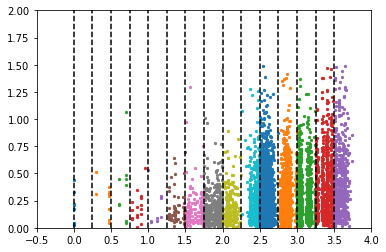

In [78]:
for i in range(0,len(tau_edges)-1):
    plt.plot([np.log10(tau_edges[i]),np.log10(tau_edges[i])],[0,2.0], 'k--')
    good_group = np.where((delta_tau_all >= tau_edges[i]) & (delta_tau_all < tau_edges[i+1]))
    plt.scatter(np.log10(delta_tau_all[good_group]), var_i_all_Li2018[good_group], s=5.0)
plt.xlim([-0.50,4.0])
plt.ylim([0,2.0])


[0.09782312 0.43709518 0.12903585 ... 0.68283679 0.51557023 0.31433979]
[0.07341133 0.34585476 0.09759766 ... 0.53980507 0.40542211 0.23887909]
6060


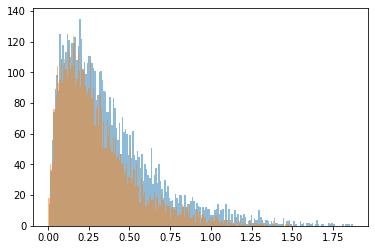

In [79]:
plt.hist(var_g_all[~np.isnan(var_i_all)], bins=200, alpha=0.5)
plt.hist(var_g_all_Li2018[~np.isnan(var_i_all_Li2018)], bins=200, alpha=0.5)

#plt.hist(var_r_all[~np.isnan(var_i_all)], bins=1000, alpha=0.5)
#plt.hist(var_i_all[~np.isnan(var_i_all)], bins=1000, alpha=0.25)
#plt.xlim([-0.05,0.5])
print(var_g_all[~np.isnan(var_g_all)])
print(var_g_all_Li2018[~np.isnan(var_g_all_Li2018)])

good_var = np.where(~np.isnan(var_g_all) & ~np.isnan(var_r_all) & ~np.isnan(var_i_all))
print(len(good_var[0]))

In [80]:
print(delta_tau_rest_all)

[ 376.61927541   31.84121846   41.63418482 ... 1346.93936202 1237.52045901
  969.09658663]


In [81]:
for l in range(0,len(tau_edges)-1):
    good_tau = np.where((delta_tau_rest_all > tau_edges[l]) & (delta_tau_rest_all <= tau_edges[l+1]))
    tau_mean[l], tau_median[l], tau_std[l] = sigma_clipped_stats(delta_tau_rest_all[good_tau], sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
    #print(tau_mean[l], tau_median[l], tau_std[l])
    tau_bin_SEM[l] = sem(delta_tau_rest_all[good_tau], nan_policy='omit')
    
    var_g_tau_mean[l], var_g_tau_median[l], var_g_tau_std[l] = sigma_clipped_stats(var_g_all[good_tau], sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
    var_r_tau_mean[l], var_r_tau_median[l], var_r_tau_std[l] = sigma_clipped_stats(var_r_all[good_tau], sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
    var_i_tau_mean[l], var_i_tau_median[l], var_i_tau_std[l] = sigma_clipped_stats(var_i_all[good_tau], sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')

    #print(var_g_tau_mean[l], var_g_tau_median[l], var_g_tau_std[l])
    #print(var_r_tau_mean[l], var_r_tau_median[l], var_r_tau_std[l])
    #print(var_i_tau_mean[l], var_i_tau_median[l], var_i_tau_std[l])
    
    var_g_tau_std_SEM[l] = sem(var_g_all[good_tau], nan_policy='omit')
    var_r_tau_std_SEM[l] = sem(var_r_all[good_tau], nan_policy='omit')
    var_i_tau_std_SEM[l] = sem(var_i_all[good_tau], nan_policy='omit')
    
    #print(var_g_tau_std_SEM[l], var_r_tau_std_SEM[l], var_i_tau_std_SEM[l])
    
    log_var_g_tau_mean[l], log_var_g_tau_median[l], log_var_g_tau_std[l] = sigma_clipped_stats(np.log10(var_g_all[good_tau]), sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
    log_var_r_tau_mean[l], log_var_r_tau_median[l], log_var_r_tau_std[l] = sigma_clipped_stats(np.log10(var_r_all[good_tau]), sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
    log_var_i_tau_mean[l], log_var_i_tau_median[l], log_var_i_tau_std[l] = sigma_clipped_stats(np.log10(var_i_all[good_tau]), sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
    
    #delta_mag_g_bin_all_mean[l], delta_mag_g_bin_all_median[l], delta_mag_g_bin_all_std[l] = sigma_clipped_stats(delta_mag_g_cut_cont_all[good_tau], sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
    #delta_mag_r_bin_all_mean[l], delta_mag_r_bin_all_median[l], delta_mag_r_bin_all_std[l] = sigma_clipped_stats(delta_mag_r_cut_cont_all[good_tau], sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
    #delta_mag_i_bin_all_mean[l], delta_mag_i_bin_all_median[l], delta_mag_i_bin_all_std[l] = sigma_clipped_stats(delta_mag_i_cut_cont_all[good_tau], sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
    
    #sigma_phot_g_bin_all_mean[l], sigma_phot_g_bin_all_median[l], sigma_phot_g_bin_all_std[l] = sigma_clipped_stats(sigma_phot_g_cut_cont_all[good_tau], sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
    #sigma_phot_r_bin_all_mean[l], sigma_phot_r_bin_all_median[l], sigma_phot_r_bin_all_std[l] = sigma_clipped_stats(sigma_phot_r_cut_cont_all[good_tau], sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
    #sigma_phot_i_bin_all_mean[l], sigma_phot_i_bin_all_median[l], sigma_phot_i_bin_all_std[l] = sigma_clipped_stats(sigma_phot_i_cut_cont_all[good_tau], sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
    

In [82]:
bootindex = np.random.randint
test_boot = bootindex(0,len(good_tau[0])-1,len(good_tau[0]))
#print(delta_tau_rest_all[test_boot])
print(np.log10(np.min(delta_tau_rest_all)), np.log10(np.max(delta_tau_rest_all)))

var_g_all_trim = var_g_all[np.where(~np.isnan(var_g_all) & (var_g_all > 0.0) & (var_g_all <= 2.0))]
var_r_all_trim = var_r_all[np.where(~np.isnan(var_r_all) & (var_r_all > 0.0) & (var_r_all <= 2.0))]
var_i_all_trim = var_i_all[np.where(~np.isnan(var_i_all) & (var_i_all > 0.0) & (var_i_all <= 2.0))]

var_g_all_Li2018_trim = var_g_all[np.where(~np.isnan(var_g_all_Li2018) & (var_g_all_Li2018 > 0.0) & (var_g_all_Li2018 <= 1.5))]
var_r_all_Li2018_trim = var_r_all[np.where(~np.isnan(var_r_all_Li2018) & (var_r_all_Li2018 > 0.0) & (var_r_all_Li2018 <= 1.5))]
var_i_all_Li2018_trim = var_i_all[np.where(~np.isnan(var_i_all_Li2018) & (var_i_all_Li2018 > 0.0) & (var_i_all_Li2018 <= 1.5))]

delta_tau_rest_all_g_trim = delta_tau_rest_all[np.where(~np.isnan(var_g_all) & (var_g_all > 0.0) & (var_g_all <= 2.0))]
delta_tau_rest_all_r_trim = delta_tau_rest_all[np.where(~np.isnan(var_r_all) & (var_r_all > 0.0) & (var_r_all <= 2.0))]
delta_tau_rest_all_i_trim = delta_tau_rest_all[np.where(~np.isnan(var_i_all) & (var_i_all > 0.0) & (var_i_all <= 2.0))]

delta_tau_rest_all_g_Li2018_trim = delta_tau_rest_all[np.where(~np.isnan(var_g_all_Li2018) & (var_g_all_Li2018 > 0.0) & (var_g_all_Li2018 <= 1.5))]
delta_tau_rest_all_r_Li2018_trim = delta_tau_rest_all[np.where(~np.isnan(var_r_all_Li2018) & (var_r_all_Li2018 > 0.0) & (var_r_all_Li2018 <= 1.5))]
delta_tau_rest_all_i_Li2018_trim = delta_tau_rest_all[np.where(~np.isnan(var_i_all_Li2018) & (var_i_all_Li2018 > 0.0) & (var_i_all_Li2018 <= 1.5))]


print(len(var_g_all_trim), len(var_r_all_trim), len(var_i_all_trim))
print(len(delta_tau_rest_all_g_trim), len(delta_tau_rest_all_r_trim), len(delta_tau_rest_all_i_trim))
print(len(var_g_all_Li2018_trim), len(var_r_all_Li2018_trim), len(var_i_all_Li2018_trim))
print(len(delta_tau_rest_all), len(var_g_all), len(delta_tau_rest_all_i_Li2018_trim))

-0.1807994556000176 3.6654760873798637
7366 7500 7424
7366 7500 7424
7092 7188 7153
8689 8689 7153


In [83]:
bootindex = np.random.randint
nboot     = 500

list_para_g_tau = list()
list_para_r_tau = list()
list_para_i_tau = list()

list_para_g_tau_Li2018 = list()
list_para_r_tau_Li2018 = list()
list_para_i_tau_Li2018 = list()

#def linear_linear_relation(x, slope, y_interception):
#    y_fit =  slope*x + y_interception
#    return y_fit
# loop over n bootstrap samples from the resids 

var_g_tau_mean_Li2018      = np.zeros(len(tau_edges)-1)
var_g_tau_median_Li2018    = np.zeros(len(tau_edges)-1)
var_g_tau_std_Li2018       = np.zeros(len(tau_edges)-1)

var_r_tau_mean_Li2018      = np.zeros(len(tau_edges)-1)
var_r_tau_median_Li2018    = np.zeros(len(tau_edges)-1)
var_r_tau_std_Li2018       = np.zeros(len(tau_edges)-1)

var_i_tau_mean_Li2018      = np.zeros(len(tau_edges)-1)
var_i_tau_median_Li2018    = np.zeros(len(tau_edges)-1)
var_i_tau_std_Li2018       = np.zeros(len(tau_edges)-1)

var_g_tau_std_SEM_Li2018   = np.zeros(len(tau_edges)-1)
var_r_tau_std_SEM_Li2018   = np.zeros(len(tau_edges)-1)
var_i_tau_std_SEM_Li2018   = np.zeros(len(tau_edges)-1)

#delta_tau_rest_g_all = delta_tau_rest_all[np.where()]

for i in range(nboot): 
    for l in range(0,len(tau_edges)-1):
        good_tau       = np.where((delta_tau_rest_all > tau_edges[l]) & (delta_tau_rest_all <= tau_edges[l+1]))
        good_tau_boot  = bootindex(0,len(good_tau[0])-1,2*len(good_tau[0])) 

        delta_tau_boot = delta_tau_rest_all[good_tau][good_tau_boot]
        var_g_tau_boot = var_g_all[good_tau][good_tau_boot]
        var_r_tau_boot = var_r_all[good_tau][good_tau_boot]
        var_i_tau_boot = var_i_all[good_tau][good_tau_boot]
                                   
        var_g_tau_Li2018_boot = var_g_all_Li2018[good_tau][good_tau_boot]
        var_r_tau_Li2018_boot = var_r_all_Li2018[good_tau][good_tau_boot]
        var_i_tau_Li2018_boot = var_i_all_Li2018[good_tau][good_tau_boot]
                                   
        tau_mean[l], tau_median[l], tau_std[l] = sigma_clipped_stats(delta_tau_boot, sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
        tau_bin_SEM[l] = sem(delta_tau_boot, nan_policy='omit')
    
        var_g_tau_mean[l], var_g_tau_median[l], var_g_tau_std[l] = sigma_clipped_stats(var_g_tau_boot, sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
        var_r_tau_mean[l], var_r_tau_median[l], var_r_tau_std[l] = sigma_clipped_stats(var_r_tau_boot, sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
        var_i_tau_mean[l], var_i_tau_median[l], var_i_tau_std[l] = sigma_clipped_stats(var_i_tau_boot, sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')    
        var_g_tau_std_SEM[l] = sem(np.log10(var_g_tau_boot), nan_policy='omit')
        var_r_tau_std_SEM[l] = sem(np.log10(var_r_tau_boot), nan_policy='omit')
        var_i_tau_std_SEM[l] = sem(np.log10(var_i_tau_boot), nan_policy='omit')
        
        var_g_tau_mean_Li2018[l], var_g_tau_median_Li2018[l], var_g_tau_std_Li2018[l] = sigma_clipped_stats(var_g_tau_Li2018_boot, sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
        var_r_tau_mean_Li2018[l], var_r_tau_median_Li2018[l], var_r_tau_std_Li2018[l] = sigma_clipped_stats(var_r_tau_Li2018_boot, sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
        var_i_tau_mean_Li2018[l], var_i_tau_median_Li2018[l], var_i_tau_std_Li2018[l] = sigma_clipped_stats(var_i_tau_Li2018_boot, sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
        var_g_tau_std_SEM_Li2018[l] = sem(np.log10(var_g_tau_Li2018_boot), nan_policy='omit')
        var_r_tau_std_SEM_Li2018[l] = sem(np.log10(var_r_tau_Li2018_boot), nan_policy='omit')
        var_i_tau_std_SEM_Li2018[l] = sem(np.log10(var_i_tau_Li2018_boot), nan_policy='omit')

    pf_g_tau, pc_g_tau = curve_fit(linear_linear_relation, np.log10(tau_median[~np.isnan(np.log10(var_g_tau_median))]), np.log10(var_g_tau_median[~np.isnan(np.log10(var_g_tau_median))]), sigma=var_g_tau_std_SEM[~np.isnan(np.log10(var_g_tau_median))], absolute_sigma=True, maxfev=300) 
    pf_r_tau, pc_r_tau = curve_fit(linear_linear_relation, np.log10(tau_median[~np.isnan(np.log10(var_r_tau_median))]), np.log10(var_r_tau_median[~np.isnan(np.log10(var_r_tau_median))]), sigma=var_r_tau_std_SEM[~np.isnan(np.log10(var_r_tau_median))], absolute_sigma=True, maxfev=300) 
    pf_i_tau, pc_i_tau = curve_fit(linear_linear_relation, np.log10(tau_median[~np.isnan(np.log10(var_i_tau_median))]), np.log10(var_i_tau_median[~np.isnan(np.log10(var_i_tau_median))]), sigma=var_i_tau_std_SEM[~np.isnan(np.log10(var_i_tau_median))], absolute_sigma=True, maxfev=300) 

    pf_g_tau_Li2018, pc_g_tau_Li2018 = curve_fit(linear_linear_relation, np.log10(tau_median[~np.isnan(np.log10(var_g_tau_mean_Li2018))]), np.log10(var_g_tau_mean_Li2018[~np.isnan(np.log10(var_g_tau_mean_Li2018))]), sigma=var_g_tau_std_SEM_Li2018[~np.isnan(np.log10(var_g_tau_mean_Li2018))], absolute_sigma=True, maxfev=300) 
    pf_r_tau_Li2018, pc_r_tau_Li2018 = curve_fit(linear_linear_relation, np.log10(tau_median[~np.isnan(np.log10(var_r_tau_mean_Li2018))]), np.log10(var_r_tau_mean_Li2018[~np.isnan(np.log10(var_r_tau_mean_Li2018))]), sigma=var_r_tau_std_SEM_Li2018[~np.isnan(np.log10(var_r_tau_mean_Li2018))], absolute_sigma=True, maxfev=300) 
    pf_i_tau_Li2018, pc_i_tau_Li2018 = curve_fit(linear_linear_relation, np.log10(tau_median[~np.isnan(np.log10(var_i_tau_mean_Li2018))]), np.log10(var_i_tau_mean_Li2018[~np.isnan(np.log10(var_i_tau_mean_Li2018))]), sigma=var_i_tau_std_SEM_Li2018[~np.isnan(np.log10(var_i_tau_mean_Li2018))], absolute_sigma=True, maxfev=300) 

    list_para_g_tau.append(pf_g_tau)
    list_para_r_tau.append(pf_r_tau)
    list_para_i_tau.append(pf_i_tau)

    list_para_g_tau_Li2018.append(pf_g_tau_Li2018)
    list_para_r_tau_Li2018.append(pf_r_tau_Li2018)
    list_para_i_tau_Li2018.append(pf_i_tau_Li2018)

list_para_g_tau = np.array(list_para_g_tau)
list_para_r_tau = np.array(list_para_r_tau)
list_para_i_tau = np.array(list_para_i_tau)

list_para_g_tau_Li2018 = np.array(list_para_g_tau_Li2018)
list_para_r_tau_Li2018 = np.array(list_para_r_tau_Li2018)
list_para_i_tau_Li2018 = np.array(list_para_i_tau_Li2018)


In [84]:
bootindex = np.random.randint
nboot     = 500

list_para_g_tau_l18 = list()
list_para_r_tau_l18 = list()
list_para_i_tau_l18 = list()

#def linear_linear_relation(x, slope, y_interception):
#    y_fit =  slope*x + y_interception
#    return y_fit
# loop over n bootstrap samples from the resids 

var_g_tau_mean_l18      = np.zeros(len(tau_edges)-1)
var_g_tau_median_l18    = np.zeros(len(tau_edges)-1)
var_g_tau_std_l18       = np.zeros(len(tau_edges)-1)

var_r_tau_mean_l18      = np.zeros(len(tau_edges)-1)
var_r_tau_median_l18    = np.zeros(len(tau_edges)-1)
var_r_tau_std_l18       = np.zeros(len(tau_edges)-1)

var_i_tau_mean_l18      = np.zeros(len(tau_edges)-1)
var_i_tau_median_l18    = np.zeros(len(tau_edges)-1)
var_i_tau_std_l18       = np.zeros(len(tau_edges)-1)

var_g_tau_std_SEM_l18   = np.zeros(len(tau_edges)-1)
var_r_tau_std_SEM_l18   = np.zeros(len(tau_edges)-1)
var_i_tau_std_SEM_l18   = np.zeros(len(tau_edges)-1)

tau_mean_l18      = np.zeros(len(tau_edges)-1)
tau_median_l18    = np.zeros(len(tau_edges)-1)
tau_std_l18       = np.zeros(len(tau_edges)-1)
tau_bin_SEM_l18   = np.zeros(len(tau_edges)-1)

#delta_tau_rest_g_all = delta_tau_rest_all[np.where()]

for i in range(nboot): 
    for l in range(0,len(tau_edges)-1):
        good_tau_l18       = np.where((delta_tau_rest_all > tau_edges[l]) & (delta_tau_rest_all <= tau_edges[l+1]))
        good_tau_boot_l18  = bootindex(0,len(good_tau_l18[0])-1,2*len(good_tau_l18[0])) 

        delta_tau_boot_l18 = delta_tau_rest_all[good_tau_l18][good_tau_boot_l18]
        var_g_tau_boot_l18 = var_g_all[good_tau_l18][good_tau_boot_l18]
        var_r_tau_boot_l18 = var_r_all[good_tau_l18][good_tau_boot_l18]
        var_i_tau_boot_l18 = var_i_all[good_tau_l18][good_tau_boot_l18]
                                                                     
        tau_mean_l18[l], tau_median_l18[l], tau_std_l18[l] = sigma_clipped_stats(delta_tau_boot_l18, sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
        tau_bin_SEM_l18[l] = sem(delta_tau_boot_l18, nan_policy='omit')
    
        var_g_tau_mean_l18[l], var_g_tau_median_l18[l], var_g_tau_std_l18[l] = sigma_clipped_stats(var_g_tau_boot_l18, sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
        var_r_tau_mean_l18[l], var_r_tau_median_l18[l], var_r_tau_std_l18[l] = sigma_clipped_stats(var_r_tau_boot_l18, sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
        var_i_tau_mean_l18[l], var_i_tau_median_l18[l], var_i_tau_std_l18[l] = sigma_clipped_stats(var_i_tau_boot_l18, sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')    
        var_g_tau_std_SEM_l18[l] = sem(np.log10(var_g_tau_boot_l18), nan_policy='omit')
        var_r_tau_std_SEM_l18[l] = sem(np.log10(var_r_tau_boot_l18), nan_policy='omit')
        var_i_tau_std_SEM_l18[l] = sem(np.log10(var_i_tau_boot_l18), nan_policy='omit')
        
    pf_g_tau_l18, pc_g_tau_l18 = curve_fit(variable_gamma_tau, tau_median_l18[~np.isnan(np.log10(var_g_tau_median_l18))], np.log10(var_g_tau_median_l18[~np.isnan(np.log10(var_g_tau_median_l18))]), sigma=var_g_tau_std_SEM_l18[~np.isnan(np.log10(var_g_tau_median_l18))], absolute_sigma=True, maxfev=300) 
    pf_r_tau_l18, pc_r_tau_l18 = curve_fit(variable_gamma_tau, tau_median_l18[~np.isnan(np.log10(var_r_tau_median_l18))], np.log10(var_r_tau_median_l18[~np.isnan(np.log10(var_r_tau_median_l18))]), sigma=var_r_tau_std_SEM_l18[~np.isnan(np.log10(var_r_tau_median_l18))], absolute_sigma=True, maxfev=300) 
    pf_i_tau_l18, pc_i_tau_l18 = curve_fit(variable_gamma_tau, tau_median_l18[~np.isnan(np.log10(var_i_tau_median_l18))], np.log10(var_i_tau_median_l18[~np.isnan(np.log10(var_i_tau_median_l18))]), sigma=var_i_tau_std_SEM_l18[~np.isnan(np.log10(var_i_tau_median_l18))], absolute_sigma=True, maxfev=300) 

    list_para_g_tau_l18.append(pf_g_tau_l18)
    list_para_r_tau_l18.append(pf_r_tau_l18)
    list_para_i_tau_l18.append(pf_i_tau_l18)

list_para_g_tau_l18 = np.array(list_para_g_tau_l18)
list_para_r_tau_l18 = np.array(list_para_r_tau_l18)
list_para_i_tau_l18 = np.array(list_para_i_tau_l18)

#def variable_gamma_tau(x, gamma, log_amp):
#    log_var =log_amp + gamma*np.log10(x/365.0) # x = tau_rest
#    return log_var


NameError: name 'variable_gamma_tau' is not defined

In [85]:
print(np.mean(list_para_g_tau_l18,axis=0))
print(np.mean(list_para_r_tau_l18,axis=0))
print(np.mean(list_para_i_tau_l18,axis=0))
print(tau_mean_l18/365.0)
print(tau_median_l18/365.0)


nan
nan
nan
[4.04784187e-03 7.02816727e-03 1.20725941e-02 1.79488763e-02
 4.07050575e-02 6.85465679e-02 1.27256979e-01 2.05688822e-01
 3.50960544e-01 7.34605576e-01 1.10281732e+00 2.01527681e+00
 3.76704003e+00 6.42475691e+00 9.65751148e+00]
[4.04784187e-03 7.24629743e-03 1.18838477e-02 1.74518320e-02
 4.26224470e-02 6.87767977e-02 1.29503743e-01 2.02600832e-01
 3.30838660e-01 7.47820982e-01 1.00214523e+00 1.87946983e+00
 3.72336177e+00 6.36279879e+00 9.49361414e+00]


In [86]:
print(tau_median, len(tau_median))
print(var_g_tau_median, len(var_g_tau_median))

print('g', slope_mean_g_tau, slope_std_g_tau)
print('g', intc_mean_g_tau, intc_std_g_tau)

print('r', slope_mean_r_tau, slope_std_r_tau)
print('r', intc_mean_r_tau, intc_std_r_tau)

print('i', slope_mean_i_tau, slope_std_i_tau)
print('i', intc_mean_i_tau, intc_std_i_tau)

print(list_para_g_tau.shape)

#slope_test1, intc_test1 = list_para_g_tau[:,0], list_para_g_tau[:,1]

#print(slope_test1)
#print(intc_test1)
########################################################################################################
# make a 2D matrix consisting of (1) redshift, (2) L_bolo, (3) Lambda_rest, (4) SMBH Mass, and (5) R_Edd

def variable_gamma_tau(x, gamma, log_amp):
    log_var =log_amp + gamma*np.log10(x/365.0) # x = tau_rest
    return log_var

def get_amplitude_from_var(var,gamma,tau_rest):
    log_amp = np.log10(var) - (gamma*np.log10(tau_rest/365.0))
    amp = 10.0**log_amp
    return amp

def gamma_multidimensional_surface(X, gamma0, bz, bL, blambda, bM):
    z_obj,L,lambda_rest,m_smbh = X[:,0], X[:,1], X[:,2], X[:,3] 
    L46     = 1.0e+46 #erg/s
    lambda4 = 1.0e+4 #angstrom
    m9      = 1.0e+9 #solar mass
    gamma   = gamma0 + bz*z_obj + bL*np.log10(L/L46) + blambda*np.log10(lambda_rest/lambda4) + bM*np.log10(m_smbh/m9)
    return gamma

def amplitude_multidimensional_surface(X, logA0, Bz, BL, Blambda, BM):
    z_obj,L,lambda_rest,m_smbh = X[:,0], X[:,1], X[:,2], X[:,3] 
    L46     = 1.0e+46 #erg/s
    lambda4 = 1.0e+4 #angstrom
    m9      = 1.0e+9 #solar mass
    logA    = logA0 + Bz*np.log10(1 + z_obj) + BL*np.log10(L/L46) + Blambda*np.log10(lambda_rest/lambda4) + BM*np.log10(m_smbh/m9)
    return logA

def variability_multidimensional_surface(X, gamma0, bz, bL, blambda, bM, logA0, Bz, BL, Blambda, BM):
    tau_rest, z_obj,lambda_rest,L,m_smbh = X[:,0], X[:,2], X[:,3], X[:,4], X[:,5]
    L46     = 1.0e+46 #erg/s
    lambda4 = 1.0e+4 #angstrom
    m9      = 1.0e+9 #solar mass
    gamma   = gamma0 + bz*z_obj + bL*np.log10(L/L46) + blambda*np.log10(lambda_rest/lambda4) + bM*np.log10(m_smbh/m9)
    logA    = logA0 + Bz*np.log10(1 + z_obj) + BL*np.log10(L/L46) + Blambda*np.log10(lambda_rest/lambda4) + BM*np.log10(m_smbh/m9)
    logvar  = logA + gamma*(tau_rest/365.0)
    return logvar

def variability_multidimensional_surface_Redd(X, gamma0, bz, bRedd, blambda, bM, logA0, Bz, BRedd, Blambda, BM):
    tau_rest, z_obj,lambda_rest,Redd,m_smbh = X[:,0], X[:,2], X[:,3], X[:,6], X[:,5]
    L46     = 1.0e+46 #erg/s
    lambda4 = 1.0e+4 #angstrom
    m9      = 1.0e+9 #solar mass
    Redd_46 = 0.08333333333 #L46/((1.20e+38)*m9)
    gamma   = gamma0 + bz*z_obj + bRedd*np.log10(Redd/Redd_46) + blambda*np.log10(lambda_rest/lambda4) + bM*np.log10(m_smbh/m9)
    logA    = logA0 + Bz*np.log10(1 + z_obj) + BRedd*np.log10(Redd/Redd_46) + Blambda*np.log10(lambda_rest/lambda4) + BM*np.log10(m_smbh/m9)
    logvar  = logA + gamma*(tau_rest/365.0)
    return logvar




[1.47746228e+00 2.68601251e+00 4.70935730e+00 6.36991870e+00
 1.55571932e+01 2.72345425e+01 4.67747944e+01 7.42534963e+01
 1.22403146e+02 2.72837234e+02 3.64605952e+02 6.85259848e+02
 1.36269955e+03 2.31543747e+03 3.45245296e+03] 15
[0.17338217 0.07917014 0.16163466 0.21164743 0.17937047 0.13699521
 0.18664129 0.16942953 0.25644639 0.2285812  0.26774672 0.27860491
 0.36506331 0.36932617 0.47917233] 15


NameError: name 'slope_mean_g_tau' is not defined

In [87]:
# <matrix_params_agn> first axis indices
#[0] = delta_tausep_conc
#[1] = var_amp_conc
#[2] = z_conc
#[3] = wavelength_rest_conc)
#[4] = L_bolo_conc)
#[5] = M_BH_conc)
#[6] = R_Edd_conc)

# fit with curve_fit (variable_gamma_tau) to get amp and gamma
# Add bootstrap loop
# Then use the fitted gamma to get Amplitude of each source with "get_amplitude_from_var"

#variable_gamma_tau(x, gamma, log_amp)
#get_amplitude_from_var(var,gamma,tau_rest)




In [88]:
slope_mean_g_tau = np.mean(list_para_g_tau[:,0][np.where((list_para_g_tau[:,0] > 0.1) & (list_para_g_tau[:,0] < 0.3))], axis = 0)
slope_mean_r_tau = np.mean(list_para_r_tau[:,0][np.where((list_para_r_tau[:,0] > 0.1) & (list_para_r_tau[:,0] < 0.3))], axis = 0)
slope_mean_i_tau = np.mean(list_para_i_tau[:,0][np.where((list_para_i_tau[:,0] > 0.1) & (list_para_i_tau[:,0] < 0.3))], axis = 0)                                  
slope_std_g_tau  = np.std(list_para_g_tau[:,0][np.where((list_para_g_tau[:,0] > 0.1) & (list_para_g_tau[:,0] < 0.3))], axis = 0)
slope_std_r_tau  = np.std(list_para_r_tau[:,0][np.where((list_para_r_tau[:,0] > 0.1) & (list_para_r_tau[:,0] < 0.3))], axis = 0)
slope_std_i_tau  = np.std(list_para_i_tau[:,0][np.where((list_para_i_tau[:,0] > 0.1) & (list_para_i_tau[:,0] < 0.3))], axis = 0)

slope_mean_g_tau_Li2018 = np.mean(list_para_g_tau_Li2018[:,0][np.where((list_para_g_tau_Li2018[:,0] > 0.1) & (list_para_g_tau_Li2018[:,0] < 0.3))],0)
slope_mean_r_tau_Li2018 = np.mean(list_para_r_tau_Li2018[:,0][np.where((list_para_r_tau_Li2018[:,0] > 0.1) & (list_para_r_tau_Li2018[:,0] < 0.3))],0)
slope_mean_i_tau_Li2018 = np.mean(list_para_i_tau_Li2018[:,0][np.where((list_para_i_tau_Li2018[:,0] > 0.1) & (list_para_i_tau_Li2018[:,0] < 0.3))],0)                
slope_std_g_tau_Li2018  = np.std(list_para_g_tau_Li2018[:,0][np.where((list_para_g_tau_Li2018[:,0] > 0.1) & (list_para_g_tau_Li2018[:,0] < 0.3))],0)
slope_std_r_tau_Li2018  = np.std(list_para_r_tau_Li2018[:,0][np.where((list_para_r_tau_Li2018[:,0] > 0.1) & (list_para_r_tau_Li2018[:,0] < 0.3))],0)
slope_std_i_tau_Li2018  = np.std(list_para_i_tau_Li2018[:,0][np.where((list_para_i_tau_Li2018[:,0] > 0.1) & (list_para_i_tau_Li2018[:,0] < 0.3))],0)

intc_mean_g_tau = np.mean(list_para_g_tau[:,1][np.where((list_para_g_tau[:,0] > 0.1) & (list_para_g_tau[:,0] < 0.3))], axis = 0)
intc_mean_r_tau = np.mean(list_para_r_tau[:,1][np.where((list_para_r_tau[:,0] > 0.1) & (list_para_r_tau[:,0] < 0.3))], axis = 0)
intc_mean_i_tau = np.mean(list_para_i_tau[:,1][np.where((list_para_i_tau[:,0] > 0.1) & (list_para_i_tau[:,0] < 0.3))], axis = 0)                                  
intc_std_g_tau  = np.std(list_para_g_tau[:,1][np.where((list_para_g_tau[:,0] > 0.1) & (list_para_g_tau[:,0] < 0.3))], axis = 0)
intc_std_r_tau  = np.std(list_para_r_tau[:,1][np.where((list_para_r_tau[:,0] > 0.1) & (list_para_r_tau[:,0] < 0.3))], axis = 0)
intc_std_i_tau  = np.std(list_para_i_tau[:,1][np.where((list_para_i_tau[:,0] > 0.1) & (list_para_i_tau[:,0] < 0.3))], axis = 0)

intc_mean_g_tau_Li2018 = np.mean(list_para_g_tau_Li2018[:,1][np.where((list_para_g_tau_Li2018[:,0] > 0.1) & (list_para_g_tau_Li2018[:,0] < 0.3))],0)
intc_mean_r_tau_Li2018 = np.mean(list_para_r_tau_Li2018[:,1][np.where((list_para_r_tau_Li2018[:,0] > 0.1) & (list_para_r_tau_Li2018[:,0] < 0.3))],0)
intc_mean_i_tau_Li2018 = np.mean(list_para_i_tau_Li2018[:,1][np.where((list_para_i_tau_Li2018[:,0] > 0.1) & (list_para_i_tau_Li2018[:,0] < 0.3))],0)                
intc_std_g_tau_Li2018  = np.std(list_para_g_tau_Li2018[:,1][np.where((list_para_g_tau_Li2018[:,0] > 0.1) & (list_para_g_tau_Li2018[:,0] < 0.3))],0)
intc_std_r_tau_Li2018  = np.std(list_para_r_tau_Li2018[:,1][np.where((list_para_r_tau_Li2018[:,0] > 0.1) & (list_para_r_tau_Li2018[:,0] < 0.3))],0)
intc_std_i_tau_Li2018  = np.std(list_para_i_tau_Li2018[:,1][np.where((list_para_i_tau_Li2018[:,0] > 0.1) & (list_para_i_tau_Li2018[:,0] < 0.3))],0)


print(slope_mean_i_tau_Li2018, slope_std_i_tau_Li2018)
print(intc_mean_i_tau_Li2018, intc_std_i_tau_Li2018)

tau_rest_fit  = np.linspace(0.0001, 4000.0, 100) 
var_fit_g_tau = 10.0**linear_linear_relation(np.log10(tau_rest_fit),slope_mean_g_tau, intc_mean_g_tau)
var_fit_r_tau = 10.0**linear_linear_relation(np.log10(tau_rest_fit),slope_mean_r_tau, intc_mean_r_tau)
var_fit_i_tau = 10.0**linear_linear_relation(np.log10(tau_rest_fit),slope_mean_i_tau, intc_mean_i_tau)

var_fit_g_tau_Li2018 = 10.0**linear_linear_relation(np.log10(tau_rest_fit),slope_mean_g_tau_Li2018, intc_mean_g_tau_Li2018)
var_fit_r_tau_Li2018 = 10.0**linear_linear_relation(np.log10(tau_rest_fit),slope_mean_r_tau_Li2018, intc_mean_r_tau_Li2018)
var_fit_i_tau_Li2018 = 10.0**linear_linear_relation(np.log10(tau_rest_fit),slope_mean_i_tau_Li2018, intc_mean_i_tau_Li2018)


0.1940643929118075 0.0068420901998438085
-1.1257284486870065 0.018879317566361988


In [89]:
slope_mean_g_tau_l18 = np.mean(list_para_g_tau_l18[:,0][np.where((list_para_g_tau_l18[:,0] > 0.1) & (list_para_g_tau_l18[:,0] < 0.3))], axis = 0)
slope_mean_r_tau_l18 = np.mean(list_para_r_tau_l18[:,0][np.where((list_para_r_tau_l18[:,0] > 0.1) & (list_para_r_tau_l18[:,0] < 0.3))], axis = 0)
slope_mean_i_tau_l18 = np.mean(list_para_i_tau_l18[:,0][np.where((list_para_i_tau_l18[:,0] > 0.1) & (list_para_i_tau_l18[:,0] < 0.3))], axis = 0)                                  
slope_std_g_tau_l18  = np.std(list_para_g_tau_l18[:,0][np.where((list_para_g_tau_l18[:,0] > 0.1) & (list_para_g_tau_l18[:,0] < 0.3))], axis = 0)
slope_std_r_tau_l18  = np.std(list_para_r_tau_l18[:,0][np.where((list_para_r_tau_l18[:,0] > 0.1) & (list_para_r_tau_l18[:,0] < 0.3))], axis = 0)
slope_std_i_tau_l18  = np.std(list_para_i_tau_l18[:,0][np.where((list_para_i_tau_l18[:,0] > 0.1) & (list_para_i_tau_l18[:,0] < 0.3))], axis = 0)

amp_mean_g_tau_l18 = np.mean(10.0**list_para_g_tau_l18[:,1][np.where((list_para_g_tau_l18[:,0] > 0.1) & (list_para_g_tau_l18[:,0] < 0.3))], axis = 0)
amp_mean_r_tau_l18 = np.mean(10.0**list_para_r_tau_l18[:,1][np.where((list_para_r_tau_l18[:,0] > 0.1) & (list_para_r_tau_l18[:,0] < 0.3))], axis = 0)
amp_mean_i_tau_l18 = np.mean(10.0**list_para_i_tau_l18[:,1][np.where((list_para_i_tau_l18[:,0] > 0.1) & (list_para_i_tau_l18[:,0] < 0.3))], axis = 0)                                  
amp_std_g_tau_l18  = np.std(10.0**list_para_g_tau_l18[:,1][np.where((list_para_g_tau_l18[:,0] > 0.1) & (list_para_g_tau_l18[:,0] < 0.3))], axis = 0)
amp_std_r_tau_l18  = np.std(10.0**list_para_r_tau_l18[:,1][np.where((list_para_r_tau_l18[:,0] > 0.1) & (list_para_r_tau_l18[:,0] < 0.3))], axis = 0)
amp_std_i_tau_l18  = np.std(10.0**list_para_i_tau_l18[:,1][np.where((list_para_i_tau_l18[:,0] > 0.1) & (list_para_i_tau_l18[:,0] < 0.3))], axis = 0)

print(slope_mean_g_tau_l18, slope_std_g_tau_l18)
print(slope_mean_r_tau_l18, slope_std_r_tau_l18)
print(slope_mean_i_tau_l18, slope_std_i_tau_l18)

print(amp_mean_g_tau_l18, amp_std_g_tau_l18)
print(amp_mean_r_tau_l18, amp_std_r_tau_l18)
print(amp_mean_i_tau_l18, amp_std_i_tau_l18)
#variable_gamma_tau(x, gamma, log_amp)

tau_rest_fit  = np.linspace(0.0001, 4000.0, 100) 
var_fit_g_tau_l18 = 10.0**variable_gamma_tau(tau_rest_fit,slope_mean_g_tau_l18, np.log10(amp_mean_g_tau_l18))
var_fit_r_tau_l18 = 10.0**variable_gamma_tau(tau_rest_fit,slope_mean_r_tau_l18, np.log10(amp_mean_r_tau_l18))
var_fit_i_tau_l18 = 10.0**variable_gamma_tau(tau_rest_fit,slope_mean_i_tau_l18, np.log10(amp_mean_i_tau_l18))

var_fit_g_tau_l18paper = 10.0**variable_gamma_tau(tau_rest_fit,0.160, np.log10(0.253))
var_fit_r_tau_l18paper = 10.0**variable_gamma_tau(tau_rest_fit,0.166, np.log10(0.235))
var_fit_i_tau_l18paper = 10.0**variable_gamma_tau(tau_rest_fit,0.164, np.log10(0.210))



TypeError: list indices must be integers or slices, not tuple

NameError: name 'var_fit_g_tau_l18' is not defined

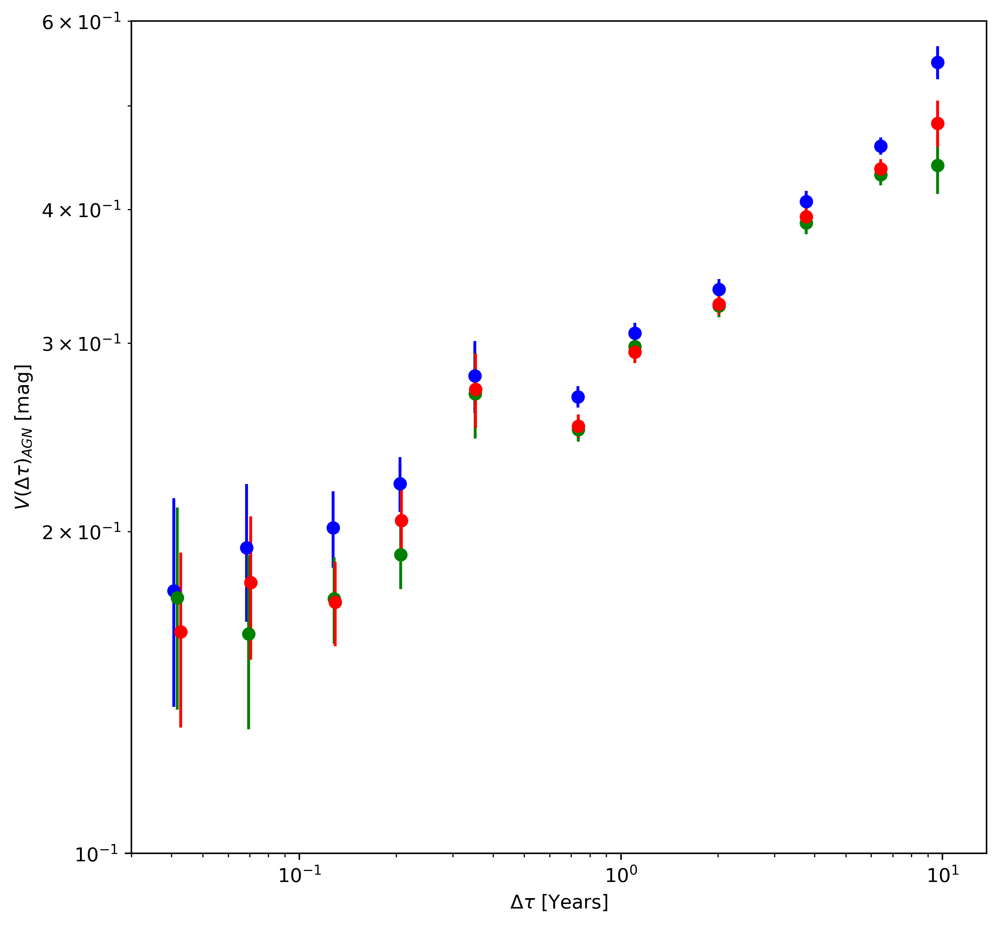

In [90]:
fig = plt.figure(1,figsize=(8,8),dpi=400)

#print(tau_median, len(tau_median))
#print(var_g_tau_median, len(var_g_tau_median))
#var_g_tau_mean_Li2018 tau_median

plt.errorbar(tau_mean_l18/365.0, var_g_tau_mean_l18, yerr=var_g_tau_std_SEM_l18, xerr=tau_bin_SEM_l18/365.0, ecolor='blue', fmt='bo')
plt.errorbar(tau_mean_l18/365.0 + 0.001, var_r_tau_mean_l18, yerr=var_r_tau_std_SEM_l18, xerr=tau_bin_SEM_l18/365.0, ecolor='green', fmt='go')
plt.errorbar(tau_mean_l18/365.0 + 0.002, var_i_tau_mean_l18, yerr=var_i_tau_std_SEM_l18, xerr=tau_bin_SEM_l18/365.0, ecolor='red', fmt='ro')

plt.xlim([0.03,5000.0/365.0])
plt.ylim([0.1,0.6])
plt.xlabel(r'$\Delta \tau$ [Years]')
plt.ylabel(r'$V(\Delta \tau)_{AGN}$ [mag]')
plt.xscale('log')
plt.yscale('log')
plt.plot(tau_rest_fit/365.0, 1.25*var_fit_g_tau_l18, 'b--', label=r'$\gamma$= %.3f'%slope_mean_g_tau_l18 +'$\pm$ %.3f'%slope_std_g_tau_l18) #label=r'$\sigma_{AGN} = %.4f $'%np.absolute(popt_i2[2])
plt.plot(tau_rest_fit/365.0, 1.25*var_fit_r_tau_l18, 'g--', label=r'$\gamma$= %.3f'%slope_mean_r_tau_l18 +'$\pm$ %.3f'%slope_std_r_tau_l18)
plt.plot(tau_rest_fit/365.0, 1.25*var_fit_i_tau_l18, 'r--', label=r'$\gamma$= %.3f'%slope_mean_i_tau_l18 +'$\pm$ %.3f'%slope_std_i_tau_l18)

plt.plot(tau_rest_fit/365.0, var_fit_g_tau_l18paper, 'b-', label=r'$\gamma$= 0.160$\pm$0.020 (Li+2018)') #label=r'$\sigma_{AGN} = %.4f $'%np.absolute(popt_i2[2])
plt.plot(tau_rest_fit/365.0, var_fit_r_tau_l18paper, 'g-', label=r'$\gamma$= 0.166$\pm$0.016 (Li+2018)')
plt.plot(tau_rest_fit/365.0, var_fit_i_tau_l18paper, 'r-', label=r'$\gamma$= 0.164$\pm$0.031 (Li+2018)')

plt.legend(loc='upper left')
fig.savefig('Variability_Delta_Tau_Rest_Frame_all_l18_bootstraped.png')
#variable_gamma_tau

In [ ]:
fig = plt.figure(1,figsize=(8,8),dpi=400)

#print(tau_median, len(tau_median))
#print(var_g_tau_median, len(var_g_tau_median))
#var_g_tau_mean_Li2018 tau_median

plt.errorbar(tau_median, var_g_tau_median, yerr=var_g_tau_std_SEM, xerr=tau_bin_SEM, ecolor='blue', fmt='bo')
plt.errorbar(tau_median + 1,var_r_tau_median, yerr=var_r_tau_std_SEM, xerr=tau_bin_SEM, ecolor='green', fmt='go')
plt.errorbar(tau_median + 2,var_i_tau_median, yerr=var_i_tau_std_SEM, xerr=tau_bin_SEM, ecolor='red', fmt='ro')

plt.errorbar(tau_median, var_g_tau_mean_Li2018, yerr=var_g_tau_std_SEM_Li2018, xerr=tau_bin_SEM, ecolor='blue', fmt='bx')
plt.errorbar(tau_median + 1,var_r_tau_mean_Li2018, yerr=var_r_tau_std_SEM_Li2018, xerr=tau_bin_SEM, ecolor='green', fmt='gx')
plt.errorbar(tau_median + 2,var_i_tau_mean_Li2018, yerr=var_i_tau_std_SEM_Li2018, xerr=tau_bin_SEM, ecolor='red', fmt='rx')

plt.xlim([10.0,6000.0])
plt.ylim([0.1,1.0])
plt.xlabel(r'$\Delta \tau$ [days]')
plt.ylabel(r'$V(\Delta \tau)_{AGN}$ [mags]')
plt.xscale('log')
plt.yscale('log')
plt.plot(tau_rest_fit, var_fit_g_tau_Li2018, 'b--', label=r'slope= %.4f'%slope_mean_g_tau_Li2018 +'$\pm$ %.4f'%slope_std_g_tau_Li2018) #label=r'$\sigma_{AGN} = %.4f $'%np.absolute(popt_i2[2])
plt.plot(tau_rest_fit, var_fit_r_tau_Li2018, 'g--', label=r'slope= %.4f'%slope_mean_r_tau_Li2018 +'$\pm$ %.4f'%slope_std_r_tau_Li2018)
plt.plot(tau_rest_fit, var_fit_i_tau_Li2018, 'r--', label=r'slope= %.4f'%slope_mean_i_tau_Li2018 +'$\pm$ %.4f'%slope_std_i_tau_Li2018)
plt.plot(tau_rest_fit, var_fit_g_tau, 'b-')
plt.plot(tau_rest_fit, var_fit_r_tau, 'g-')
plt.plot(tau_rest_fit, var_fit_i_tau, 'r-')

plt.legend(loc='upper left')
fig.savefig('Variability_Delta_Tau_Rest_Frame_all_v2_bootstraped.png')
#variable_gamma_tau

In [141]:
print(mean_params_g_tau_Li2018, std_params_g_tau_Li2018, np.std(list_para_g_tau_Li2018,0))
print(mean_params_r_tau_Li2018, std_params_r_tau_Li2018, np.std(list_para_r_tau_Li2018,0))
print(mean_params_i_tau_Li2018, std_params_i_tau_Li2018, np.std(list_para_i_tau_Li2018,0))

print(mean_params_g_tau, std_params_g_tau, np.std(list_para_g_tau_Li2018,0))
print(mean_params_r_tau, std_params_r_tau, np.std(list_para_r_tau_Li2018,0))
print(mean_params_i_tau, std_params_i_tau, np.std(list_para_i_tau_Li2018,0))

#print(mean_params_i_tau, std_params_i_tau)

#plt.hist(list_para_g_tau[:,0],bins=100, alpha=0.5)
#plt.hist(list_para_r_tau[:,0],bins=100, alpha=0.5)

#plt.hist(list_para_i_tau[:,0],bins=100, alpha=0.5)
#plt.hist(list_para_g_tau_Li2018[:,0],bins=100, alpha=0.5)
#plt.hist(list_para_r_tau_Li2018[:,0],bins=100, alpha=0.5)
#plt.hist(list_para_i_tau_Li2018[:,0],bins=100, alpha=0.5)
#plt.ylim([0,220])
#plt.xlim([0.1,0.3])

#print(list_para_i_tau_Li2018[:,0])

NameError: name 'mean_params_g_tau_Li2018' is not defined

In [142]:

var_g_tau_bin = np.sqrt(0.5*np.pi*delta_mag_g_bin_all_mean**2.0 - 2.0*sigma_phot_g_bin_all_mean**2.0)
var_r_tau_bin = np.sqrt(0.5*np.pi*delta_mag_r_bin_all_mean**2.0 - 2.0*sigma_phot_r_bin_all_mean**2.0)
var_i_tau_bin = np.sqrt(0.5*np.pi*delta_mag_i_bin_all_mean**2.0 - 2.0*sigma_phot_i_bin_all_mean**2.0)
sigma_var_g_tau_bin = 0.5*var_g_tau_bin*np.sqrt((np.pi*delta_mag_g_bin_all_mean*delta_mag_g_bin_all_std)**2.0 + 16.0*sigma_phot_g_bin_all_std**2.0)
sigma_var_r_tau_bin = 0.5*var_r_tau_bin*np.sqrt((np.pi*delta_mag_r_bin_all_mean*delta_mag_r_bin_all_std)**2.0 + 16.0*sigma_phot_r_bin_all_std**2.0)
sigma_var_i_tau_bin = 0.5*var_i_tau_bin*np.sqrt((np.pi*delta_mag_i_bin_all_mean*delta_mag_i_bin_all_std)**2.0 + 16.0*sigma_phot_i_bin_all_std**2.0)

popt_var_g_tau_bin, pcov_var_g_tau_bin = curve_fit(log_log_relation, tau_mean, np.log10(var_g_tau_bin), sigma=np.log10(sigma_var_g_tau_bin))
popt_var_r_tau_bin, pcov_var_r_tau_bin = curve_fit(log_log_relation, tau_mean, np.log10(var_r_tau_bin), sigma=np.log10(sigma_var_r_tau_bin))
popt_var_i_tau_bin, pcov_var_i_tau_bin = curve_fit(log_log_relation, tau_mean, np.log10(var_i_tau_bin), sigma=np.log10(sigma_var_i_tau_bin))

popt_var_g_tau, pcov_var_g_tau = curve_fit(log_log_relation, tau_mean, log_var_g_tau_mean, sigma=log_var_g_tau_std)
popt_var_r_tau, pcov_var_r_tau = curve_fit(log_log_relation, tau_mean, log_var_r_tau_mean, sigma=log_var_r_tau_std)
popt_var_i_tau, pcov_var_i_tau = curve_fit(log_log_relation, tau_mean, log_var_i_tau_mean, sigma=log_var_i_tau_std)

tau_fit = np.linspace(10,6000,5990)
var_g_tau_fit = log_linear_relation(tau_fit, popt_var_g_tau[0], popt_var_g_tau[1])
var_r_tau_fit = log_linear_relation(tau_fit, popt_var_r_tau[0], popt_var_r_tau[1])
var_i_tau_fit = log_linear_relation(tau_fit, popt_var_i_tau[0], popt_var_i_tau[1])

var_g_tau_std_2side = [-1.0*np.log10(log_var_g_tau_std)*var_g_tau_std, var_g_tau_std]
var_r_tau_std_2side = [-1.0*np.log10(log_var_r_tau_std)*var_r_tau_std, var_r_tau_std]
var_i_tau_std_2side = [-1.0*np.log10(log_var_i_tau_std)*var_i_tau_std, var_i_tau_std]

var_g_tau_bin_fit = log_linear_relation(tau_fit, popt_var_g_tau_bin[0], popt_var_g_tau_bin[1])
var_r_tau_bin_fit = log_linear_relation(tau_fit, popt_var_r_tau_bin[0], popt_var_r_tau_bin[1])
var_i_tau_bin_fit = log_linear_relation(tau_fit, popt_var_i_tau_bin[0], popt_var_i_tau_bin[1])


ValueError: array must not contain infs or NaNs

In [143]:
print('popt_var_g_tau_bin = ', popt_var_g_tau_bin, pcov_var_g_tau_bin)
print('popt_var_r_tau_bin = ', popt_var_r_tau_bin, pcov_var_r_tau_bin)
print('popt_var_i_tau_bin = ', popt_var_i_tau_bin, pcov_var_i_tau_bin)

print('popt_var_g_tau = ', popt_var_g_tau, pcov_var_g_tau)
print('popt_var_r_tau = ', popt_var_r_tau, pcov_var_r_tau)
print('popt_var_i_tau = ', popt_var_i_tau, pcov_var_i_tau)


NameError: name 'popt_var_g_tau_bin' is not defined

[0.06108866 0.07816772 0.05747841 0.06265242 0.05011688 0.02906801
 0.01538703 0.01220474 0.02181385 0.00613356 0.00690826 0.00737049
 0.01015849 0.00911268 0.02177792]


NameError: name 'tau_fit' is not defined

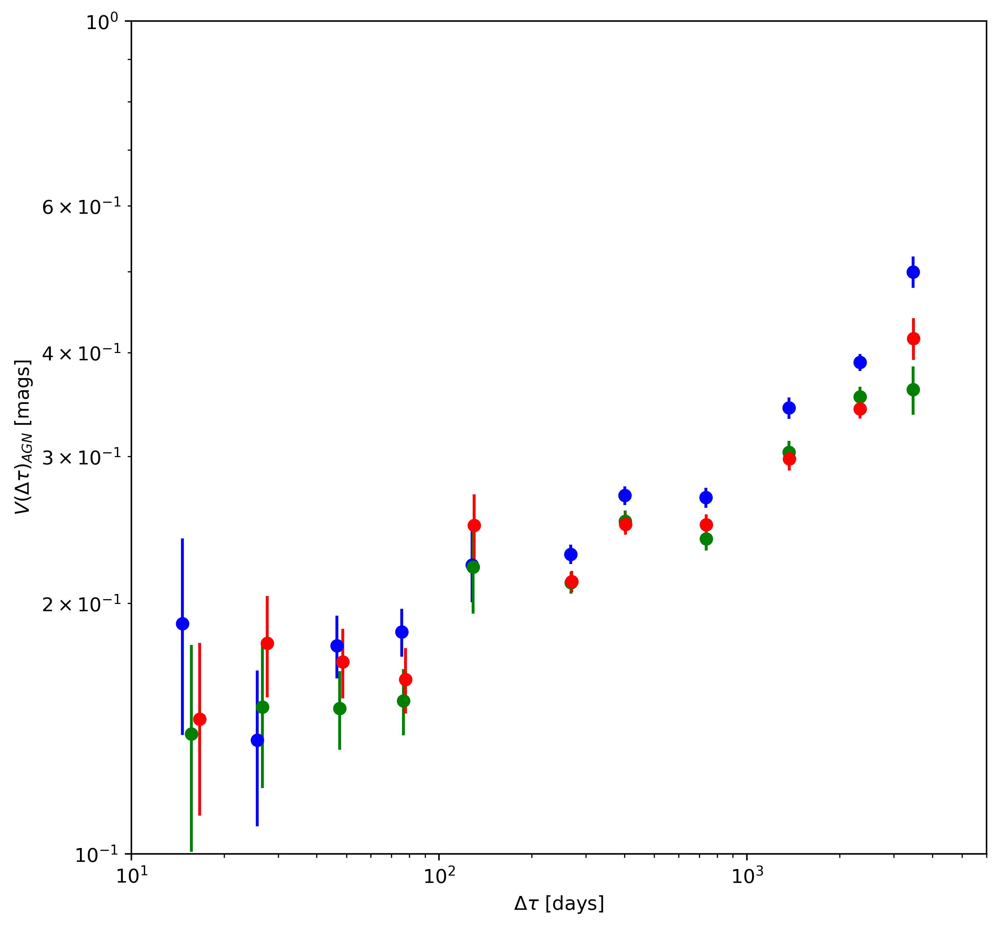

In [95]:
print(var_g_tau_std_SEM)

fig = plt.figure(1,figsize=(8,8),dpi=400)
#plt.errorbar(tau_mean, var_g_tau_median, yerr=var_g_tau_std_2side, xerr=tau_std, ecolor='blue', fmt='bo')
#plt.errorbar(tau_mean + 1,var_r_tau_median, yerr=var_r_tau_std_2side, xerr=tau_std, ecolor='green', fmt='go')
#plt.errorbar(tau_mean + 2,var_i_tau_median, yerr=var_i_tau_std_2side, xerr=tau_std, ecolor='red', fmt='ro')
#plt.errorbar(tau_mean, var_g_tau_bin, yerr=sigma_var_g_tau_bin, xerr=tau_std, ecolor='blue', fmt='bx')
#plt.errorbar(tau_mean + 1,var_r_tau_bin, yerr=sigma_var_r_tau_bin, xerr=tau_std, ecolor='green', fmt='gx')
#plt.errorbar(tau_mean + 2,var_i_tau_bin, yerr=sigma_var_i_tau_bin, xerr=tau_std, ecolor='red', fmt='rx')

plt.errorbar(tau_mean, var_g_tau_median, yerr=var_g_tau_std_SEM, xerr=tau_bin_SEM, ecolor='blue', fmt='bo')
plt.errorbar(tau_mean + 1,var_r_tau_median, yerr=var_r_tau_std_SEM, xerr=tau_bin_SEM, ecolor='green', fmt='go')
plt.errorbar(tau_mean + 2,var_i_tau_median, yerr=var_i_tau_std_SEM, xerr=tau_bin_SEM, ecolor='red', fmt='ro')
plt.errorbar(tau_mean, var_g_tau_bin, yerr=sigma_var_g_tau_bin, xerr=tau_bin_SEM, ecolor='blue', fmt='bx')
plt.errorbar(tau_mean + 1,var_r_tau_bin, yerr=sigma_var_r_tau_bin, xerr=tau_bin_SEM, ecolor='green', fmt='gx')
plt.errorbar(tau_mean + 2,var_i_tau_bin, yerr=sigma_var_i_tau_bin, xerr=tau_bin_SEM, ecolor='red', fmt='rx')

plt.xlim([10.0,6000.0])
plt.ylim([0.1,1.0])
plt.xlabel(r'$\Delta \tau$ [days]')
plt.ylabel(r'$V(\Delta \tau)_{AGN}$ [mags]')
plt.xscale('log')
plt.yscale('log')
plt.plot(tau_fit, var_g_tau_fit, 'b--', label=r'slope= 0.21148549 $\pm$ 0.00017222') #label=r'$\sigma_{AGN} = %.4f $'%np.absolute(popt_i2[2])
plt.plot(tau_fit, var_r_tau_fit, 'g--', label=r'slope= 0.19906279 $\pm$ 0.00025099')
plt.plot(tau_fit, var_i_tau_fit, 'r--', label=r'slope= 0.20310168 $\pm$ 0.00028487')
plt.plot(tau_fit, var_g_tau_bin_fit, 'b-')
plt.plot(tau_fit, var_r_tau_bin_fit, 'g-')
plt.plot(tau_fit, var_i_tau_bin_fit, 'r-')

plt.legend(loc='upper left')
fig.savefig('Variability_Delta_Tau_Rest_Frame_all_test1.png')


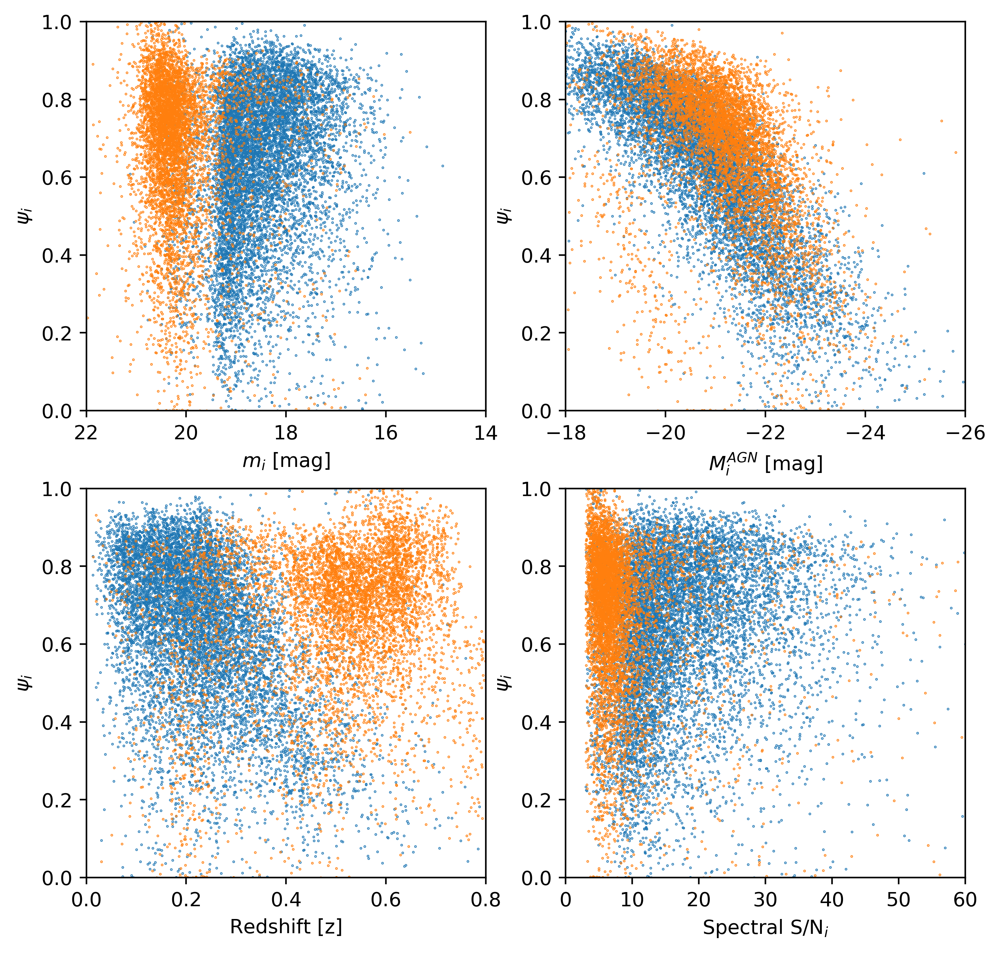

In [96]:
# Try impose upper limit in the difference in magnitudes (after the host-fraction correction) like 1.5 to 2 mags
# Test how the upper limits affect the slope
# Keep the plot with Pi/2 factor to the old work in 2014
# Focus on the new way with Li et al 2018 Equation 4 (leave out factor of 2*sigma^2 and Pi/2) set magnitude upper limit of delta-mag_upper = 1.0 the same as theirs.
# Taking out set 2 and compare the structure functions, throwing out bins with low number of points
#Check out Damped-Random Walk
# Try put the slope in years (2nd version)
# Make equal "spacing" for both structure functions instead!!!

fig, ax = plt.subplots(2, 2, figsize=(8,8),dpi=400)
ax[0,0].scatter(fiberMag_i1_cut, host_fraction_i1_cut, c='C0', s=0.1)
ax[0,0].scatter(fiberMag_i2_cut, host_fraction_i2_cut, c='C1', s=0.1)
ax[0,0].set_ylabel(r'$\psi_{i}$')
ax[0,0].set_xlabel(r'$m_i$ [mag]')
ax[0,0].set_xlim([22,14])
ax[0,0].set_ylim([0,1])

ax[0,1].scatter(mag_abs_agn_i1_cut, host_fraction_i1_cut, c='C0', s=0.1)
ax[0,1].scatter(mag_abs_agn_i2_cut, host_fraction_i2_cut, c='C1', s=0.1)
ax[0,1].set_ylabel(r'$\psi_{i}$')
ax[0,1].set_xlabel(r'$M^{AGN}_i$ [mag]')
ax[0,1].set_xlim([-18,-26])
ax[0,1].set_ylim([0,1])

ax[1,0].scatter(redshift1_cut, host_fraction_i1_cut, c='C0', s=0.1)
ax[1,0].scatter(redshift2_cut, host_fraction_i2_cut, c='C1', s=0.1)
ax[1,0].set_ylabel(r'$\psi_{i}$')
ax[1,0].set_xlabel(r'Redshift [z]')
ax[1,0].set_xlim([0,0.8])
ax[1,0].set_ylim([0,1])

ax[1,1].scatter(snMedian_i1_cut, host_fraction_i1_cut, c='C0', s=0.1)
ax[1,1].scatter(snMedian_i2_cut, host_fraction_i2_cut, c='C1', s=0.1)
ax[1,1].set_ylabel(r'$\psi_{i}$')
ax[1,1].set_xlabel(r'Spectral S/N$_i$')
ax[1,1].set_xlim([0,60])
ax[1,1].set_ylim([0,1])
plt.show()
fig.savefig('distribution_host_fraction_i_abs_in_parameter_space_all.png')  


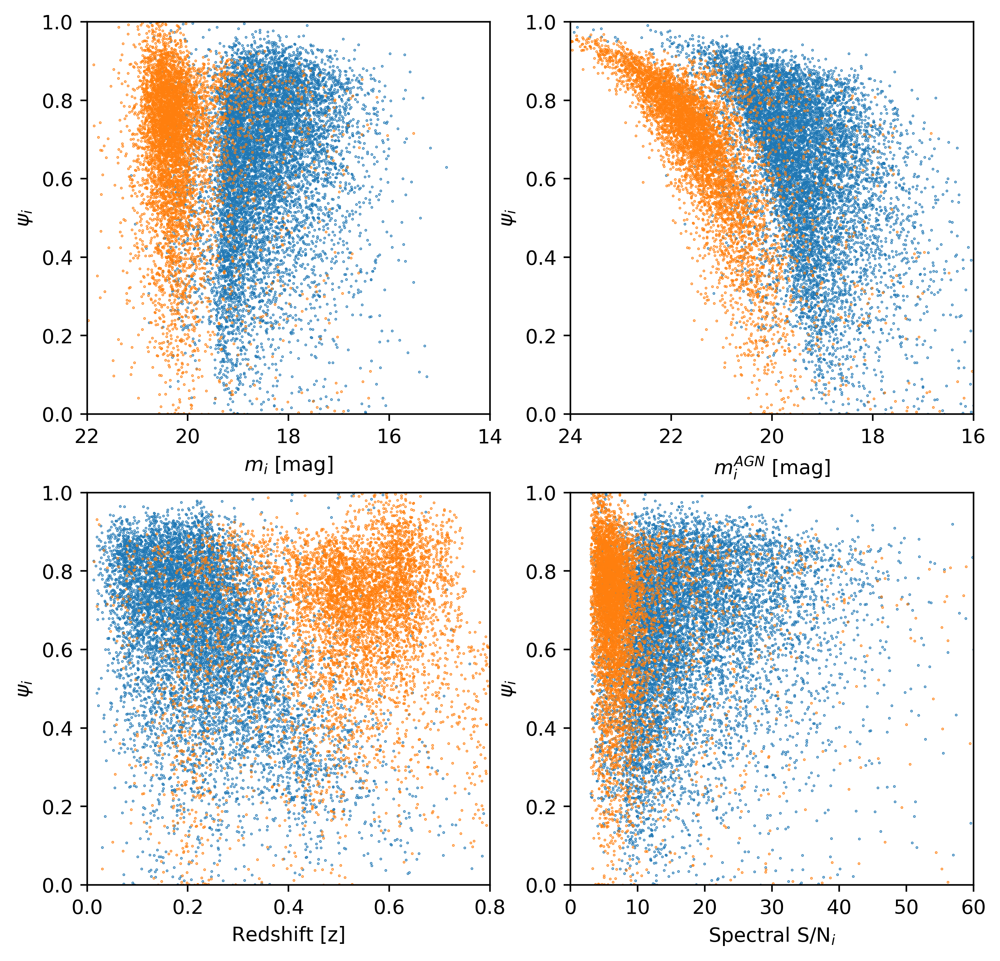

In [98]:
fig, ax = plt.subplots(2, 2, figsize=(8,8),dpi=400)
ax[0,0].scatter(fiberMag_i1_cut, host_fraction_i1_cut, c='C0', s=0.1)
ax[0,0].scatter(fiberMag_i2_cut, host_fraction_i2_cut, c='C1', s=0.1)
ax[0,0].set_ylabel(r'$\psi_{i}$')
ax[0,0].set_xlabel(r'$m_i$ [mag]')
ax[0,0].set_xlim([22,14])
ax[0,0].set_ylim([0,1])

ax[0,1].scatter(mag_agn_spec_i1_cut, host_fraction_i1_cut, c='C0', s=0.1)
ax[0,1].scatter(mag_agn_spec_i2_cut, host_fraction_i2_cut, c='C1', s=0.1)
ax[0,1].set_ylabel(r'$\psi_{i}$')
ax[0,1].set_xlabel(r'$m^{AGN}_i$ [mag]')
ax[0,1].set_xlim([24,16])
ax[0,1].set_ylim([0,1])

ax[1,0].scatter(redshift1_cut, host_fraction_i1_cut, c='C0', s=0.1)
ax[1,0].scatter(redshift2_cut, host_fraction_i2_cut, c='C1', s=0.1)
ax[1,0].set_ylabel(r'$\psi_{i}$')
ax[1,0].set_xlabel(r'Redshift [z]')
ax[1,0].set_xlim([0,0.8])
ax[1,0].set_ylim([0,1])

ax[1,1].scatter(snMedian_i1_cut, host_fraction_i1_cut, c='C0', s=0.1)
ax[1,1].scatter(snMedian_i2_cut, host_fraction_i2_cut, c='C1', s=0.1)
ax[1,1].set_ylabel(r'$\psi_{i}$')
ax[1,1].set_xlabel(r'Spectral S/N$_i$')
ax[1,1].set_xlim([0,60])
ax[1,1].set_ylim([0,1])
plt.show()
fig.savefig('distribution_host_fraction_i_in_parameter_space_all.png')  


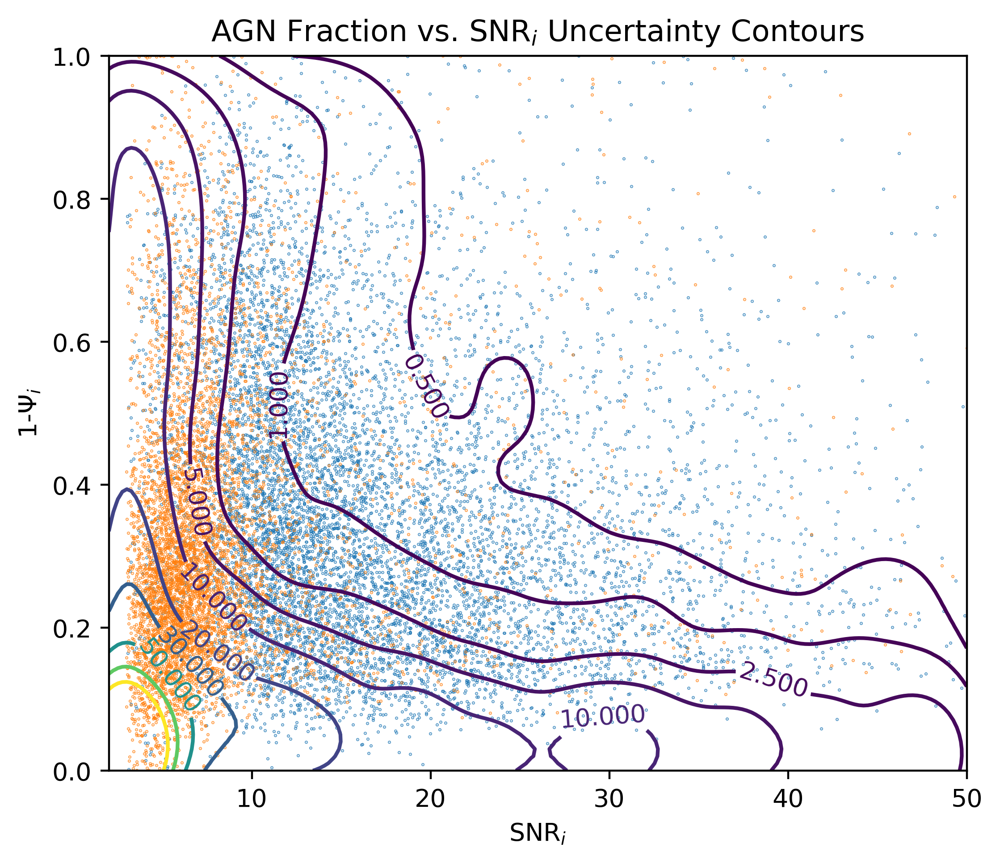

In [99]:

fig = plt.figure(figsize=(6,5), dpi=400)
left, bottom, width, height = 0.1, 0.1, 0.8, 0.8
ax = fig.add_axes([left, bottom, width, height]) 
ax.scatter(snMedian_i1_cut, 1.0 - host_fraction_i1_cut, color='C0', s=0.05)
ax.scatter(snMedian_i2_cut, 1.0 - host_fraction_i2_cut, color='C1', s=0.05)
cp = ax.contour(SNR_grid_new, 1.0 - psi_grid_new, matrix_test, levels =levelsAGN)
ax.set_xlim([2,50])
ax.set_ylim([0,1.0])
ax.clabel(cp, inline=True, fontsize=10)
ax.set_title(r'AGN Fraction vs. SNR$_i$ Uncertainty Contours')
ax.set_xlabel(r'SNR$_i$')
ax.set_ylabel(r'1-$\Psi_i$')
plt.show()
fig.savefig('psi_AGN_vs_SNR_uncertainty_contours_smooth_plus_scatters.png')


In [100]:
#[~np.isnan(var_i_all)]

def find_mag_edges(mag_all, number_of_bins = 14):
    #print(np.min(mag_all[~np.isnan(mag_all)]), len(mag_all[~np.isnan(mag_all)]))
    mag_edges = [np.floor(np.min(mag_all[~np.isnan(mag_all)]))]
    number_of_all_objects = len(mag_all)
    object_in_each_bin    = int(number_of_all_objects/number_of_bins)
    mag_all.sort()
    
    for i in range(0,number_of_bins):
        element = int(object_in_each_bin*(i+1))
        if (i == (number_of_bins - 1)):
            mag_edges.append(np.ceil(np.max(mag_all[~np.isnan(mag_all)])))
        else:
            mag_edges.append(mag_all[element])
            
    return mag_edges

mag_edges = find_mag_edges(mag_abs_agn_all, number_of_bins = 10)
print(mag_edges)

[-27.0, -22.5948349345756, -22.07293258358853, -21.693440467804297, -21.38082668524561, -21.09101437755173, -20.804365784087434, -20.449912958277313, -20.033502363147015, -19.40836235360227, -15.0]


In [221]:

mag_edges = [-28.0, -24.0, -23.0, -22.0, -21.0, -20.0, -19.0, -18.0, -14.0]

var_g_mag_mean = np.zeros(len(mag_edges)-1)
var_r_mag_mean = np.zeros(len(mag_edges)-1)
var_i_mag_mean = np.zeros(len(mag_edges)-1)

var_g_mag_median = np.zeros(len(mag_edges)-1)
var_r_mag_median = np.zeros(len(mag_edges)-1)
var_i_mag_median = np.zeros(len(mag_edges)-1)

var_g_mag_std = np.zeros(len(mag_edges)-1)
var_r_mag_std = np.zeros(len(mag_edges)-1)
var_i_mag_std = np.zeros(len(mag_edges)-1)

log_var_g_mag_mean = np.zeros(len(mag_edges)-1)
log_var_r_mag_mean = np.zeros(len(mag_edges)-1)
log_var_i_mag_mean = np.zeros(len(mag_edges)-1)

log_var_g_mag_median = np.zeros(len(mag_edges)-1)
log_var_r_mag_median = np.zeros(len(mag_edges)-1)
log_var_i_mag_median = np.zeros(len(mag_edges)-1)

log_var_g_mag_std = np.zeros(len(mag_edges)-1)
log_var_r_mag_std = np.zeros(len(mag_edges)-1)
log_var_i_mag_std = np.zeros(len(mag_edges)-1)

mag_bin_mean = np.zeros(len(mag_edges)-1)
mag_bin_median = np.zeros(len(mag_edges)-1)
mag_bin_std = np.zeros(len(mag_edges)-1)

sigma_clip_level = 2.5
sigma_clip_iteration = int(3.0)

def log_mag_relation(x, slope, y_interception):
    logy =  slope*x + y_interception
    return logy # x should be in log-scale

mag_fit = np.linspace(-28,-14, 28)


In [222]:
bootindex = np.random.randint
nboot     = 500

list_para_g_mag = list()
list_para_r_mag = list()
list_para_i_mag = list()

#def linear_linear_relation(x, slope, y_interception):
#    y_fit =  slope*x + y_interception
#    return y_fit
# loop over n bootstrap samples from the resids 

var_g_mag_mean      = np.zeros(len(mag_edges)-1)
var_g_mag_median    = np.zeros(len(mag_edges)-1)
var_g_mag_std      = np.zeros(len(mag_edges)-1)

var_r_mag_mean      = np.zeros(len(mag_edges)-1)
var_r_mag_median    = np.zeros(len(mag_edges)-1)
var_r_mag_std       = np.zeros(len(mag_edges)-1)

var_i_mag_mean      = np.zeros(len(mag_edges)-1)
var_i_mag_median    = np.zeros(len(mag_edges)-1)
var_i_mag_std       = np.zeros(len(mag_edges)-1)

var_g_mag_std_SEM   = np.zeros(len(mag_edges)-1)
var_r_mag_std_SEM   = np.zeros(len(mag_edges)-1)
var_i_mag_std_SEM   = np.zeros(len(mag_edges)-1)

magabs_mean      = np.zeros(len(mag_edges)-1)
magabs_median    = np.zeros(len(mag_edges)-1)
magabs_std       = np.zeros(len(mag_edges)-1)
magabs_bin_SEM   = np.zeros(len(mag_edges)-1)

#delta_tau_rest_g_all = delta_tau_rest_all[np.where()]

for i in range(nboot): 
    for l in range(0,len(mag_edges)-1):
        good_mag = np.where((mag_abs_agn_all > mag_edges[l]) & (mag_abs_agn_all <= mag_edges[l+1]) & (mag_abs_agn_all != np.nan))
        good_mag_boot  = bootindex(0,len(good_mag[0])-1,len(good_mag[0])) 

        mag_abs_boot = mag_abs_agn_all[good_mag][good_mag_boot]
        var_g_mag_boot = var_g_all[good_mag][good_mag_boot]
        var_r_mag_boot = var_r_all[good_mag][good_mag_boot]
        var_i_mag_boot = var_i_all[good_mag][good_mag_boot]
                                                                     
        magabs_mean[l], magabs_median[l], magabs_std[l] = sigma_clipped_stats(mag_abs_boot, sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
        magabs_bin_SEM[l] = sem(mag_abs_boot, nan_policy='omit')
    
        var_g_mag_mean[l], var_g_mag_median[l], var_g_mag_std[l] = sigma_clipped_stats(var_g_mag_boot, sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
        var_r_mag_mean[l], var_r_mag_median[l], var_r_mag_std[l] = sigma_clipped_stats(var_r_mag_boot, sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')
        var_i_mag_mean[l], var_i_mag_median[l], var_i_mag_std[l] = sigma_clipped_stats(var_i_mag_boot, sigma=sigma_clip_level, maxiters=sigma_clip_iteration, cenfunc='median')    
        var_g_mag_std_SEM[l] = sem(np.log10(var_g_mag_boot), nan_policy='omit')
        var_r_mag_std_SEM[l] = sem(np.log10(var_r_mag_boot), nan_policy='omit')
        var_i_mag_std_SEM[l] = sem(np.log10(var_i_mag_boot), nan_policy='omit')
        
    pf_g_mag, pc_g_mag = curve_fit(log_mag_relation, magabs_mean[~np.isnan(np.log10(var_g_mag_mean))], np.log10(var_g_mag_mean[~np.isnan(np.log10(var_g_mag_mean))]), sigma=var_g_mag_std_SEM[~np.isnan(np.log10(var_g_mag_mean))], absolute_sigma=True, maxfev=300) 
    pf_r_mag, pc_r_mag = curve_fit(log_mag_relation, magabs_mean[~np.isnan(np.log10(var_r_mag_mean))], np.log10(var_r_mag_mean[~np.isnan(np.log10(var_r_mag_mean))]), sigma=var_r_mag_std_SEM[~np.isnan(np.log10(var_r_mag_mean))], absolute_sigma=True, maxfev=300) 
    pf_i_mag, pc_i_mag = curve_fit(log_mag_relation, magabs_mean[~np.isnan(np.log10(var_i_mag_mean))], np.log10(var_i_mag_mean[~np.isnan(np.log10(var_i_mag_mean))]), sigma=var_i_mag_std_SEM[~np.isnan(np.log10(var_i_mag_mean))], absolute_sigma=True, maxfev=300) 

    list_para_g_mag.append(pf_g_mag)
    list_para_r_mag.append(pf_r_mag)
    list_para_i_mag.append(pf_i_mag)

list_para_g_mag = np.array(list_para_g_mag)
list_para_r_mag = np.array(list_para_r_mag)
list_para_i_mag = np.array(list_para_i_mag)

slope_g_mag = np.average(list_para_g_mag[:,0])
slope_r_mag = np.average(list_para_r_mag[:,0])
slope_i_mag = np.average(list_para_i_mag[:,0])

slope_g_mag_err = np.std(list_para_g_mag[:,0])
slope_r_mag_err = np.std(list_para_r_mag[:,0])
slope_i_mag_err = np.std(list_para_i_mag[:,0])

intc_g_mag = np.average(list_para_g_mag[:,1])
intc_r_mag = np.average(list_para_r_mag[:,1])
intc_i_mag = np.average(list_para_i_mag[:,1])

intc_g_mag_err = np.std(list_para_g_mag[:,1])
intc_r_mag_err = np.std(list_para_r_mag[:,1])
intc_i_mag_err = np.std(list_para_i_mag[:,1])

var_g_mag_fit = 10.0**log_mag_relation(mag_fit, slope_g_mag, intc_g_mag)
var_r_mag_fit = 10.0**log_mag_relation(mag_fit, slope_r_mag, intc_r_mag)
var_i_mag_fit = 10.0**log_mag_relation(mag_fit, slope_i_mag, intc_i_mag)



In [218]:
#plt.hist(mag_abs_agn_all)
print(popt_var_g_mag, pcov_var_g_mag)
print(popt_var_r_mag, pcov_var_r_mag)
print(popt_var_i_mag, pcov_var_i_mag)
print(len(var_g_all), len(mag_abs_agn_all))

print(np.std(list_para_g_mag[:,0]))
#plt.hist(list_para_g_mag[:,0])
#plt.hist(list_para_r_mag[:,0])
#plt.hist(list_para_i_mag[:,0])

#plt.hist(list_para_g_mag[:,1])
#plt.hist(list_para_r_mag[:,1])
#plt.hist(list_para_i_mag[:,1])

[ 0.02611885 -0.00439676] [[5.07453368e-05 1.04650345e-03]
 [1.04650345e-03 2.19634784e-02]]
[0.03750108 0.23645633] [[6.03508415e-05 1.25117487e-03]
 [1.25117487e-03 2.64865066e-02]]
[0.04876338 0.46558497] [[3.70012399e-05 7.72865543e-04]
 [7.72865543e-04 1.64462332e-02]]
8689 8689
0.004151245640343497


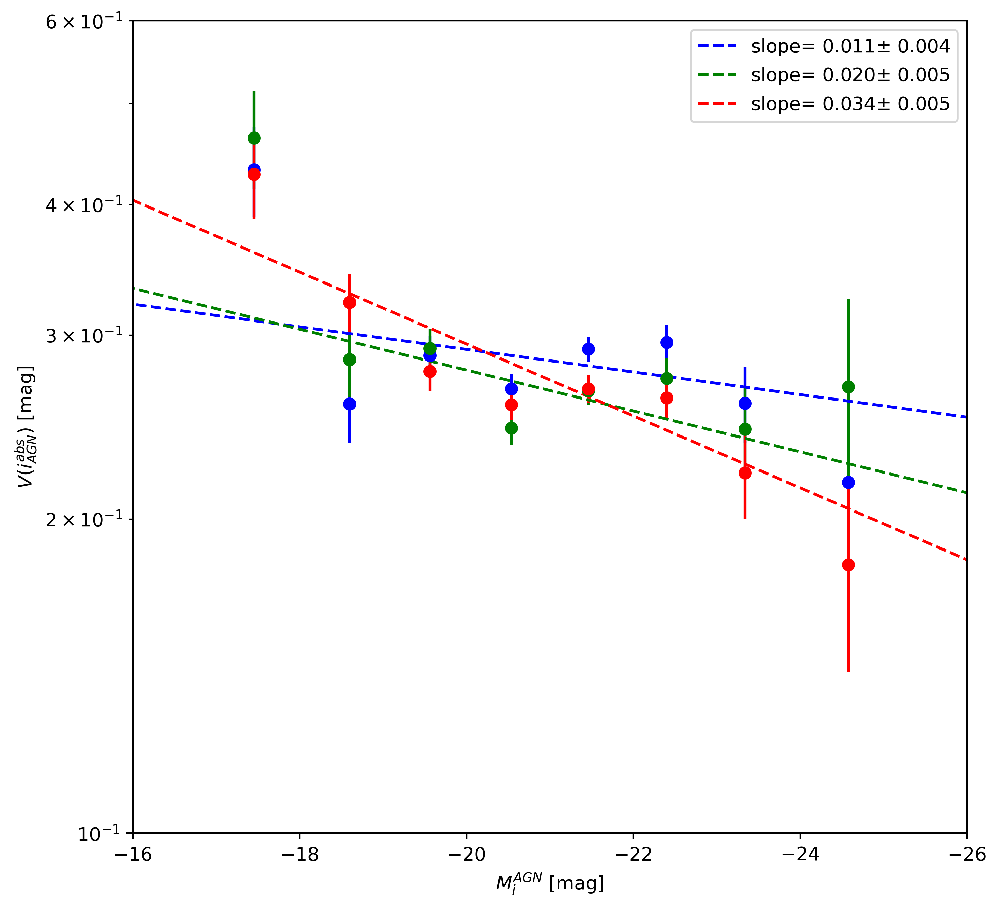

In [225]:
    
fig = plt.figure(1,figsize=(8,8),dpi=400)
#plt.errorbar(mag_bin_mean, var_g_mag_median, yerr=var_g_mag_std_2side, xerr=mag_bin_std, ecolor='blue', fmt='bo')
#plt.errorbar(mag_bin_mean, var_r_mag_median, yerr=var_r_mag_std_2side, xerr=mag_bin_std, ecolor='green', fmt='go')
#plt.errorbar(mag_bin_mean, var_i_mag_median, yerr=var_i_mag_std_2side, xerr=mag_bin_std, ecolor='red', fmt='ro')
plt.errorbar(magabs_mean, var_g_mag_mean, yerr=var_g_mag_std_SEM, xerr=magabs_bin_SEM, ecolor='blue', fmt='bo')
plt.errorbar(magabs_mean, var_r_mag_mean, yerr=var_r_mag_std_SEM, xerr=magabs_bin_SEM, ecolor='green', fmt='go')
plt.errorbar(magabs_mean, var_i_mag_mean, yerr=var_i_mag_std_SEM, xerr=magabs_bin_SEM, ecolor='red', fmt='ro')
plt.xlim([-16.0,-26.0])
plt.ylim([0.1,0.6])
plt.xlabel(r'$M_i^{AGN}$ [mag]')
plt.ylabel(r'$V(i^{abs}_{AGN})$ [mag]')
plt.yscale('log')
plt.plot(mag_fit, var_g_mag_fit, 'b--', label=r'slope= %.3f'%slope_g_mag +'$\pm$ %.3f'%slope_g_mag_err)
plt.plot(mag_fit, var_r_mag_fit, 'g--', label=r'slope= %.3f'%slope_r_mag +'$\pm$ %.3f'%slope_r_mag_err)
plt.plot(mag_fit, var_i_mag_fit, 'r--', label=r'slope= %.3f'%slope_i_mag +'$\pm$ %.3f'%slope_i_mag_err)
plt.legend(loc='upper right')
fig.savefig('Variability_Delta_Mag_Rest_Frame_all_boot.png')

# Try with luminosity (bolo) log10(L_bolo) instead of M_abs


In [105]:
print(var_g_mag_SEM)


[0.00941447 0.00951722 0.00993875 0.00942977 0.00916494 0.00916941
 0.00963766 0.01029475 0.01428482 0.01305045]


In [106]:

################################################################################################################################################################################################################################
#### Saving tables of parameters 

all_data_cut_cont1 = np.c_[objid1_cut_cont, ra1_cut_cont, dec1_cut_cont, umag1_cut_cont, err_u1_cut_cont, gmag1_cut_cont, err_g1_cut_cont, rmag1_cut_cont, err_r1_cut_cont,\
                           imag1_cut_cont, err_i1_cut_cont, zmag1_cut_cont, err_z1_cut_cont, plate1_cut_cont, fiberid1_cut_cont, redshift1_cut_cont, \
                           snMedian1_cut_cont, snMedian_u1_cut_cont, snMedian_g1_cut_cont, snMedian_r1_cut_cont, snMedian_i1_cut_cont, snMedian_z1_cut_cont, \
                           mjd_plate1_cut_cont, mjd_phot1_cut_cont, mjd_u1_cut_cont, mjd_g1_cut_cont, mjd_r1_cut_cont, mjd_i1_cut_cont, mjd_z1_cut_cont, \
                           fiberMag_u1_cut_cont, fiberMagErr_u1_cut_cont, fiberMag_g1_cut_cont, fiberMagErr_g1_cut_cont, fiberMag_r1_cut_cont, fiberMagErr_r1_cut_cont, \
                           fiberMag_i1_cut_cont, fiberMagErr_i1_cut_cont, fiberMag_z1_cut_cont, fiberMagErr_z1_cut_cont, fiberFlux_u1_cut_cont, fiberFluxIvar_u1_cut_cont, \
                           fiberFlux_g1_cut_cont, fiberFluxIvar_g1_cut_cont, fiberFlux_r1_cut_cont, fiberFluxIvar_r1_cut_cont, fiberFlux_i1_cut_cont, fiberFluxIvar_i1_cut_cont, \
                           fiberFlux_z1_cut_cont, fiberFluxIvar_z1_cut_cont, spectroFlux_u1_cut_cont, spectroFluxIvar_u1_cut_cont, spectroFlux_g1_cut_cont, spectroFluxIvar_g1_cut_cont, \
                           spectroFlux_r1_cut_cont, spectroFluxIvar_r1_cut_cont, spectroFlux_i1_cut_cont, spectroFluxIvar_i1_cut_cont, spectroFlux_z1_cut_cont, spectroFluxIvar_z1_cut_cont, \
                           an11_cut_cont, an21_cut_cont, an31_cut_cont, an41_cut_cont, an51_cut_cont, an61_cut_cont, an71_cut_cont, an81_cut_cont, an91_cut_cont, an101_cut_cont, \
                           gn11_cut_cont, gn21_cut_cont, gn31_cut_cont, gn41_cut_cont, gn51_cut_cont, kcorr_u1_cut_cont, kcorr_g1_cut_cont, kcorr_r1_cut_cont, kcorr_i1_cut_cont, kcorr_z1_cut_cont, \
                           absmag_u1_cut_cont, absmag_g1_cut_cont, absmag_r1_cut_cont, absmag_i1_cut_cont, absmag_z1_cut_cont, extc_u1_cut_cont, extc_g1_cut_cont, extc_r1_cut_cont, extc_i1_cut_cont, extc_z1_cut_cont, \
                           sigma_ha1_cut_cont, sigma_ha_err1_cut_cont, sigma_hb1_cut_cont, sigma_hb_err1_cut_cont, sigma_best1_cut_cont, sigma_best_err1_cut_cont, sigma_ha_archive1_cut_cont, sigma_ha_archive_err1_cut_cont, \
                           sigma_hb_archive1_cut_cont, sigma_hb_archive_err1_cut_cont, peak_ha1_cut_cont, peak_ha_err1_cut_cont, peak_hb1_cut_cont, peak_hb_err1_cut_cont, \
                           line_flux_ha1_cut_cont, line_flux_ha_err1_cut_cont, line_flux_hb1_cut_cont, line_flux_hb_err1_cut_cont, fwhm_kms1_cut_cont, fwhm_kms_err1_cut_cont, \
                           z_fit_ha1_cut_cont, z_fit_hb1_cut_cont, z_fit_best1_cut_cont, z_agn1_cut_cont, z_agn_err1_cut_cont, line_flux_ha_archive1_cut_cont, line_flux_ha_archive_err1_cut_cont, line_flux_hb_archive1_cut_cont, line_flux_hb_archive_err1_cut_cont, \
                           kcor_krc_g1_cut_cont, kcor_krc_r1_cut_cont, kcor_krc_i1_cut_cont, g_abs1_cut_cont, r_abs1_cut_cont, i_abs1_cut_cont, mag_abs_agn_i1_cut_cont, \
                           mag_diff_g1_corrected_cont, mag_diff_r1_corrected_cont, mag_diff_i1_corrected_cont, sigma_phot_g1_cut_cont, sigma_phot_r1_cut_cont, sigma_phot_i1_cut_cont, \
                           lambdaL5100_agn1_cut_cont, Luminosity_B_AGN1_cut_cont, Luminosity_B_AGN_PSP1_cut_cont, absmag_B_AGN1_cut_cont, absmag_B_AGN_PSP1_cut_cont, M_BH_51001_cut_cont, host_fraction_g1_cut_cont, host_fraction_r1_cut_cont, host_fraction_i1_cut_cont,\
                           psi_deviation_g1_cut_cont, psi_deviation_r1_cut_cont, psi_deviation_i1_cut_cont, delta_mag_agn_g1_cut_cont, delta_mag_agn_r1_cut_cont, delta_mag_agn_i1_cut_cont]

np.savetxt('tables/AGN_fitted_de-offset_data_set1_v7_with_LB_MassBH_Psi_Uncertainty.dat', all_data_cut_cont1) #, 
           #fmt="%12.6f %12.6f %12.6f %12.6f %12.6f %12.6f")

################################################################################################################################################################################################################################

all_data_cut_cont2 = np.c_[objid2_cut_cont, ra2_cut_cont, dec2_cut_cont, umag2_cut_cont, err_u2_cut_cont, gmag2_cut_cont, err_g2_cut_cont, rmag2_cut_cont, err_r2_cut_cont,\
                           imag2_cut_cont, err_i2_cut_cont, zmag2_cut_cont, err_z2_cut_cont, plate2_cut_cont, fiberid2_cut_cont, redshift2_cut_cont, \
                           snMedian2_cut_cont, snMedian_u2_cut_cont, snMedian_g2_cut_cont, snMedian_r2_cut_cont, snMedian_i2_cut_cont, snMedian_z2_cut_cont, \
                           mjd_plate2_cut_cont, mjd_phot2_cut_cont, mjd_u2_cut_cont, mjd_g2_cut_cont, mjd_r2_cut_cont, mjd_i2_cut_cont, mjd_z2_cut_cont, \
                           fiberMag_u2_cut_cont, fiberMagErr_u2_cut_cont, fiberMag_g2_cut_cont, fiberMagErr_g2_cut_cont, fiberMag_r2_cut_cont, fiberMagErr_r2_cut_cont, \
                           fiberMag_i2_cut_cont, fiberMagErr_i2_cut_cont, fiberMag_z2_cut_cont, fiberMagErr_z2_cut_cont, fiberFlux_u2_cut_cont, fiberFluxIvar_u2_cut_cont, \
                           fiberFlux_g2_cut_cont, fiberFluxIvar_g2_cut_cont, fiberFlux_r2_cut_cont, fiberFluxIvar_r2_cut_cont, fiberFlux_i2_cut_cont, fiberFluxIvar_i2_cut_cont, \
                           fiberFlux_z2_cut_cont, fiberFluxIvar_z2_cut_cont, spectroFlux_u2_cut_cont, spectroFluxIvar_u2_cut_cont, spectroFlux_g2_cut_cont, spectroFluxIvar_g2_cut_cont, \
                           spectroFlux_r2_cut_cont, spectroFluxIvar_r2_cut_cont, spectroFlux_i2_cut_cont, spectroFluxIvar_i2_cut_cont, spectroFlux_z2_cut_cont, spectroFluxIvar_z2_cut_cont, \
                           an12_cut_cont, an22_cut_cont, an32_cut_cont, an42_cut_cont, an52_cut_cont, an62_cut_cont, an72_cut_cont, an82_cut_cont, an92_cut_cont, an102_cut_cont, \
                           gn12_cut_cont, gn22_cut_cont, gn32_cut_cont, gn42_cut_cont, gn52_cut_cont, kcorr_u2_cut_cont, kcorr_g2_cut_cont, kcorr_r2_cut_cont, kcorr_i2_cut_cont, kcorr_z2_cut_cont, \
                           absmag_u2_cut_cont, absmag_g2_cut_cont, absmag_r2_cut_cont, absmag_i2_cut_cont, absmag_z2_cut_cont, extc_u2_cut_cont, extc_g2_cut_cont, extc_r2_cut_cont, extc_i2_cut_cont, extc_z2_cut_cont, \
                           sigma_ha2_cut_cont, sigma_ha_err2_cut_cont, sigma_hb2_cut_cont, sigma_hb_err2_cut_cont, sigma_best2_cut_cont, sigma_best_err2_cut_cont, sigma_ha_archive2_cut_cont, sigma_ha_archive_err2_cut_cont, \
                           sigma_hb_archive2_cut_cont, sigma_hb_archive_err2_cut_cont, peak_ha2_cut_cont, peak_ha_err2_cut_cont, peak_hb2_cut_cont, peak_hb_err2_cut_cont, \
                           line_flux_ha2_cut_cont, line_flux_ha_err2_cut_cont, line_flux_hb2_cut_cont, line_flux_hb_err2_cut_cont, fwhm_kms2_cut_cont, fwhm_kms_err2_cut_cont, \
                           z_fit_ha2_cut_cont, z_fit_hb2_cut_cont, z_fit_best2_cut_cont, z_agn2_cut_cont, z_agn_err2_cut_cont, line_flux_ha_archive2_cut_cont, line_flux_ha_archive_err2_cut_cont, line_flux_hb_archive2_cut_cont, line_flux_hb_archive_err2_cut_cont, \
                           kcor_krc_g2_cut_cont, kcor_krc_r2_cut_cont, kcor_krc_i2_cut_cont, g_abs2_cut_cont, r_abs2_cut_cont, i_abs2_cut_cont, mag_abs_agn_i2_cut_cont, \
                           mag_diff_g2_corrected_cont, mag_diff_r2_corrected_cont, mag_diff_i2_corrected_cont, sigma_phot_g2_cut_cont, sigma_phot_r2_cut_cont, sigma_phot_i2_cut_cont, \
                           lambdaL5100_agn2_cut_cont, Luminosity_B_AGN2_cut_cont, Luminosity_B_AGN_PSP2_cut_cont, absmag_B_AGN2_cut_cont, absmag_B_AGN_PSP2_cut_cont, M_BH_51002_cut_cont, host_fraction_g2_cut_cont, host_fraction_r2_cut_cont, host_fraction_i2_cut_cont,\
                           psi_deviation_g2_cut_cont, psi_deviation_r2_cut_cont, psi_deviation_i2_cut_cont, delta_mag_agn_g2_cut_cont, delta_mag_agn_r2_cut_cont, delta_mag_agn_i2_cut_cont]

np.savetxt('tables/AGN_fitted_de-offset_data_set2_v7_with_LB_MassBH_Psi_Uncertainty.dat', all_data_cut_cont2) #, 
           #fmt="%12.6f %12.6f %12.6f %12.6f %12.6f %12.6f")

################################################################################################################################################################################################################################

In [107]:
# binning the entire set like Li et al 2018's Eq.8


In [108]:
def log_M_BH_Park2015(lambdaL5100, sigma_hb):
    sigma_hb_kms = sigma_hb*(2.99792458e+5)/4862.68
    log_M_BH_Park2015_est = 7.536 + 0.519*np.log10(lambdaL5100/1.0e+44) + 2.0*np.log10(sigma_hb_kms/1000.0)
    return log_M_BH_Park2015_est

def R_Edd_cal5100(lambdaL5100, sigma_hb):
    M_BH      =  10.0**(log_M_BH_Park2015(lambdaL5100, sigma_hb))
    L_edd_cal = (1.20e+38)*M_BH # erg/s
    L_bolo    = lambdaL5100*9.0
    r_edd_est = L_bolo/L_edd_cal
    return r_edd_est

In [264]:
lambdaL5100_sim      = np.linspace(1.0e+39, 1.0e47, 1000)
sigma_hb10000_sim    = np.zeros(len(lambdaL5100_sim)) + 68.88
sigma_hb1500_sim     = np.zeros(len(lambdaL5100_sim)) + 10.33
r_edd10000_sim       = R_Edd_cal5100(lambdaL5100_sim, sigma_hb10000_sim)
r_edd1500_sim        = R_Edd_cal5100(lambdaL5100_sim, sigma_hb1500_sim)
log_m_bh10000_sim    = log_M_BH_Park2015(lambdaL5100_sim, sigma_hb10000_sim)
log_m_bh1500_sim     = log_M_BH_Park2015(lambdaL5100_sim, sigma_hb1500_sim)

redshift_sim        = np.linspace(0.0,1.0, 100)
d_l_sim             = (cosmo.luminosity_distance(redshift_sim).value)*cm_in_Mpc
log_l_bolo_sim      = np.log10(5.18*4.0*np.pi*(d_l_sim**2.0)*890.0*(6.7e-9)*10.0**(0.4*(-20.5)))
log_M_BH1500_sim    = log_M_BH_Park2015((10.0**log_l_bolo_sim)/9.0, log_l_bolo_sim*0.0 + 10.33)
log_r_edd_bound_sim = np.log10(R_Edd_cal5100((10.0**log_l_bolo_sim)/9.0, log_l_bolo_sim*0.0 + 68.88))

lambdaL5100_agn_all_cut_cont  = np.concatenate((lambdaL5100_agn1_cut_cont[good_var1], lambdaL5100_agn2_cut_cont[good_var2]))

Luminosity_B_AGN_all_cut_cont     = np.concatenate((Luminosity_B_AGN1_cut_cont[good_var1], Luminosity_B_AGN2_cut_cont[good_var2]))
Luminosity_B_AGN_PSP_all_cut_cont = np.concatenate((Luminosity_B_AGN_PSP1_cut_cont[good_var1], Luminosity_B_AGN_PSP2_cut_cont[good_var2]))
absmag_B_AGN_all_cut_cont         = np.concatenate((absmag_B_AGN1_cut_cont[good_var1], absmag_B_AGN2_cut_cont[good_var2]))
absmag_B_AGN_PSP_all_cut_cont     = np.concatenate((absmag_B_AGN_PSP1_cut_cont[good_var1], absmag_B_AGN_PSP2_cut_cont[good_var2]))

sigma_hb_all_cut_cont         = np.concatenate((sigma_hb1_cut_cont[good_var1],sigma_hb2_cut_cont[good_var2]))
fwhm_kms_all_cut_cont         = sigma_hb_all_cut_cont*2.35*(2.99792458e+5)/4862.68

#M_BH_5100_all_cut_cont        = np.concatenate((M_BH_51001_cut_cont, M_BH_51002_cut_cont))

M_BH_5100_all_cut_cont        = 10.0**(log_M_BH_Park2015(lambdaL5100_agn_all_cut_cont, sigma_hb_all_cut_cont))

Luminosity_bolo_all_cut_cont        = 5.18*np.concatenate((Luminosity_B_AGN1_cut_cont[good_var1], Luminosity_B_AGN2_cut_cont[good_var2]))
Luminosity_bolo_all_f5100_cut_cont  = 9.0*lambdaL5100_agn_all_cut_cont

Luminosity_edd_all_cut_cont   = (1.20e+38)*M_BH_5100_all_cut_cont
R_edd_all_cut_cont            = Luminosity_bolo_all_cut_cont/Luminosity_edd_all_cut_cont

log_M_BH_all                  = log_M_BH_Park2015(lambdaL5100_agn_all_cut_cont, sigma_hb_all_cut_cont)
redshift_all_cut_cont         = np.concatenate((redshift1_cut_cont[good_var1],redshift2_cut_cont[good_var2]))

Luminosity_bolo_all_cut_cont_5100_test = 9.0*lambdaL5100_agn_all_cut_cont
k_bol_L5100                            = 40.0*((lambdaL5100_agn_all_cut_cont)/1.0e+42)**(-0.2) 
Luminosity_bolo_all_cut_cont_5100_test = k_bol_L5100*lambdaL5100_agn_all_cut_cont

mag_abs_agn_i_all_cut_cont             = np.concatenate((mag_abs_agn_i1_cut_cont[good_var1],mag_abs_agn_i2_cut_cont[good_var2]))


B_zero_point = 6.7e-9 # erg/s/cm2/A at M_B = 0 
B_width      = 890.0 # angstrom
d_l_all_cut_cont = (cosmo.luminosity_distance(redshift_all_cut_cont).value)*cm_in_Mpc
d_l1_cut_cont = (cosmo.luminosity_distance(redshift1_cut_cont).value)*cm_in_Mpc

Mag_B_agn_all_cut_cont = -2.5*np.log10((Luminosity_B_AGN_all_cut_cont/(4.0*np.pi*d_l_all_cut_cont**2.0))/(B_zero_point*B_width))

Mag_B_agn1_cut_cont = -2.5*np.log10((Luminosity_B_AGN1_cut_cont/(4.0*np.pi*d_l1_cut_cont**2.0))/(B_zero_point*B_width))
Mag_B_agn1_cut_cont_abs = Mag_B_agn1_cut_cont + 5.0 - 5.0*np.log10(d_l1_cut_cont/cm_in_Mpc*1.0e+6)

################################################################################################################################################################################################################################

8689 8689 8689 8689 8689


(array([102., 278., 343., 406., 376., 352., 418., 357., 384., 317., 325.,
        315., 276., 280., 245., 238., 215., 178., 150., 168., 137., 144.,
        133., 122., 111.,  81.,  87.,  77.,  74.,  60.,  49.,  61.,  44.,
         39.,  44.,  27.,  36.,  32.,  26.,  30.,  15.,  22.,  23.,  18.,
         26.,  12.,  15.,   7.,   7.,  14.,   8.,   8.,   7.,   9.,   5.,
          4.,   9.,   5.,   0.,   3.,   2.,   0.,   0.,   2.,   1.,   1.,
          1.,   1.,   0.,   0.,   0.,   1.,   0.,   0.,   1.,   0.,   0.,
          0.,   0.,   0.,   0.,   1.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          1.]),
 array([2.41290154e-03, 2.65231672e-02, 5.06334329e-02, 7.47436985e-02,
        9.88539642e-02, 1.22964230e-01, 1.47074496e-01, 1.71184761e-01,
        1.95295027e-01, 2.19405292e-01, 2.43515558e-01, 2.67625824e-01,
        2.91736089e-01, 3.15846355e-01, 3.39956621e-01, 3.64066886e-01,
        3.88177152e-01, 4.1228

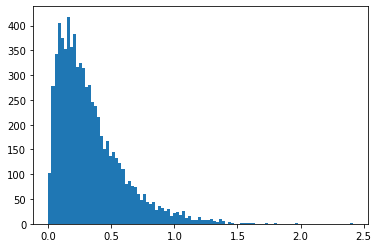

In [270]:
print(len(R_edd_all_cut_cont), len(log_M_BH_all), len(var_g_all), len(log_M_BH_all), len(sigma_hb_all_cut_cont))
#plt.scatter(log_M_BH_all, np.log10(R_edd_all_cut_cont), s=0.1)
#plt.hist(sigma_hb_all_cut_cont[np.where(sigma_hb_all_cut_cont >= 8.0)], bins=100)
#trim = np.where(sigma_hb_all_cut_cont >= 8.0)

#print(delta_tau_rest_all)
amp_g_all = var_g_all/((delta_tau_rest_all/365.0)**0.193)
amp_r_all = var_r_all/((delta_tau_rest_all/365.0)**0.204)
amp_i_all = var_i_all/((delta_tau_rest_all/365.0)**0.188)

plt.hist(amp_g_All, bins=100)

In [110]:

id_full, ra_full, dec_full,	mjd_full, plate_full, fiber_full, Mi_agn_full,	z_full,	z_err_full,	dmg_ful, dmr_full,	dmi_full,\
sn_g_full,	sn_r_full,	sn_i_full,	sigma_g_full, sigma_r_full,	sigma_i_full, airmass_full,	B_intrinsic_full, V_intrinsic_full,	BV_intrinsic_full,\
BV_error_full,	log_l5100_full,	log_lbol_full,	fwhm_kms_full,	log_mass_park2014 = np.loadtxt('tables/agn_fulldata.dat', unpack=True, comments='#', delimiter=' ')
#R_edd_previous

log_M_BH_Park2015_est = log_M_BH_Park2015(lambdaL5100_agn1_cut_cont, sigma_hb1_cut_cont)  
log_M_BH_Park2015_est_z_uncor = log_M_BH_Park2015(lambdaL5100_agn1_cut_cont, sigma_hb1_cut_cont*(1.0 + redshift1_cut_cont))  
log_M_BH_full = log_M_BH_Park2015(10.0**log_l5100_full, (fwhm_kms_full/2.3548)*4862.68/(2.99792458e+5))

ra_full_match = np.zeros(len(ra_full))
dec_full_match = np.zeros(len(ra_full))
log_mass_SMBH_match = np.zeros(len(ra_full))
log_mass_SMBH_match_Park2015 = np.zeros(len(ra_full))
log_mass_SMBH_match_Park2015_uncor = np.zeros(len(ra_full))
log_l5100_set1_match = np.zeros(len(ra_full))
fwhm_kms_set1_match  = np.zeros(len(ra_full))
fwhm_kms_set1_match_uncor  = np.zeros(len(ra_full))
redshift_match  = np.zeros(len(ra_full))
mag_abs_agn_i_all_match = np.zeros(len(ra_full))
Mag_B_agn_match = np.zeros(len(ra_full))

for m in range (0, len(ra_full)):
    distance_match = np.sqrt((ra1_cut_cont - ra_full[m])**2.0 + (dec1_cut_cont - dec_full[m])**2.0)
    get_distance   = np.where(distance_match == np.min(distance_match))[0]
    log_mass_SMBH_match[m]                = np.log10(M_BH_51001_cut_cont[get_distance])
    ra_full_match[m]                      = ra1_cut_cont[get_distance]
    dec_full_match[m]                     = dec1_cut_cont[get_distance]
    log_mass_SMBH_match_Park2015[m]       = log_M_BH_Park2015_est[get_distance]
    log_mass_SMBH_match_Park2015_uncor[m] = log_M_BH_Park2015_est_z_uncor[get_distance]
    log_l5100_set1_match[m]               = np.log10(lambdaL5100_agn1_cut_cont[get_distance])
    fwhm_kms_set1_match[m]                = 2.3548*sigma_hb1_cut_cont[get_distance]*(2.99792458e+5)/4862.68
    fwhm_kms_set1_match_uncor[m]          = 2.3548*sigma_hb1_cut_cont[get_distance]*(1.0 + redshift1_cut_cont[get_distance])*(2.99792458e+5)/4862.68
    redshift_match[m]                     = redshift1_cut_cont[get_distance]
    mag_abs_agn_i_all_match[m]            = mag_abs_agn_i_all_cut_cont[get_distance]
    #Mag_B_agn_match[m]                    = Mag_B_agn1_cut_cont[get_distance]
    Mag_B_agn_match[m]                    = absmag_B_AGN1_cut_cont[get_distance]
                                        
z_pass = np.where(np.absolute(redshift_match - z_full) < 0.001)

log_M_BH_match_test       = log_M_BH_Park2015(10.0**log_l5100_full, (fwhm_kms_set1_match/2.3548)*4862.68/(2.99792458e+5))
log_M_BH_match_test_uncor = log_M_BH_Park2015(10.0**log_l5100_full, (fwhm_kms_set1_match_uncor/2.3548)*4862.68/(2.99792458e+5))


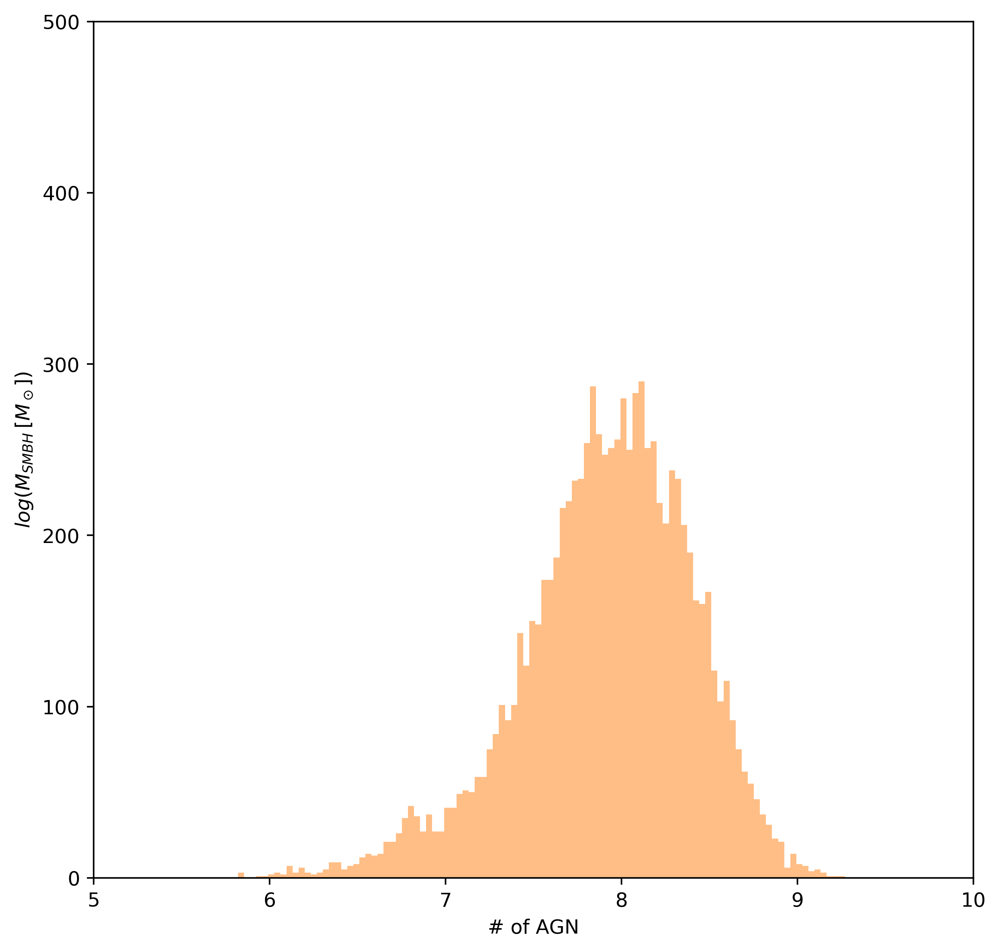

In [112]:

fig=plt.figure(1, figsize=(8,8), dpi=400)
plt.scatter(np.log10(Luminosity_bolo_all_f5100_cut_cont),np.log10(Luminosity_bolo_all_cut_cont), s=0.1)
plt.plot([43,46],[43,46],'k--')
plt.xlim([43,46])
plt.ylim([43,46])
plt.xlabel(r'$log(L_{bolo} \:[erg\:s^{-1}])$ from $L_{5100}$')
plt.ylabel(r'$log(L_{bolo} \:[erg\:s^{-1}])$ from $L_{B-band}$')
fig.savefig('Comparing_Bolometric_Luminosities.png')

fig=plt.figure(1, figsize=(8,8), dpi=400)
plt.hist(np.log10(R_edd_all_cut_cont),bins=100, alpha=0.5)
plt.plot([43,46],[43,46],'k--')
plt.xlim([-3.0,0.25])
plt.ylim([0,400])
plt.xlabel(r'# of AGN')
plt.ylabel(r'$log(R_{Edd})$')
fig.savefig('Eddington_Ratio_Histogram.png')

fig=plt.figure(1, figsize=(8,8), dpi=400)
plt.hist(np.log10(M_BH_5100_all_cut_cont),bins=100, alpha=0.5, color='C1')
plt.xlim([5.0,10.0])
plt.ylim([0,500])
plt.xlabel(r'# of AGN')
plt.ylabel(r'$log(M_{SMBH} \:[M_\odot])$')
fig.savefig('M_SMBH_Histogram.png')


###############################################################################################################################################################################################################################

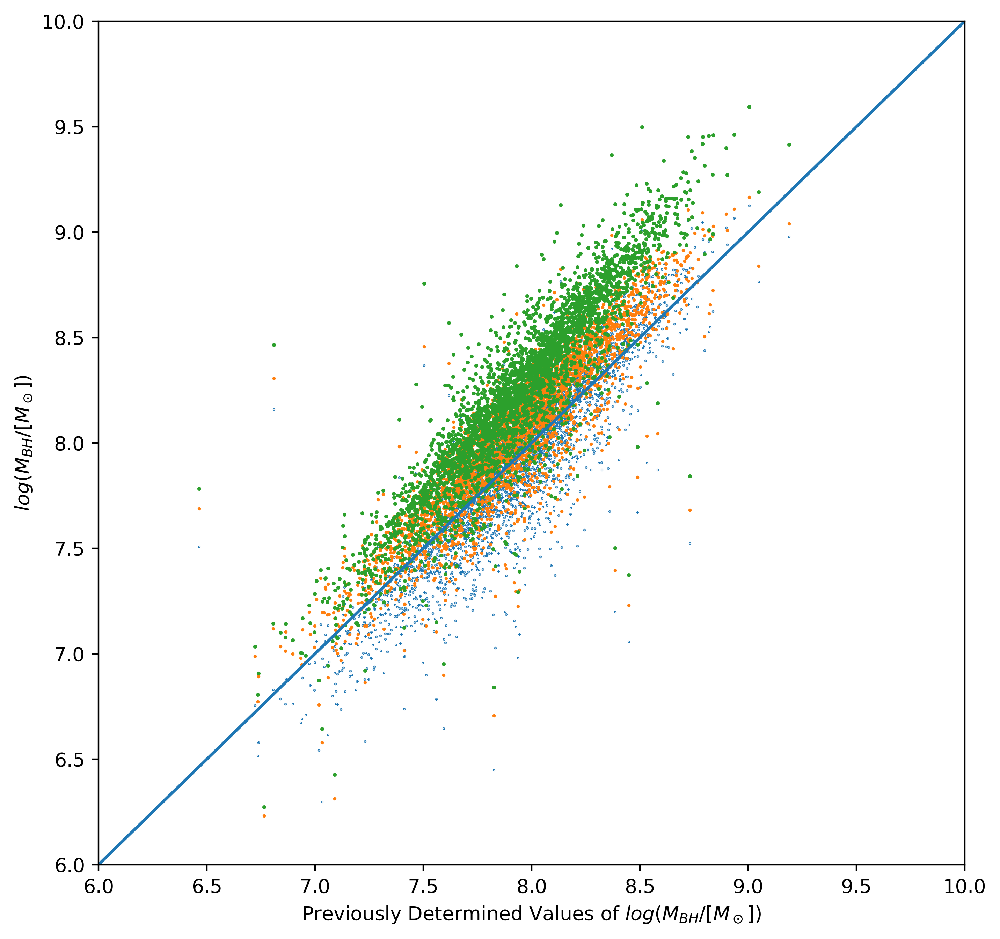

In [116]:
fig = plt.figure(1,figsize=(8,8),dpi=400)
plt.scatter(log_mass_park2014[z_pass], log_mass_SMBH_match[z_pass],s=0.1)
plt.scatter(log_mass_park2014[z_pass], log_mass_SMBH_match_Park2015[z_pass],s=0.5)
plt.scatter(log_mass_park2014[z_pass], log_mass_SMBH_match_Park2015_uncor[z_pass],s=1.0)
plt.plot([0,10],[0,10])
plt.xlim([6,10])
plt.ylim([6,10])
plt.xlabel(r'Previously Determined Values of $log(M_{BH}/[M_\odot])$')
plt.ylabel(r'$log(M_{BH}/[M_\odot])$')
fig.savefig('Comparing_SMBH_logM_BH.png')

################################################################################################################################################################################################################################

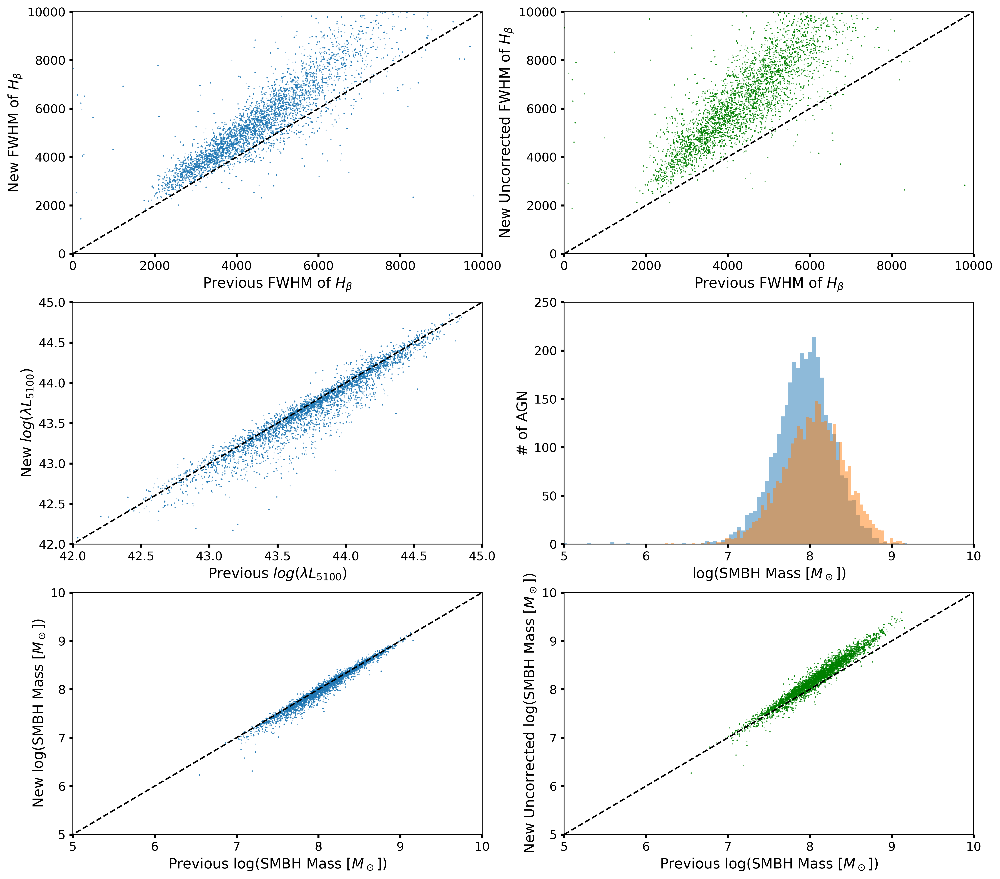

In [229]:
#last_trim = np.where(fwhm_kms_all_cut_cont >= 1500.0)

fig, ax = plt.subplots(3,2,figsize=(16,15),dpi=400)
ax[0,0].plot([0,10000],[0,10000], 'k--')
ax[0,0].scatter(fwhm_kms_full[z_pass], fwhm_kms_set1_match[z_pass], c='C0', marker='o', s=0.10)
ax[0,0].set_xlim([0,10000])
ax[0,0].set_ylim([0,10000])
ax[0,0].xaxis.set_tick_params(labelsize=12, width=2)
ax[0,0].yaxis.set_tick_params(labelsize=12, width=2)
ax[0,0].set_ylabel(r'New FWHM of $H_\beta$', fontsize=14)
ax[0,0].set_xlabel(r'Previous FWHM of $H_\beta$', fontsize=14)

ax[0,1].plot([0,10000],[0,10000], 'k--')
ax[0,1].scatter(fwhm_kms_full[z_pass], fwhm_kms_set1_match_uncor[z_pass], c='green', marker='o', s=0.10)
ax[0,1].set_xlim([0,10000])
ax[0,1].set_ylim([0,10000])
ax[0,1].xaxis.set_tick_params(labelsize=12, width=2)
ax[0,1].yaxis.set_tick_params(labelsize=12, width=2)
ax[0,1].set_ylabel(r'New Uncorrected FWHM of $H_\beta$', fontsize=14)
ax[0,1].set_xlabel(r'Previous FWHM of $H_\beta$', fontsize=14)

ax[1,0].plot([0,10000],[0,10000], 'k--')
ax[1,0].scatter(log_l5100_full[z_pass], log_l5100_set1_match[z_pass], c='C0', marker='o', s=0.10)
ax[1,0].set_xlim([42,45])
ax[1,0].set_ylim([42,45])
ax[1,0].xaxis.set_tick_params(labelsize=12, width=2)
ax[1,0].yaxis.set_tick_params(labelsize=12, width=2)
ax[1,0].set_ylabel(r'New $log(\lambda L_{5100})$', fontsize=14)
ax[1,0].set_xlabel(r'Previous $log(\lambda L_{5100})$', fontsize=14)

ax[1,1].hist(log_mass_park2014[z_pass][np.where(log_mass_park2014[z_pass] < 10.0)], bins=100, color='C0', alpha=0.5)
ax[1,1].hist(log_mass_SMBH_match_Park2015[z_pass], bins=80, color='C1', alpha=0.5)
ax[1,1].set_xlim([5,10])
ax[1,1].set_ylim([0,250])
ax[1,1].xaxis.set_tick_params(labelsize=12, width=2)
ax[1,1].yaxis.set_tick_params(labelsize=12, width=2)
ax[1,1].set_xlabel(r'log(SMBH Mass [$M_\odot$])', fontsize=14)
ax[1,1].set_ylabel(r'# of AGN', fontsize=14)

ax[2,0].plot([0,10000],[0,10000], 'k--')
ax[2,0].scatter(log_M_BH_match_test[z_pass], log_mass_SMBH_match_Park2015[z_pass], c='C0', marker='o', s=0.10)
ax[2,0].set_xlim([5,10])
ax[2,0].set_ylim([5,10])
ax[2,0].xaxis.set_tick_params(labelsize=12, width=2)
ax[2,0].yaxis.set_tick_params(labelsize=12, width=2)
ax[2,0].set_ylabel(r'New log(SMBH Mass [$M_\odot$])', fontsize=14)
ax[2,0].set_xlabel(r'Previous log(SMBH Mass [$M_\odot$])', fontsize=14)

ax[2,1].plot([0,10000],[0,10000], 'k--')
ax[2,1].scatter(log_M_BH_match_test[z_pass], log_mass_SMBH_match_Park2015_uncor[z_pass], c='green', marker='o', s=0.10)
ax[2,1].set_xlim([5,10])
ax[2,1].set_ylim([5,10])
ax[2,1].xaxis.set_tick_params(labelsize=12, width=2)
ax[2,1].yaxis.set_tick_params(labelsize=12, width=2)
ax[2,1].set_ylabel(r'New Uncorrected log(SMBH Mass [$M_\odot$])', fontsize=14)
ax[2,1].set_xlabel(r'Previous log(SMBH Mass [$M_\odot$])', fontsize=14)

fig.savefig('Comparing_M_BH_L51000_FWHM_HB.png') 

[   0    1    2 ... 9010 9012 9013]


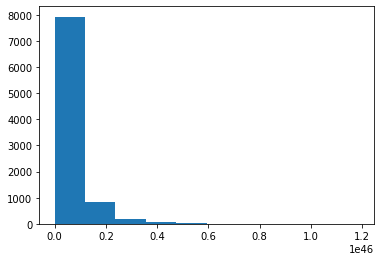

In [232]:
#plt.hist(Luminosity_bolo_all_f5100_cut_cont)
#print(last_trim[0])

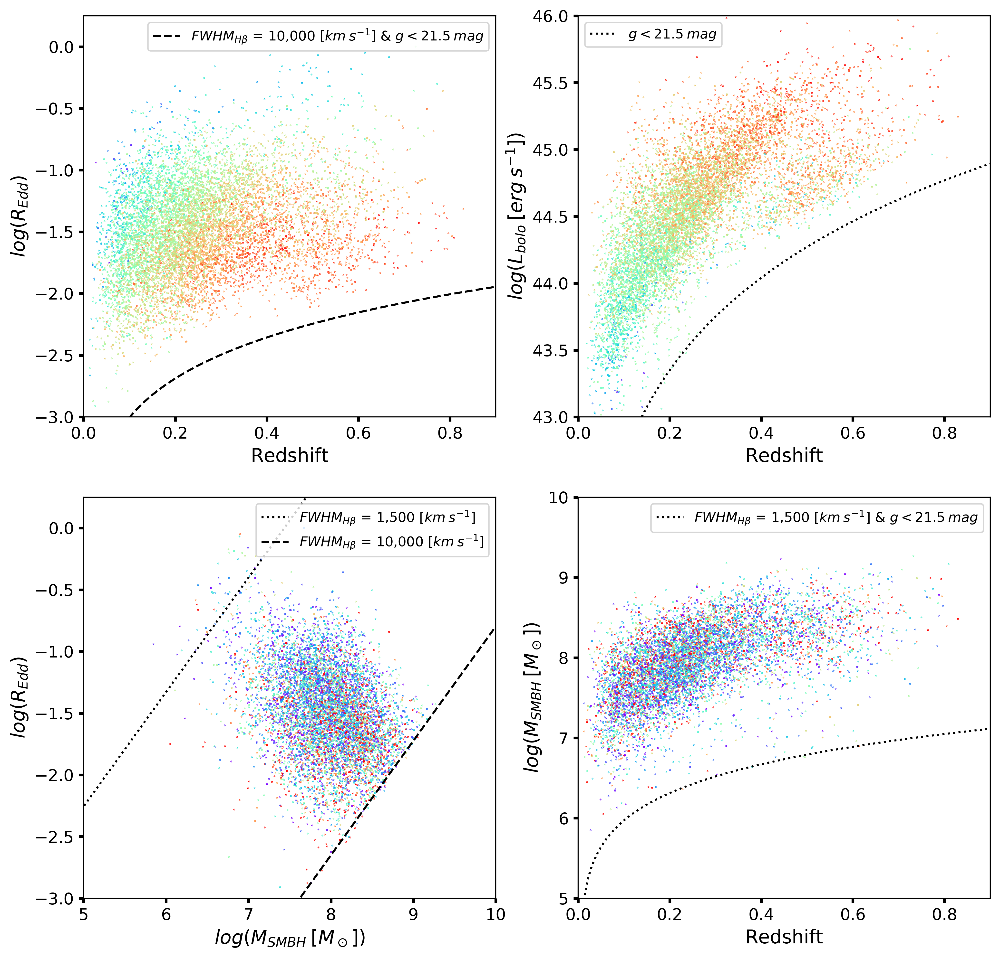

In [301]:
var_g_trimmed = amp_g_all
var_r_trimmed = amp_r_all
var_i_trimmed = amp_i_all
#print(var_g_trimmed, var_r_trimmed, var_i_trimmed)
shade_g = np.log10(M_BH_5100_all_cut_cont)

fig, ax = plt.subplots(2,2,figsize=(12,12),dpi=400)
ax[0,0].scatter(redshift_all_cut_cont, np.log10(R_edd_all_cut_cont), c=shade_g, vmin=6, vmax=9, cmap='rainbow', marker='o', s=0.10)
ax[0,0].plot(redshift_sim, log_r_edd_bound_sim, 'k--', label=r'$FWHM_{H\beta}$ = 10,000 $[km\:s^{-1}]$ & $g<21.5 \: mag$')
ax[0,0].legend()
ax[0,0].set_ylim([-3.0,0.25])
ax[0,0].set_xlim([0,0.9])
ax[0,0].xaxis.set_tick_params(labelsize=12, width=2)
ax[0,0].yaxis.set_tick_params(labelsize=12, width=2)
ax[0,0].set_xlabel(r'Redshift', fontsize=14)
ax[0,0].set_ylabel(r'$log(R_{Edd})$', fontsize=14)

ax[0,1].scatter(redshift_all_cut_cont, np.log10(Luminosity_bolo_all_cut_cont),c=shade_g, vmin=6, vmax=9, cmap='rainbow', marker='o', s=0.10)
ax[0,1].plot(redshift_sim, log_l_bolo_sim, 'k:', label=r'$g<21.5 \: mag$')
ax[0,1].legend()
ax[0,1].set_ylim([43,46])
ax[0,1].set_xlim([0,0.9])
ax[0,1].xaxis.set_tick_params(labelsize=12, width=2)
ax[0,1].yaxis.set_tick_params(labelsize=12, width=2)
ax[0,1].set_xlabel(r'Redshift', fontsize=14)
ax[0,1].set_ylabel(r'$log(L_{bolo} \: [erg\:s^{-1}])$', fontsize=14)

ax[1,0].scatter(np.log10(M_BH_5100_all_cut_cont), np.log10(R_edd_all_cut_cont), c=np.absolute(var_g_trimmed), vmin=0.05, vmax=0.7, cmap='rainbow', marker='o', s=0.10)
ax[1,0].plot(log_m_bh1500_sim, np.log10(r_edd1500_sim), 'k:', label=r'$FWHM_{H\beta}$ = 1,500 $[km\:s^{-1}]$')
ax[1,0].plot(log_m_bh10000_sim, np.log10(r_edd10000_sim), 'k--', label=r'$FWHM_{H\beta}$ = 10,000 $[km\:s^{-1}]$')
ax[1,0].legend()
ax[1,0].set_ylim([-3.0,0.25])
ax[1,0].set_xlim([5,10])
ax[1,0].xaxis.set_tick_params(labelsize=12, width=2)
ax[1,0].yaxis.set_tick_params(labelsize=12, width=2)
ax[1,0].set_xlabel(r'$log(M_{SMBH} \: [M_\odot])$', fontsize=14)
ax[1,0].set_ylabel(r'$log(R_{Edd})$', fontsize=14)

ax[1,1].scatter(redshift_all_cut_cont, np.log10(M_BH_5100_all_cut_cont), c=np.absolute(var_g_trimmed), vmin=0.05, vmax=0.7, cmap='rainbow', marker='o', s=0.10)
ax[1,1].plot(redshift_sim,log_M_BH1500_sim, 'k:', label=r'$FWHM_{H\beta}$ = 1,500 $[km\:s^{-1}]$ & $g<21.5 \: mag$')
ax[1,1].legend()
ax[1,1].set_ylim([5,10.0])
ax[1,1].set_xlim([0,0.9])
ax[1,1].xaxis.set_tick_params(labelsize=12, width=2)
ax[1,1].yaxis.set_tick_params(labelsize=12, width=2)
ax[1,1].set_xlabel(r'Redshift', fontsize=14)
ax[1,1].set_ylabel(r'$log(M_{SMBH} \: [M_\odot])$', fontsize=14)

fig.savefig('Comparing_MBH_REdd_Redshift_Lbol_trimmed.png') 


[[0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]]


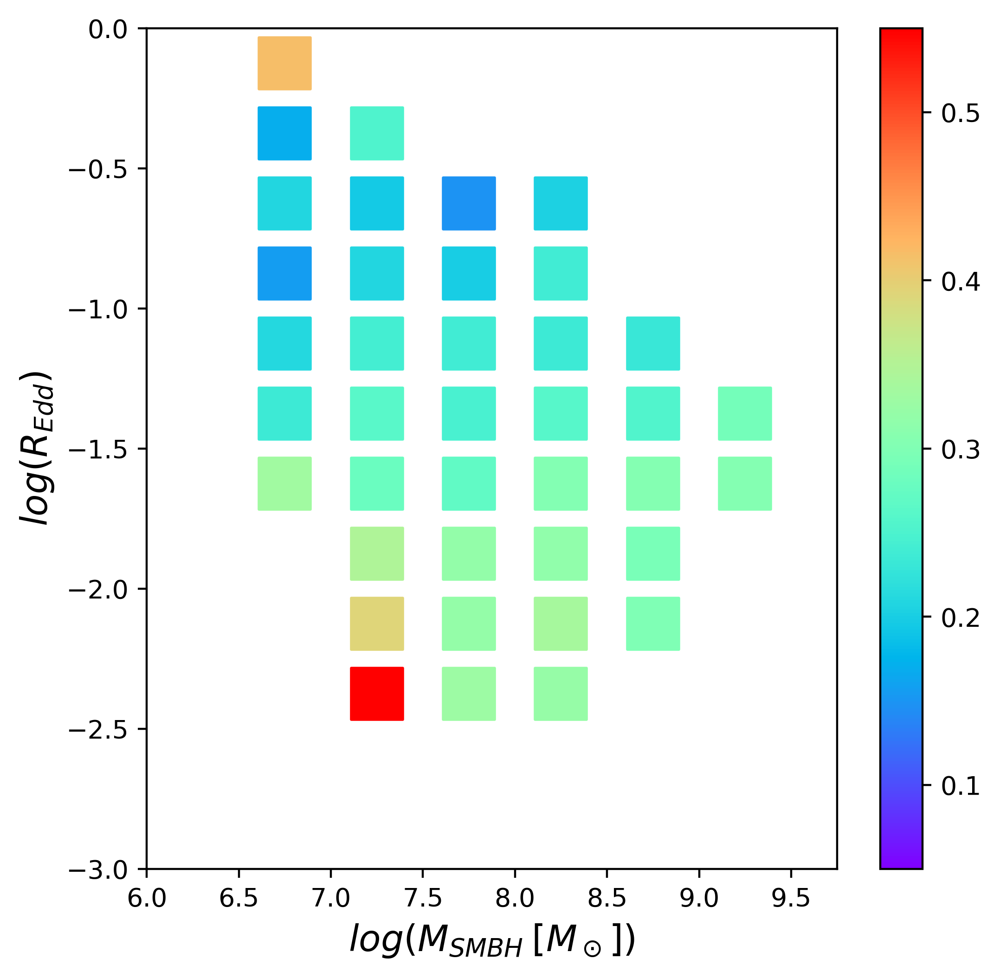

In [295]:
logR_Edd_trimmed  = np.log10(R_edd_all_cut_cont)
logl_bolo_trimmed = np.log10(Luminosity_bolo_all_cut_cont)
logM_BH_trimmed   = np.log10(M_BH_5100_all_cut_cont)

M_BH_bins     = np.linspace(6,9.5,8)
log1pz_bins   = np.linspace(np.log10(1.0),np.log10(1.0+0.8),8)
logL_bol_bins = np.linspace(43,46,8)
logR_Edd_bins = np.linspace(-3.0, 0.0, 13)

M_BH_mid_bins     = M_BH_bins[0:len(M_BH_bins)-1] + np.average(0.5*np.diff(M_BH_bins))
log1pz_mid_bins   = log1pz_bins[0:len(log1pz_bins)-1] + np.average(0.5*np.diff(log1pz_bins))
logL_bol_mid_bins = logL_bol_bins[0:len(logL_bol_bins)-1] + np.average(0.5*np.diff(logL_bol_bins))
logR_Edd_mid_bins = logR_Edd_bins[0:len(logR_Edd_bins)-1] + np.average(0.5*np.diff(logR_Edd_bins))

var_g_Lbolo_log1pz_slice = np.zeros((len(log1pz_mid_bins), len(logL_bol_mid_bins)))
var_r_Lbolo_log1pz_slice = np.zeros((len(log1pz_mid_bins), len(logL_bol_mid_bins)))
var_i_Lbolo_log1pz_slice = np.zeros((len(log1pz_mid_bins), len(logL_bol_mid_bins)))

var_g_Lbolo_R_Edd_slice  = np.zeros((len(logR_Edd_mid_bins), len(logL_bol_mid_bins)))
var_r_Lbolo_R_Edd_slice  = np.zeros((len(logR_Edd_mid_bins), len(logL_bol_mid_bins)))
var_i_Lbolo_R_Edd_slice  = np.zeros((len(logR_Edd_mid_bins), len(logL_bol_mid_bins)))

var_g_Lbolo_R_Edd_list = []
var_r_Lbolo_R_Edd_list = []
var_i_Lbolo_R_Edd_list = []
logR_Edd_list  =[]
logl_bolo_list =[]
logM_BH_list   =[]
group_member   = []
for i in range(0,len(logR_Edd_mid_bins)):
    for j in range(0, len(M_BH_mid_bins)):
        bin_ok = np.where((logR_Edd_trimmed > logR_Edd_bins[i]) & (logR_Edd_trimmed <= logR_Edd_bins[i+1]) & (np.log10(M_BH_5100_all_cut_cont) > M_BH_bins[j]) & (np.log10(M_BH_5100_all_cut_cont) <= M_BH_bins[j+1]))
        
        if (len(bin_ok[0]) >= 10):
            group_member.append(len(bin_ok[0]))
            logR_Edd_list.append(logR_Edd_mid_bins[i])
            logl_bolo_list.append(logL_bol_mid_bins[j])
            logM_BH_list.append(M_BH_mid_bins[j])
            var_g_Lbolo_R_Edd_list.append(np.nanmedian(var_g_trimmed[bin_ok]))
            var_r_Lbolo_R_Edd_list.append(np.nanmedian(var_r_trimmed[bin_ok]))
            var_i_Lbolo_R_Edd_list.append(np.nanmedian(var_i_trimmed[bin_ok]))

print(var_g_Lbolo_R_Edd_slice)

fig, ax = plt.subplots(figsize=(6,6),dpi=400)
plt.scatter(logM_BH_list, logR_Edd_list, c=var_g_Lbolo_R_Edd_list, vmin=0.05, vmax=0.55, cmap='rainbow', s=400, marker='s')      
plt.ylim([-3.0,0.0])
plt.xlim([6,9.75])
plt.ylabel(r'$log(R_{Edd})$', fontsize=14)
plt.xlabel(r'$log(M_{SMBH} \: [M_\odot])$', fontsize=14)
plt.colorbar()
fig.savefig('Comparing_MBH_REdd_Redshift_variability_amplitude_cbar.png') 
       


In [240]:
print(len(var_g_all), len(R_edd_all_cut_cont))

8689 9014


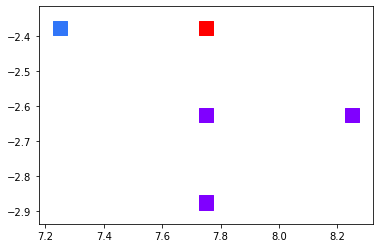

In [237]:
plt.scatter(logM_BH_list, logR_Edd_list, c=group_member, cmap='rainbow', s=200, marker='s')


In [122]:
i,j=1,1
bin_ok = np.where((logR_Edd_trimmed > logR_Edd_bins[i]) & (logR_Edd_trimmed <= logR_Edd_bins[i+1]) & (logl_bolo_trimmed > logL_bol_bins[j]) & (logl_bolo_trimmed <= logL_bol_bins[j+1]))
var_g_Lbolo_R_Edd_slice_test = np.average(var_g_trimmed[bin_ok])

print(var_g_trimmed[bin_ok], var_g_Lbolo_R_Edd_slice_test)
    
   

NameError: name 'var_g_trimmed' is not defined

In [123]:
np.diff(M_BH_bins)


array([0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5])

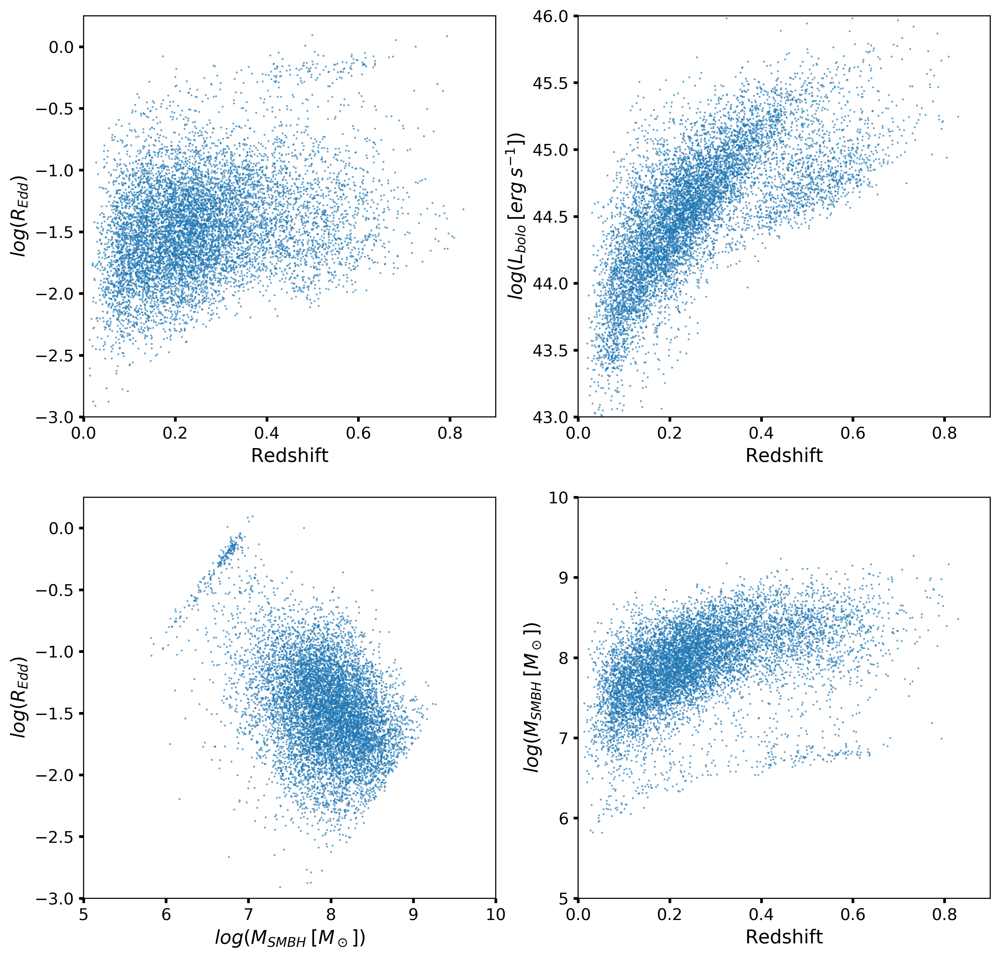

In [124]:

fig, ax = plt.subplots(2,2,figsize=(12,12),dpi=400)
ax[0,0].scatter(redshift_all_cut_cont, np.log10(R_edd_all_cut_cont), c='C0', marker='o', s=0.10)
ax[0,0].set_ylim([-3.0,0.25])
ax[0,0].set_xlim([0,0.9])
ax[0,0].xaxis.set_tick_params(labelsize=12, width=2)
ax[0,0].yaxis.set_tick_params(labelsize=12, width=2)
ax[0,0].set_xlabel(r'Redshift', fontsize=14)
ax[0,0].set_ylabel(r'$log(R_{Edd})$', fontsize=14)

ax[0,1].scatter(redshift_all_cut_cont, np.log10(Luminosity_bolo_all_cut_cont), c='C0', marker='o', s=0.10)
ax[0,1].set_ylim([43,46])
ax[0,1].set_xlim([0,0.9])
ax[0,1].xaxis.set_tick_params(labelsize=12, width=2)
ax[0,1].yaxis.set_tick_params(labelsize=12, width=2)
ax[0,1].set_xlabel(r'Redshift', fontsize=14)
ax[0,1].set_ylabel(r'$log(L_{bolo} \: [erg\:s^{-1}])$', fontsize=14)

ax[1,0].scatter(np.log10(M_BH_5100_all_cut_cont), np.log10(R_edd_all_cut_cont), c='C0', marker='o', s=0.10)
ax[1,0].set_ylim([-3.0,0.25])
ax[1,0].set_xlim([5,10])
ax[1,0].xaxis.set_tick_params(labelsize=12, width=2)
ax[1,0].yaxis.set_tick_params(labelsize=12, width=2)
ax[1,0].set_xlabel(r'$log(M_{SMBH} \: [M_\odot])$', fontsize=14)
ax[1,0].set_ylabel(r'$log(R_{Edd})$', fontsize=14)

ax[1,1].scatter(redshift_all_cut_cont, np.log10(M_BH_5100_all_cut_cont), c='C0', marker='o', s=0.10)
ax[1,1].set_ylim([5,10.0])
ax[1,1].set_xlim([0,0.9])
ax[1,1].xaxis.set_tick_params(labelsize=12, width=2)
ax[1,1].yaxis.set_tick_params(labelsize=12, width=2)
ax[1,1].set_xlabel(r'Redshift', fontsize=14)
ax[1,1].set_ylabel(r'$log(M_{SMBH} \: [M_\odot])$', fontsize=14)

fig.savefig('Comparing_MBH_REdd_Redshift_Lbol_test.png') 
